<a href="https://colab.research.google.com/github/xiong416/AI_CV_improver/blob/main/Machine_Learning_using_R_programming_(Section_1_to_6).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Introduction to Machine Learning**



After completing this section, you will be able to:

- Explain the difference between the outcome and the features.
- Explain when to use classification and when to use prediction.
- Explain the importance of prevalence.
- Explain the difference between sensitivity and specificity.

In machine learning applications, data comes in the form of the outcome, what we want to predict, and the features that will be used to predict the outcome.
We want to build an algorithm that takes feature values as input and returns a prediction for the outcome when we don't know the outcome.The machine learning approach is to train an algorithm using data sets for which we do know the outcome and then apply this algorithm in the future to make predictions
when we don't know the outcome.

In this course, we will use capital Y to denote the outcomes and capital X with an index X1 through Xp to denote the features.Note that features are sometimes referred to as predictors or covariates.

Prediction problems can be divided into those with (1) categorical outcomes
(2) continuous outcomes.
For categorical outcomes, Y can be any of k classes. The number of classes can vary greatly across applications.For example, with digit readers, K is 10.
The classes being the digits 0, 1, 2, 3, all the way up to 9.
In speech recognition, the outcomes are all possible words are all possible phrases we're trying to detect.
Spam detection has two outcomes, spam or not spam. In this course, we denote the k categories with indices. Little k equals 1 or 2, 3, all the way up
to capital K, which is the number of classes.

However, for binary data, we will use k equals 0 or 1 for mathematical convenience.

The general setup is as follows.
We have a series of features and an unknown outcome we want to predict.
To build a model that provides a prediction for any set of observable values x1 through x5, we collect data for which we know the outcome. When the output is continuous, we refer to the machine learning task as prediction.
And the main output of the model is a function f that automatically produces a prediction denoted with y hat also for any set of predictors x1 through xp.
We use the term actual outcome to denote what we end up observing.
So we want the prediction y hat to match the actual outcome y as close
as possible.

Because our outcome is continuous, our prediction y hat
will not be either exactly right or wrong, but instead we'll determine an error defined as the difference between the prediction and the actual outcome.

When the outcome is categorical, we refer to the machine learning task as classification. And the main output of the model will be a decision rule
which prescribes which of the k classes we should predict.
In this scenario, most models provide a function of the predictors for each class. These are used to make the decision.

When the data is binary, a typical decision rule looks like this.
If f1 of x1 through xp is bigger than some constant, some pre-defined constant C, we predict category 1. And if it's less than C, then we predict category 0.
Because the outcomes are categorical, our predictions will be either right or wrong.
Notice that these terms vary among courses, textbooks, and other publications.
Often prediction is used for both categorical and continuous outcomes
and the term regression is sometimes used for the continuous case.
Here we avoid using regression to avoid confusion with our previous use of the term linear regression. In most cases, it will be clear if our outcomes are categorical or continuous.
So we will avoid using these terms when possible.

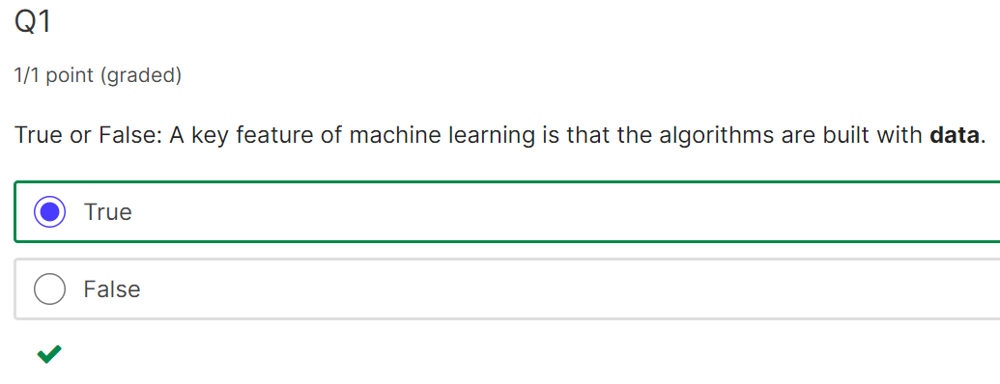

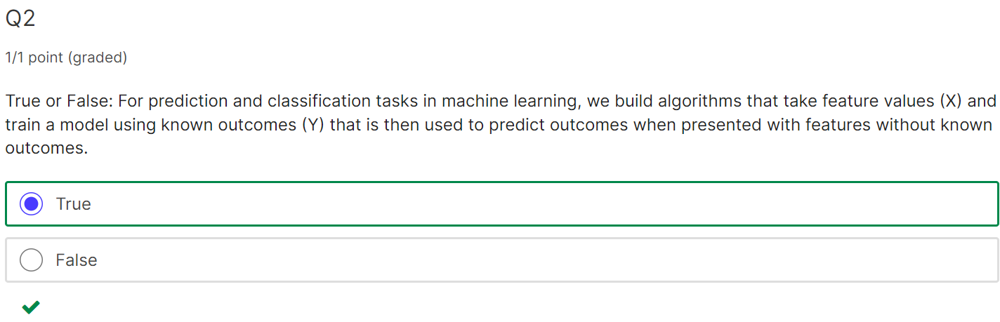


# **Section 2: Machine Learning Basics Overview**


After completing this section, you will be able to:

- Start to use the caret package.
- Construct and interpret a confusion matrix.
- Use conditional probabilities in the context of machine learning.

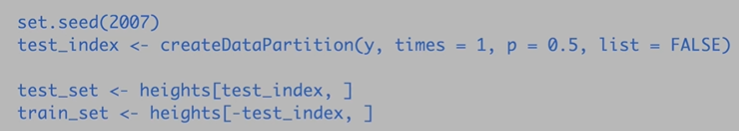


times is used to define how many random samples of indices

Argument, p, is used to define what proportion of the data is represented by the index.

Argument, list, is used to decide if we want the indices to return as a list or not.

Overall accuracy = overall proportion that is predictly correctly. Based on codes below, the accuracy is about 51.6%.

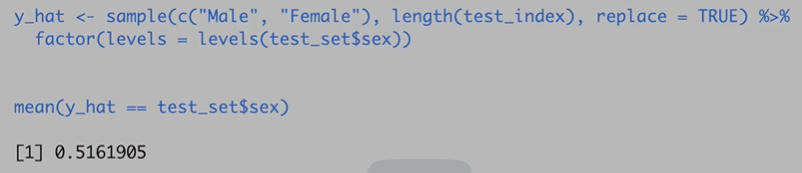

Exploratory Data Analysis (EDA) suggests that on average, males are slightly taller than females.

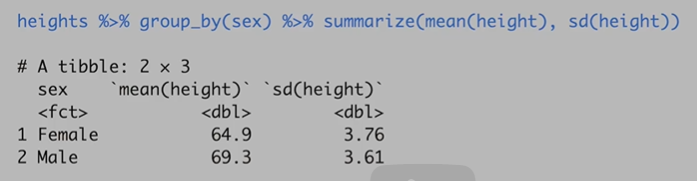

Predict male if height is within two standard deviations from the average male height. So if height is bigger than 62, we will predict male, otherwise female.

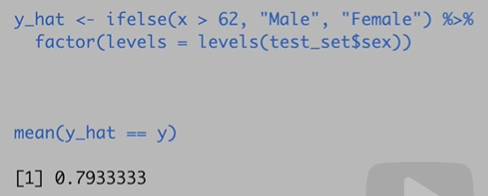

The accuracy goes up from 0.5 with our previous guessing algorithm
to about 80%.

Accuracy can be better by examining the accuracy of 62 (or cutoff). We can optimise the cutoff using only the training set. The test set is only for evaluation.

We will optimize our approach by examining the accuracy of 10 different cutoffs and picking the one yielding the best result. Codes as below:-

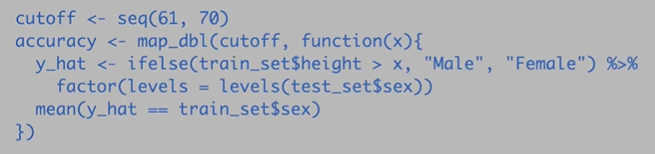

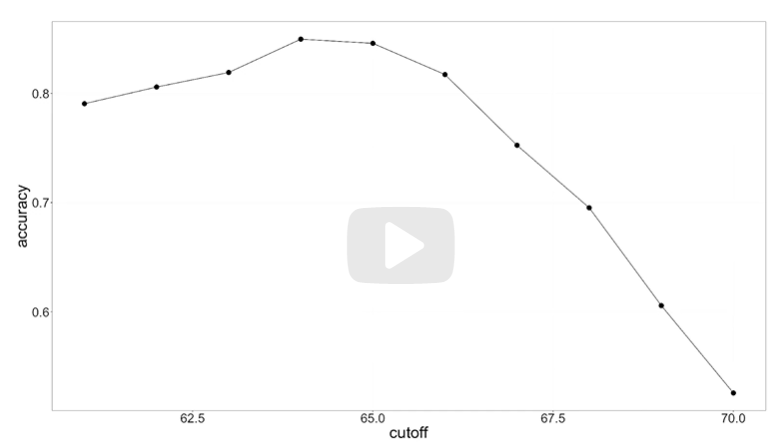



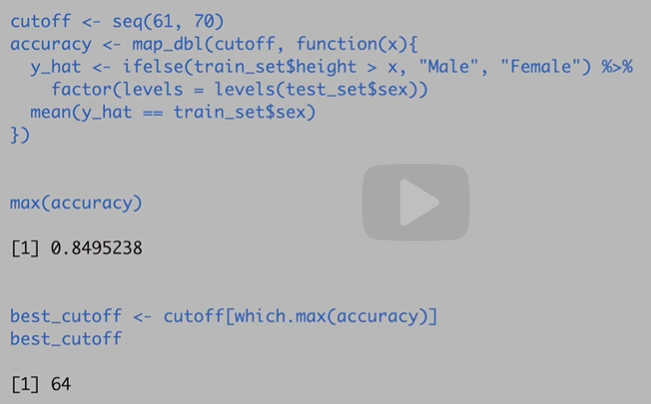

To use in test set:

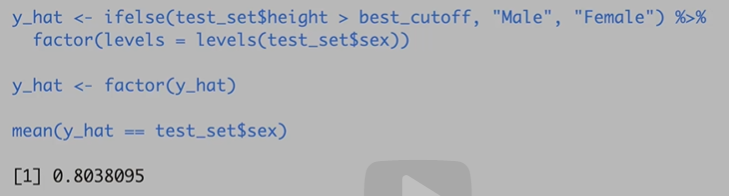

Insight: This results is overtraining.


In [ ]:
install.packages("caret", dependencies=T)

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘R.methodsS3’, ‘R.oo’, ‘R.utils’, ‘bitops’, ‘httpuv’, ‘xtable’, ‘sourcetools’, ‘later’, ‘promises’, ‘R.cache’, ‘caTools’, ‘TH.data’, ‘profileModel’, ‘minqa’, ‘nloptr’, ‘RcppEigen’, ‘lazyeval’, ‘plotrix’, ‘shiny’, ‘miniUI’, ‘styler’, ‘classInt’, ‘labelled’, ‘gplots’, ‘libcoin’, ‘matrixStats’, ‘multcomp’, ‘clock’, ‘hardhat’, ‘brglm’, ‘gtools’, ‘lme4’, ‘qvcalc’, ‘rex’, ‘Formula’, ‘plotmo’, ‘TeachingDemos’, ‘combinat’, ‘questionr’, ‘ROCR’, ‘mvtnorm’, ‘modeltools’, ‘strucchange’, ‘coin’, ‘zoo’, ‘sandwich’, ‘ISwR’, ‘corpcor’, ‘ROSE’, ‘ModelMetrics’, ‘recipes’, ‘BradleyTerry2’, ‘covr’, ‘Cubist’, ‘earth’, ‘ellipse’, ‘fastICA’, ‘gam’, ‘kernlab’, ‘klaR’, ‘mda’, ‘mlbench’, ‘MLmetrics’, ‘pamr’, ‘party’, ‘pls’, ‘randomForest’, ‘RANN’, ‘spls’, ‘subselect’, ‘superpc’, ‘themis’




In [ ]:
library(tidyverse)
library(caret)
library(dslabs)
data(heights)

# define the outcome and predictors
y <- heights$sex
x <- heights$height

# generate training and test sets
set.seed(2007)
test_index <- createDataPartition(y, times = 1, p = 0.5, list = FALSE)
test_set <- heights[test_index, ]
train_set <- heights[-test_index, ]

# guess the outcome
y_hat <- sample(c("Male", "Female"), length(test_index), replace = TRUE) %>%
  factor(levels = levels(test_set$sex))

# compute accuracy
mean(y_hat == test_set$sex)

# compare heights in males and females in our data set
heights %>% group_by(sex) %>% summarize(mean(height), sd(height))

# now try predicting "male" if the height is within 2 SD of the average male
y_hat <- ifelse(x > 62, "Male", "Female") %>% factor(levels = levels(test_set$sex))
mean(y == y_hat)

# examine the accuracy of 10 cutoffs
cutoff <- seq(61, 70)
accuracy <- map_dbl(cutoff, function(x){
  y_hat <- ifelse(train_set$height > x, "Male", "Female") %>%
    factor(levels = levels(test_set$sex))
  mean(y_hat == train_set$sex)
})
data.frame(cutoff, accuracy) %>%
  ggplot(aes(cutoff, accuracy)) +
  geom_point() +
  geom_line()
max(accuracy)

best_cutoff <- cutoff[which.max(accuracy)]
best_cutoff

y_hat <- ifelse(test_set$height > best_cutoff, "Male", "Female") %>%
  factor(levels = levels(test_set$sex))
y_hat <- factor(y_hat)
mean(y_hat == test_set$sex)

Loading required package: lattice


Attaching package: ‘caret’


The following object is masked from ‘package:purrr’:

    lift




ERROR: ignored

### **2.1: Basics of Evaluating Machine Learning Algorithms**

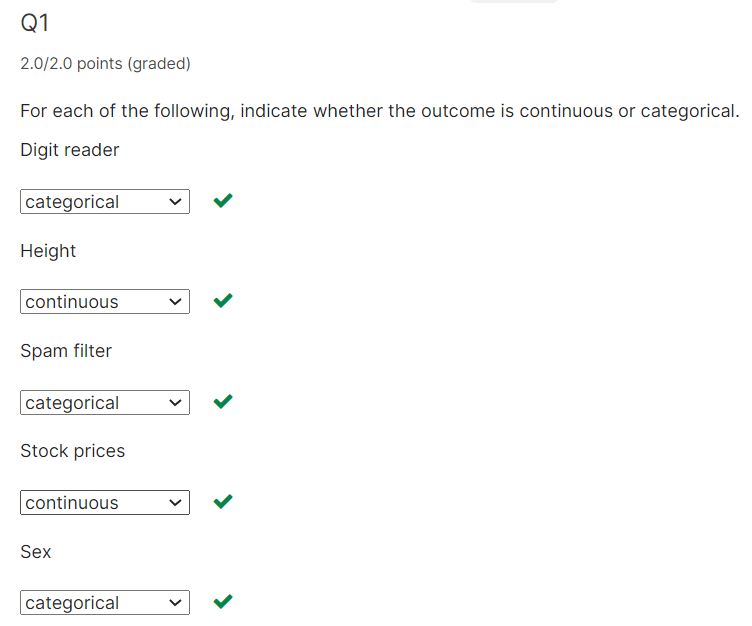

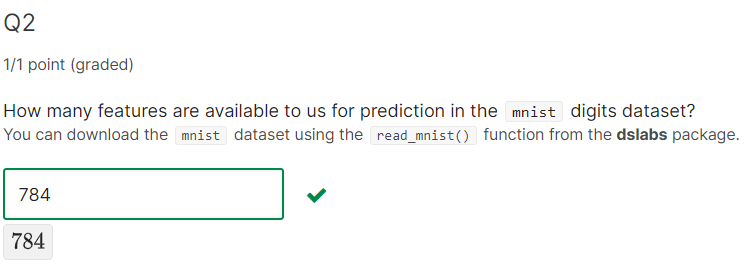

## **Confusion Matrix**

The prediction rule we developed in the previous video predicts male if the student is taller than 64 inches.

Given that the average female is about 64 inches, this prediction rule seems wrong.What happened?

If a student is the height of the average female, shouldn't we predict female?

Overall accuracy can be a deceptive measure.

We should build confusion matrix, which tabulates each combination of prediction and actual value.

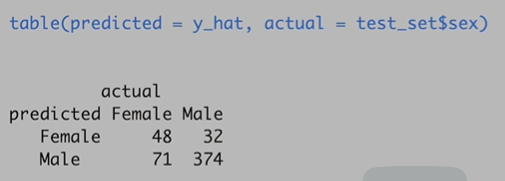

if compute the accuracy separately for each sex, will get the following results. There's imbalance in the accuracy for males & females.

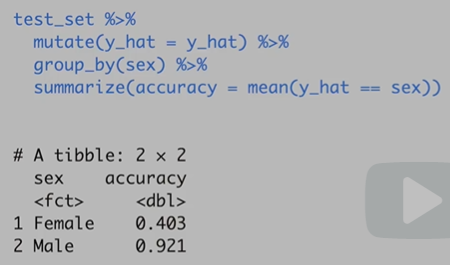

Too many females are predicted to be male.

So how can our overall accuracy be so high then? The reason is that these heights were collected from three data science courses, two of which had more males enrolled.

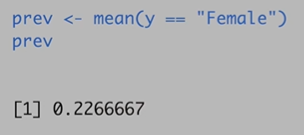

There's only 22% females in the aggregated data.
So when computing overall accuracy, the high percentage of mistakes made for females is outweighed by the gains in correct calls for males.

Think of an extreme example where 99% of the data are males. Then a strategy that always guesses males no matter what will obviously give us a high accuracy.

If your training data is biased in some way, you're likely to develop an algorithm that is biased as well.

a first step to discovering these types of problems is to look at metrics other than an overall accuracy when evaluating a machine learning algorithm.

There are several metrics that we can use to evaluate an algorithm in a way
that prevalence does not cloud our assessment. And these can all be derived from the confusion matrix.

A general improvement to using overall accuracy is to study sensitivity and specificity separately.

In [ ]:
# tabulate each combination of prediction and actual value
table(predicted = y_hat, actual = test_set$sex)
test_set %>%
  mutate(y_hat = y_hat) %>%
  group_by(sex) %>%
  summarize(accuracy = mean(y_hat == sex))
prev <- mean(y == "Male")

confusionMatrix(data = y_hat, reference = test_set$sex)

ERROR: ignored

## **Sensitivity, Specificity and Prevalence**

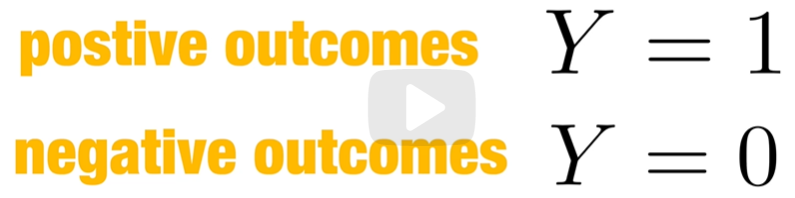

**Sensitivity** is defined as the ability of an algorithm to predict a positive outcome when the actual outcome is positive.


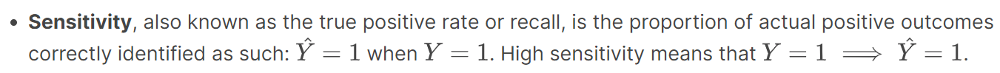

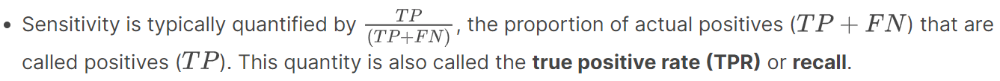



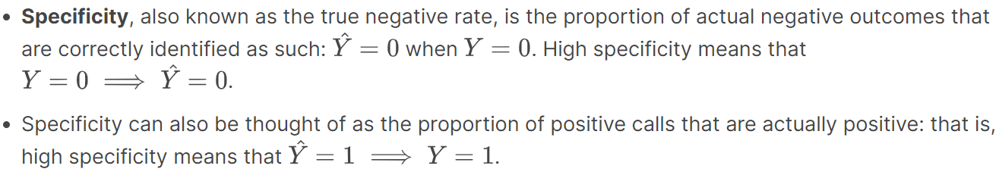


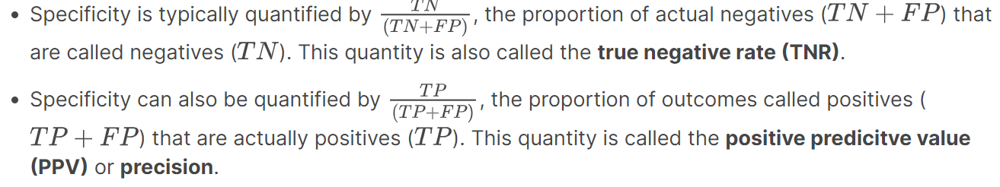

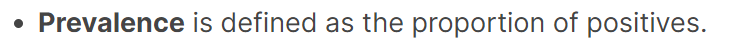

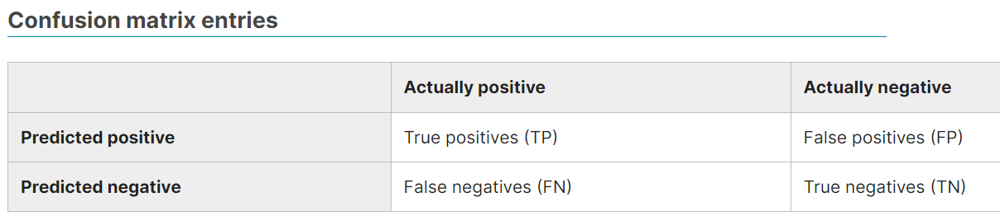


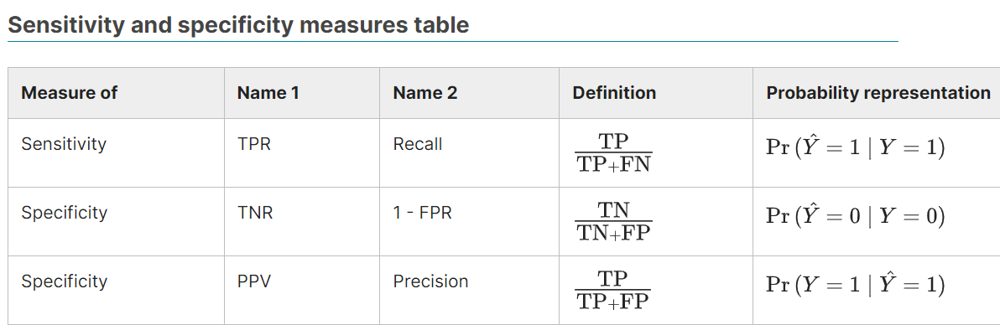

In [ ]:
# get the metrics
cm <- confusionMatrix(data = y_hat, reference = test_set$sex)

# access specific metrics
cm$overall["Accuracy"]

cm$byClass[c("Sensitivity","Specificity", "Prevalence")]

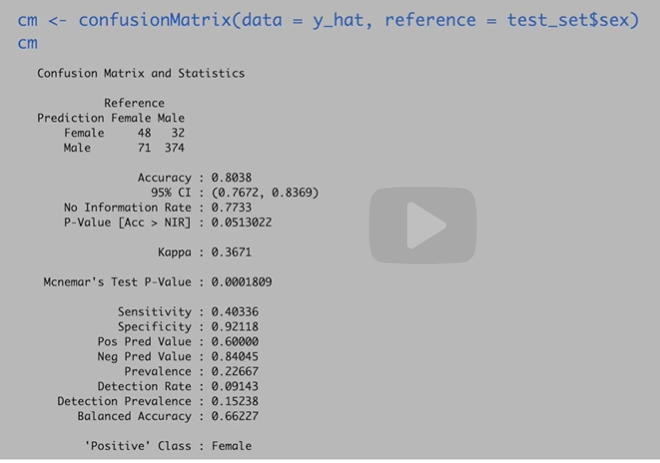

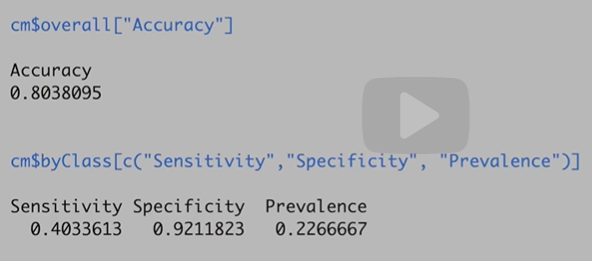

In our example, we can see that the high overall accuracy is possible despite relatively low sensitivity. The reason this happens is because of low prevalence of only 23%. The proportion of females is low.

Because prevalence is low, failing to predict actual females as females,
low sensitivity, does not lower the accuracy as much as failing to predict actual males as males, low specificity.

This is an example of why it is important to examine sensitivity and specificity and not just accuracy.
Before applying this algorithm to general data sets,
we need to ask ourselves if prevalence will be the same in new data sets out
in the wild.

## **Balanced accuracy and F1 Score**

For optimization purposes, sometimes it is more useful to have a one number summary than studying both specificity and sensitivity. One preferred metric is balanced accuracy. Because specificity and sensitivity are rates, it is more appropriate to compute the harmonic average. In fact, the F1-score, a widely used one-number summary, is the harmonic average of precision and recall.

Depending on the context, some type of errors are more costly than others. The F1-score can be adapted to weigh specificity and sensitivity differently.
You can compute the F1-score using the F_meas() function in the caret package.

In [ ]:
# maximize F-score
cutoff <- seq(61, 70)
F_1 <- map_dbl(cutoff, function(x){
  y_hat <- ifelse(train_set$height > x, "Male", "Female") %>%
    factor(levels = levels(test_set$sex))
  F_meas(data = y_hat, reference = factor(train_set$sex))
})

data.frame(cutoff, F_1) %>%
  ggplot(aes(cutoff, F_1)) +
  geom_point() +
  geom_line()

max(F_1)

best_cutoff_2 <- cutoff[which.max(F_1)]
best_cutoff_2

y_hat <- ifelse(test_set$height > best_cutoff_2, "Male", "Female") %>%
  factor(levels = levels(test_set$sex))
sensitivity(data = y_hat, reference = test_set$sex)
specificity(data = y_hat, reference = test_set$sex)

## **Prevalence matters in practice**



A machine learning algorithm with very high sensitivity and specificity may not be useful in practice when prevalence is close to either 0 or 1.

To see this, consider the case of a doctor that specializes in a rare disease and is interested in developing an algorithm for predicting who has the disease.
The doctor shares data with you and you then develop an algorithm with very high sensitivity.

You explain that this means that if a patient has a disease, the algorithm is very likely to predict correctly. But you also tell the doctor that you're also
concerned because based on the data set you analyzed, half of the patients
have the disease.

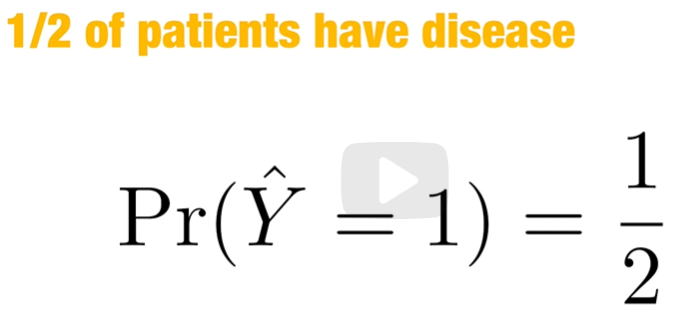

The doctor is neither concerned nor impressed and explains that what is important is the precision of the test.

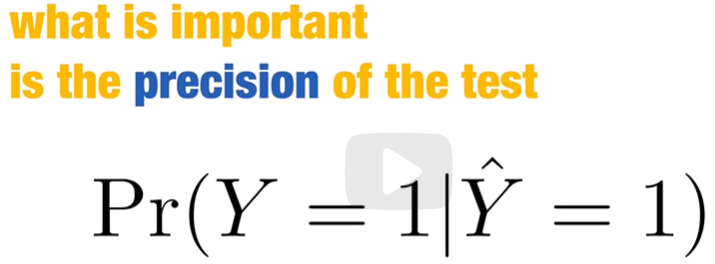

Using Bayes' theorem, we can connect the two measures. The doctor knows that the prevalence of the disease is 5 in 1,000, which implies that the ratio of the probability of y equals 1 divided by the probability of your prediction being 1 is 1 in 100.

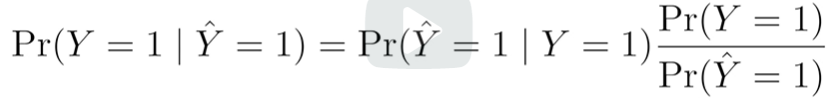

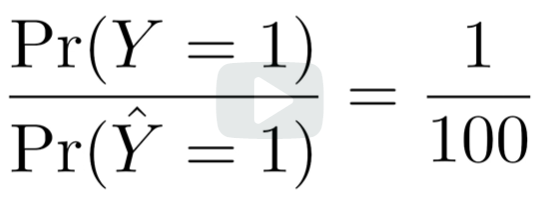

And therefore, the precision of your algorithm is less than 1%.
The doctor does not have much use for your algorithm.


 if you develop an algorithm for disease diagnosis with very high sensitivity, but the prevalence of the disease is pretty low, then the precision of your algorithm is probably very low based on Bayes' theorem.

## **Receiver Operating Characteristic (ROC) and precision-recall curves**

A very common approach to evaluating accuracy and F1-score is to compare them graphically by plotting both. A widely used plot that does this is the receiver operating characteristic (ROC) curve. The ROC curve plots sensitivity (TPR) versus 1 - specificity, also known as the false positive rate (FPR).

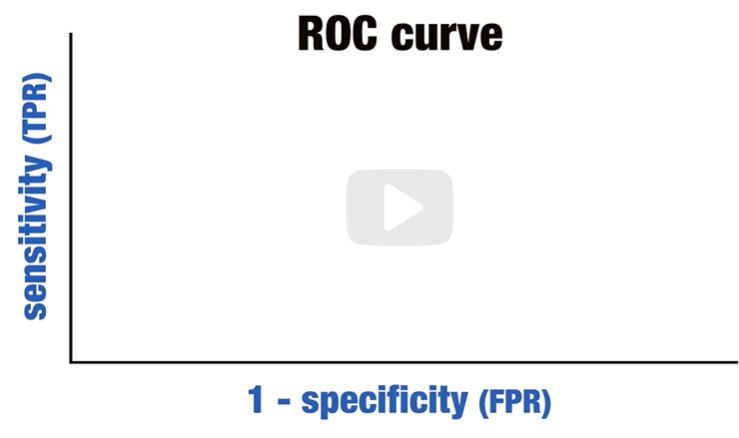

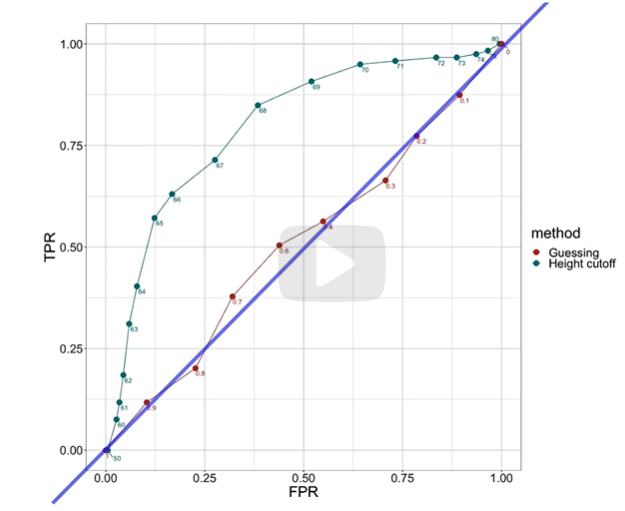

The packages pROC and plotROC are useful for generating these plots, but you can also make them yourself using ggplot.

ROC curves have one weakness, and it is that neither of the measures plotted depend on prevalence.

In cases in which prevalence matters, we may instead make a **precision-recall plot**.

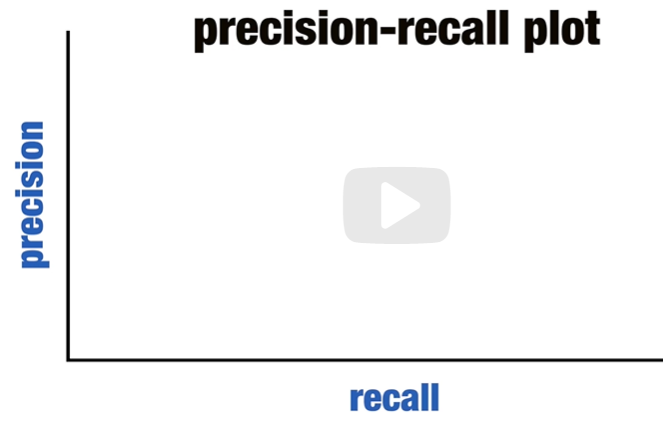

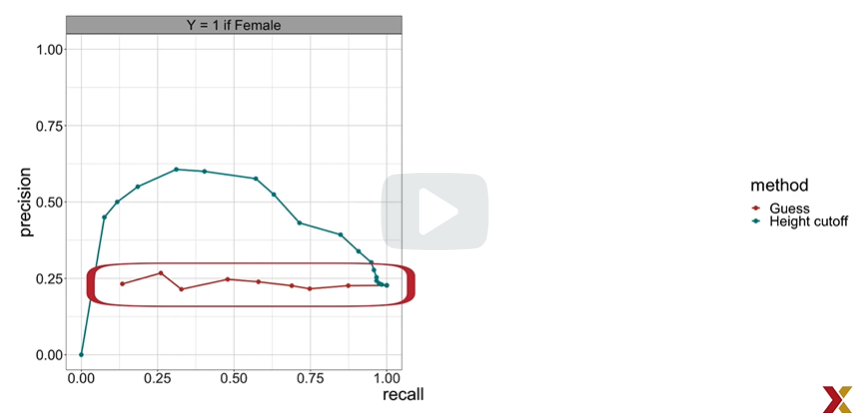


From this plot, we immediately see that the precision of guessing is not high.
This is because the prevalence is low.

In [ ]:
p <- 0.9
n <- length(test_index)
y_hat <- sample(c("Male", "Female"), n, replace = TRUE, prob=c(p, 1-p)) %>%
  factor(levels = levels(test_set$sex))
mean(y_hat == test_set$sex)

# ROC curve
probs <- seq(0, 1, length.out = 10)
guessing <- map_df(probs, function(p){
  y_hat <-
    sample(c("Male", "Female"), n, replace = TRUE, prob=c(p, 1-p)) %>%
    factor(levels = c("Female", "Male"))
  list(method = "Guessing",
       FPR = 1 - specificity(y_hat, test_set$sex),
       TPR = sensitivity(y_hat, test_set$sex))
})
guessing %>% qplot(FPR, TPR, data =., xlab = "1 - Specificity", ylab = "Sensitivity")

cutoffs <- c(50, seq(60, 75), 80)
height_cutoff <- map_df(cutoffs, function(x){
  y_hat <- ifelse(test_set$height > x, "Male", "Female") %>%
    factor(levels = c("Female", "Male"))
   list(method = "Height cutoff",
        FPR = 1-specificity(y_hat, test_set$sex),
        TPR = sensitivity(y_hat, test_set$sex))
})

# plot both curves together
bind_rows(guessing, height_cutoff) %>%
  ggplot(aes(FPR, TPR, color = method)) +
  geom_line() +
  geom_point() +
  xlab("1 - Specificity") +
  ylab("Sensitivity")

library(ggrepel)
map_df(cutoffs, function(x){
  y_hat <- ifelse(test_set$height > x, "Male", "Female") %>%
    factor(levels = c("Female", "Male"))
   list(method = "Height cutoff",
        cutoff = x,
        FPR = 1-specificity(y_hat, test_set$sex),
        TPR = sensitivity(y_hat, test_set$sex))
}) %>%
  ggplot(aes(FPR, TPR, label = cutoff)) +
  geom_line() +
  geom_point() +
  geom_text_repel(nudge_x = 0.01, nudge_y = -0.01)

# plot precision against recall
guessing <- map_df(probs, function(p){
  y_hat <- sample(c("Male", "Female"), length(test_index),
                  replace = TRUE, prob=c(p, 1-p)) %>%
    factor(levels = c("Female", "Male"))
  list(method = "Guess",
    recall = sensitivity(y_hat, test_set$sex),
    precision = precision(y_hat, test_set$sex))
})

height_cutoff <- map_df(cutoffs, function(x){
  y_hat <- ifelse(test_set$height > x, "Male", "Female") %>%
    factor(levels = c("Female", "Male"))
  list(method = "Height cutoff",
       recall = sensitivity(y_hat, test_set$sex),
    precision = precision(y_hat, test_set$sex))
})

bind_rows(guessing, height_cutoff) %>%
  ggplot(aes(recall, precision, color = method)) +
  geom_line() +
  geom_point()
guessing <- map_df(probs, function(p){
  y_hat <- sample(c("Male", "Female"), length(test_index), replace = TRUE,
                  prob=c(p, 1-p)) %>%
    factor(levels = c("Male", "Female"))
  list(method = "Guess",
    recall = sensitivity(y_hat, relevel(test_set$sex, "Male", "Female")),
    precision = precision(y_hat, relevel(test_set$sex, "Male", "Female")))
})

height_cutoff <- map_df(cutoffs, function(x){
  y_hat <- ifelse(test_set$height > x, "Male", "Female") %>%
    factor(levels = c("Male", "Female"))
  list(method = "Height cutoff",
       recall = sensitivity(y_hat, relevel(test_set$sex, "Male", "Female")),
    precision = precision(y_hat, relevel(test_set$sex, "Male", "Female")))
})
bind_rows(guessing, height_cutoff) %>%
  ggplot(aes(recall, precision, color = method)) +
  geom_line() +
  geom_point()

ERROR: ignored

## **Loss Function**

RAFAEL IRIZARRY: Up to now, we have described evaluation metrics that
apply exclusively to categorical data.
Specifically for binary outcomes, we have
described how sensitivity, specificity, accuracy,
and F1 can be used as quantification of how well the algorithm is working.
However, these metrics are not useful for continuous outcomes.



The most commonly used loss function is the squared loss function. a loss function which can be applied to both categorical and continuous data.

Because we often have a test set with many observations, say N, we use the mean squared error (MSE). In practice, we often report the root mean squared error (RMSE), which is the square root of MSE, because it is in the same units as the outcomes.

If the outcomes are binary, both RMSE and MSE are equivalent to one minus accuracy

Note that there are loss functions other than the squared loss. For example, the Mean Absolute Error uses absolute values instead of squaring the errors. However, we focus on minimizing square loss since it is the most widely used.

## **Comprehension Check: Practice with Machine Learning, Part 1**

The following questions all ask you to work with the dataset described below.

The reported_heights and heights datasets were collected from three classes taught in the Departments of Computer Science and Biostatistics, as well as remotely through the Extension School. The Biostatistics class was taught in 2016 along with an online version offered by the Extension School. On 2016-01-25 at 8:15 AM, during one of the lectures, the instructors asked student to fill in the sex and height questionnaire that populated the reported_heights dataset. The online students filled out the survey during the next few days, after the lecture was posted online. We can use this insight to define a variable which we will call type, to denote the type of student, inclass or online.

The code below sets up the dataset for you to analyze in the following exercises:

In [ ]:
library(dslabs)
library(dplyr)
library(lubridate)
data(reported_heights)

dat <- mutate(reported_heights, date_time = ymd_hms(time_stamp)) %>%
  filter(date_time >= make_date(2016, 01, 25) & date_time < make_date(2016, 02, 1)) %>%
  mutate(type = ifelse(day(date_time) == 25 & hour(date_time) == 8 & between(minute(date_time), 15, 30), "inclass","online")) %>%
  select(sex, type)

y <- factor(dat$sex, c("Female", "Male"))
x <- dat$type

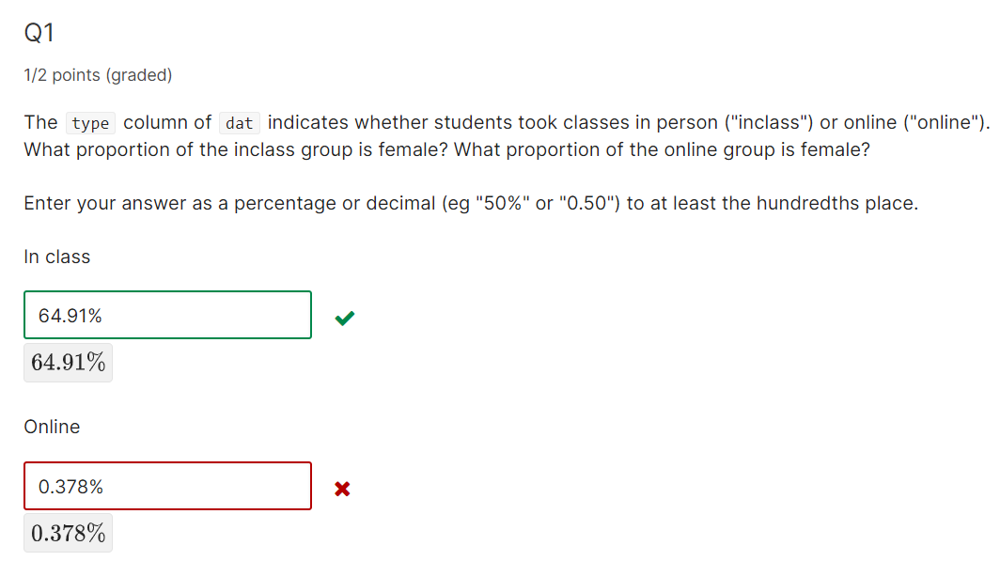

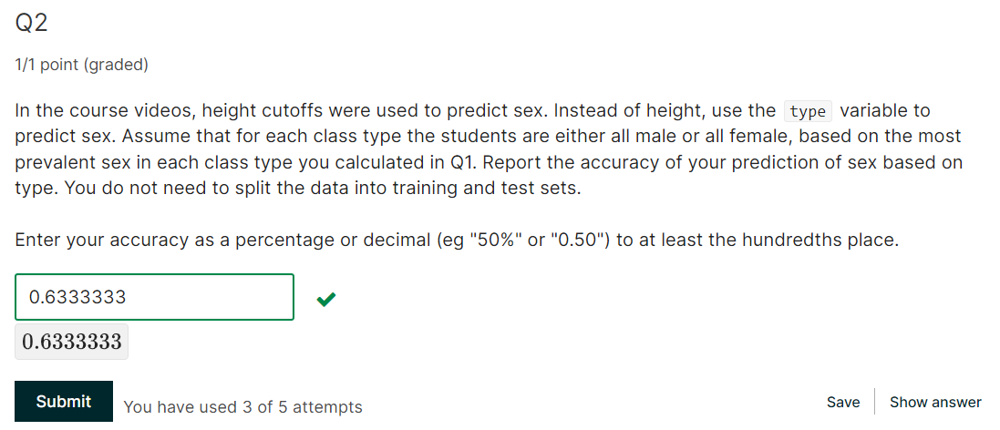

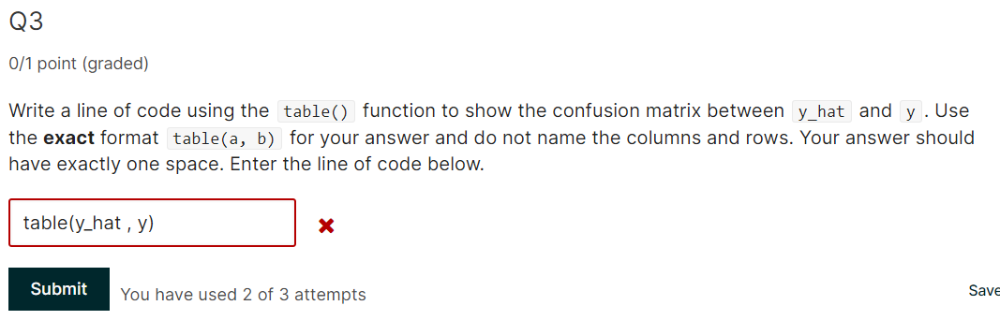

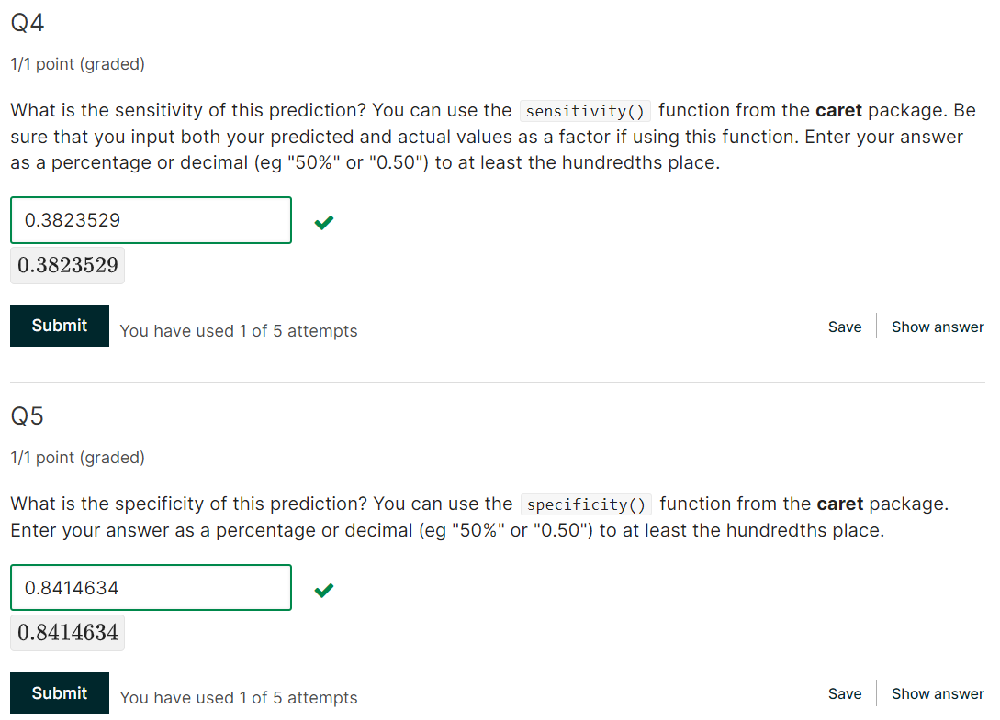

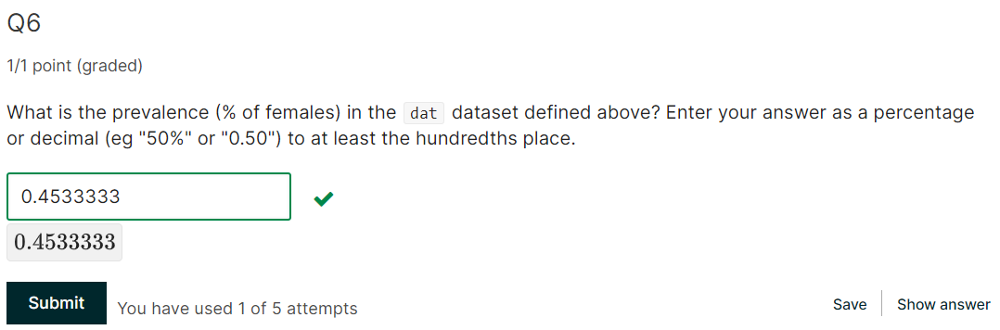

## **Comprehension Check: Practice with Machine Learning, Part 2**

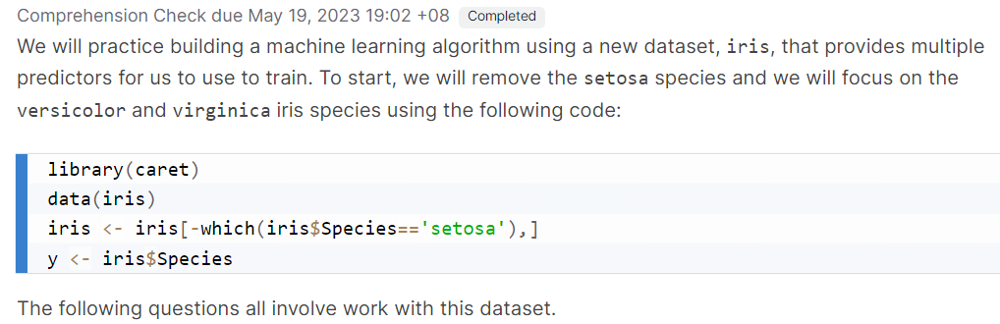

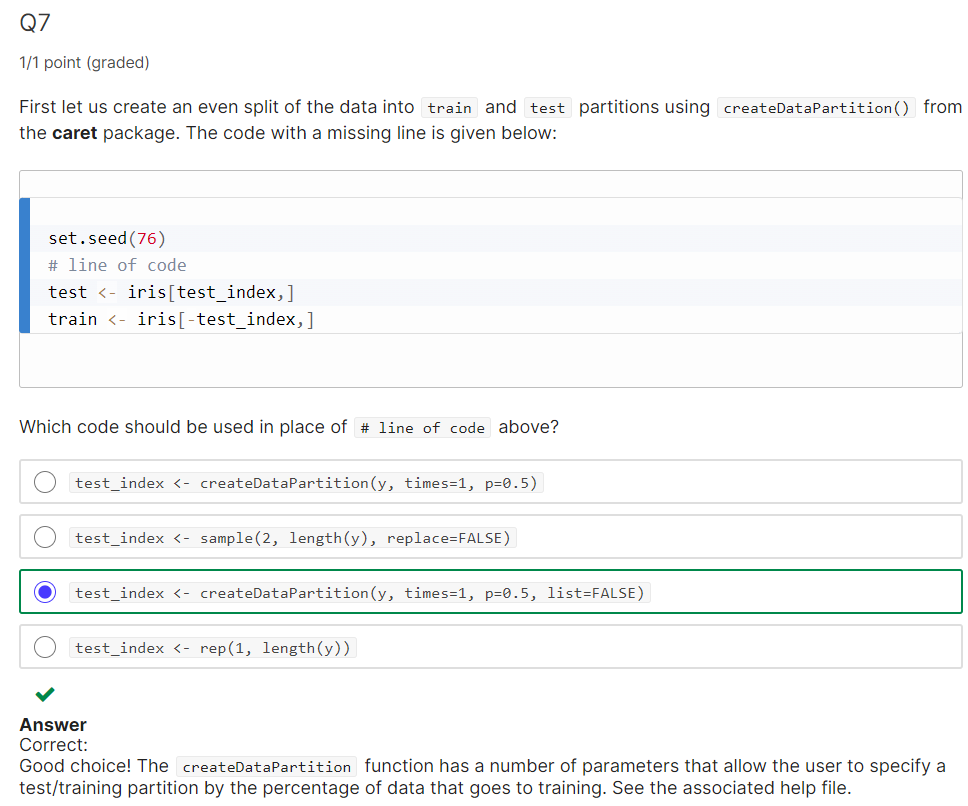

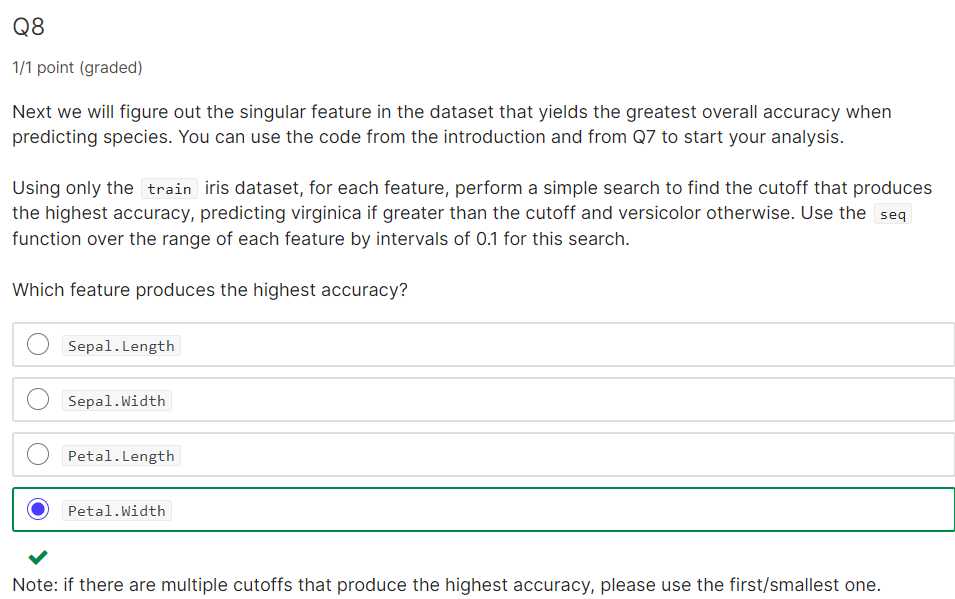

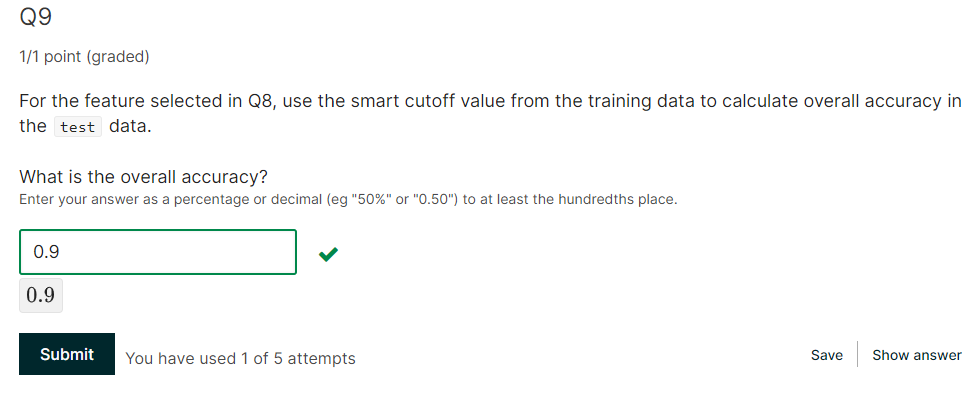

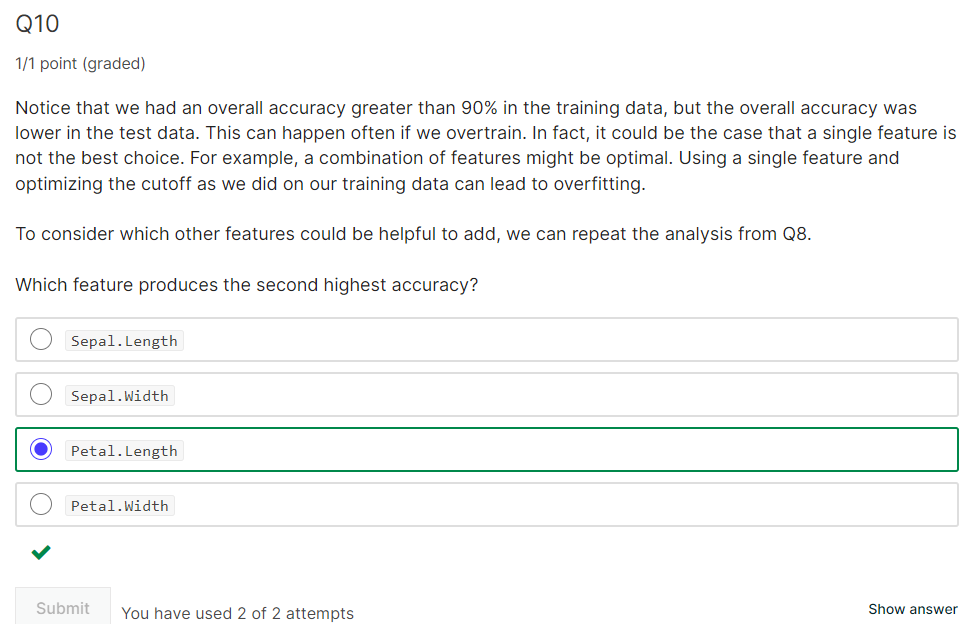

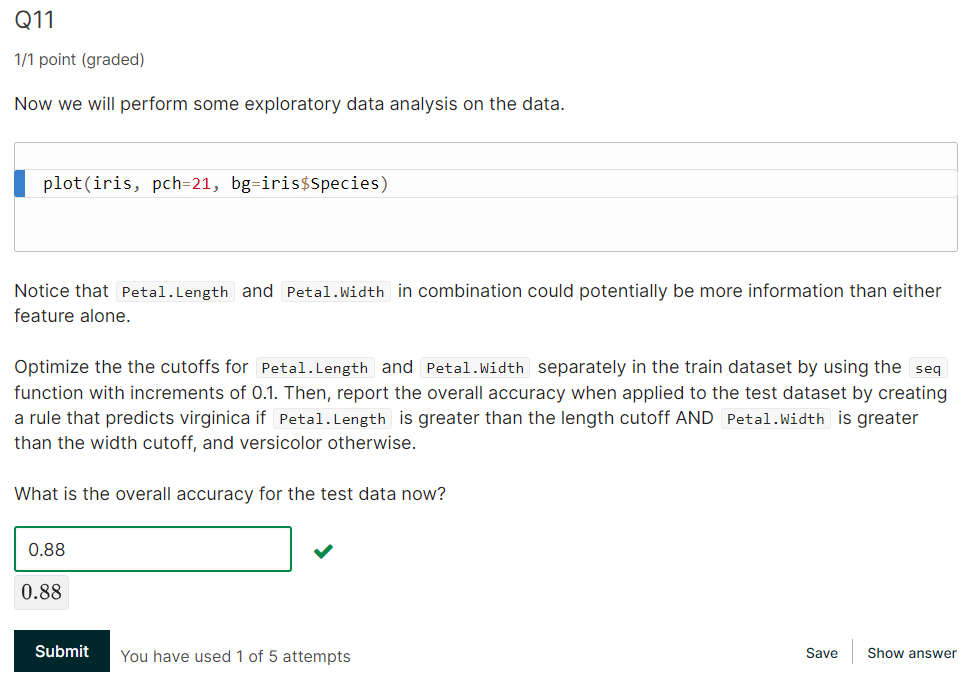


## **Conditional Probabilities**

Note that most data sets will include groups of observations with the same exact observed values for all predictors but with different outcomes.

Because our prediction rules are functions, equal inputs implies equal outputs.
Therefore, for a challenge in which the same predictors are associated with different outcomes across different individual observations, it is impossible to predict correctly for all these cases.

Observations with the same observed value for the predictions may not all be the same, but we can assume that they all have the same probability for each class. We will write this idea out mathematically for the case of categorical data.





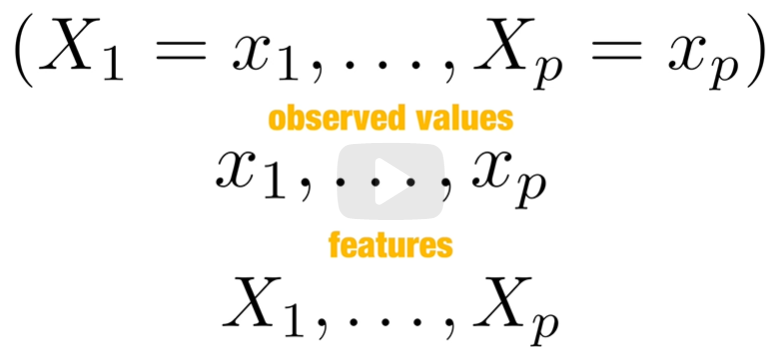

The probabilistic approach assumes all the observations with these features
have the same probability distribution as opposed to outcome y always taking
the same specific value.

In particular, we denote the conditional probabilities for each class k like this.

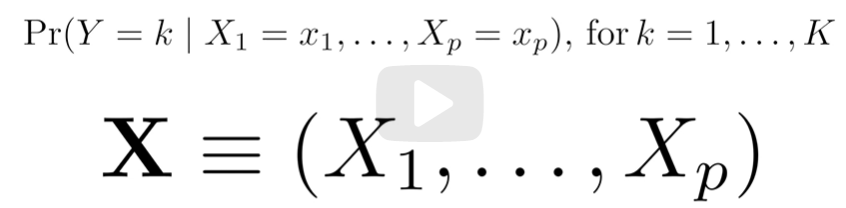

We will also use the following notation for the conditional probability
being in class k.

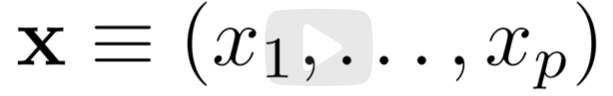

Now going forward, we'll use the small p notation to represent conditional probabilities as a function of the class.
Don't confuse this p with the p representing the number of features.
These probabilities guide the construction of an algorithm that makes the best possible prediction. For any given x, we will predict the class k with the largest probability among the p1 through pk of x.

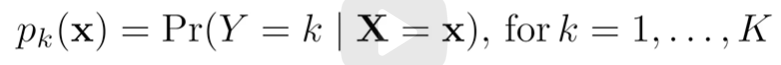

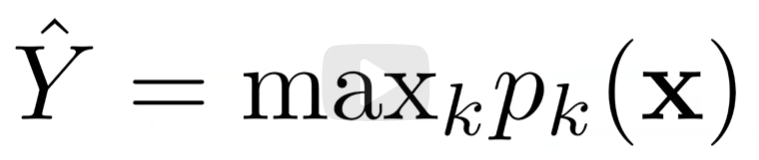


The better estimate of these probabilities, the better our predictor.

So our predictions depend on two things, how close are the maximum probabilities to 1 or 0, perfect certainty, and two how close our estimates are to the actual probabilities.

We can't do anything about the first restrictions, as it is determined by the nature of the problem.
So our energy goes into finding ways to best estimate the conditional probabilities.

This first restriction does imply that we have limits as to how well even the best possible algorithm can perform.You should get used to the idea that while in some challenges
we will be able to achieve almost perfect accuracy like with the digit readers, in others our success is restricted by the randomness of the process.
With movie recommendations, we will see this.

It is important to remember that defining our predictions by maximizing the probability. is not always optimal in practice and depends on the context.
As discussed previously, sensitivity and specificity may differ in importance.
But even in these cases, having a good estimate of the conditional probabilities for each class will suffice for us to build the optimal prediction
models, since we can control the balance between specificity and sensitivity
however we wish.
For instance, we can simply change the cutoffs used to predict one outcome or the other.
In the plane example, we may ground the plane any time the probability of malfunction is higher than one in a million as opposed to the default one-half used when error types are equally undesired.


## **Conditional expectations**

RAFAEL IRIZARRY: For binary data, you can think of the conditional probability as the proportion of ones in the stratum of the population when we observe little x.

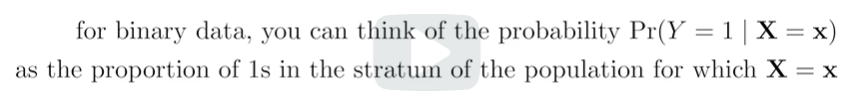

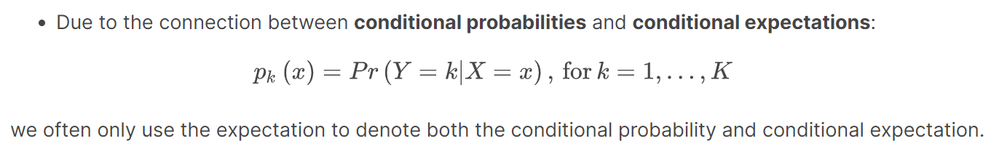

For continuous outcomes, we define a loss function to evaluate the model. The most commonly used one is MSE (Mean Squared Error). The reason why we care about the conditional expectation in machine learning is that the expected value minimizes the MSE:

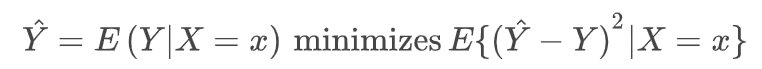

Due to this property, a succinct description of the main task of machine learning is that we use data to estimate this conditional expectation for any set of features. The main way in which competing machine learning algorithms differ is in their approach to estimating this expectation.

## **Comprehension Check: Conditional Probabilities Part 1**

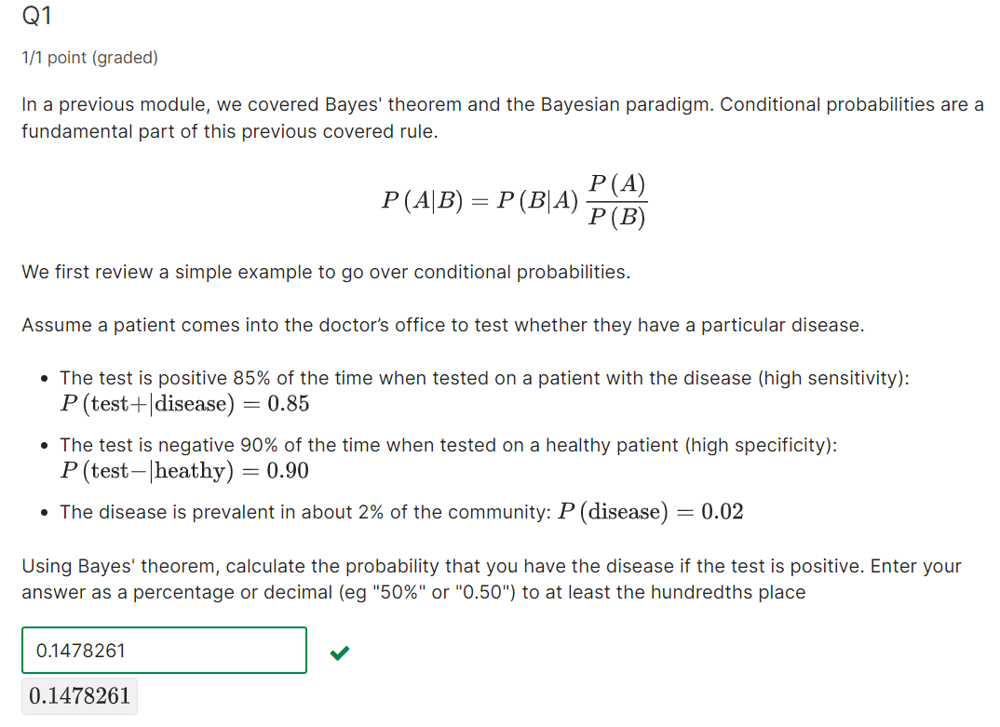

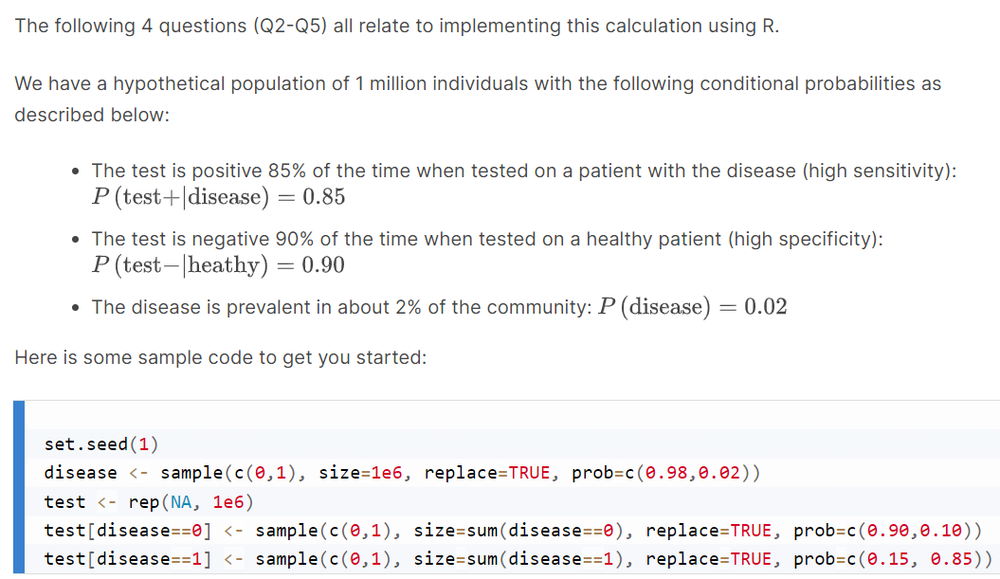

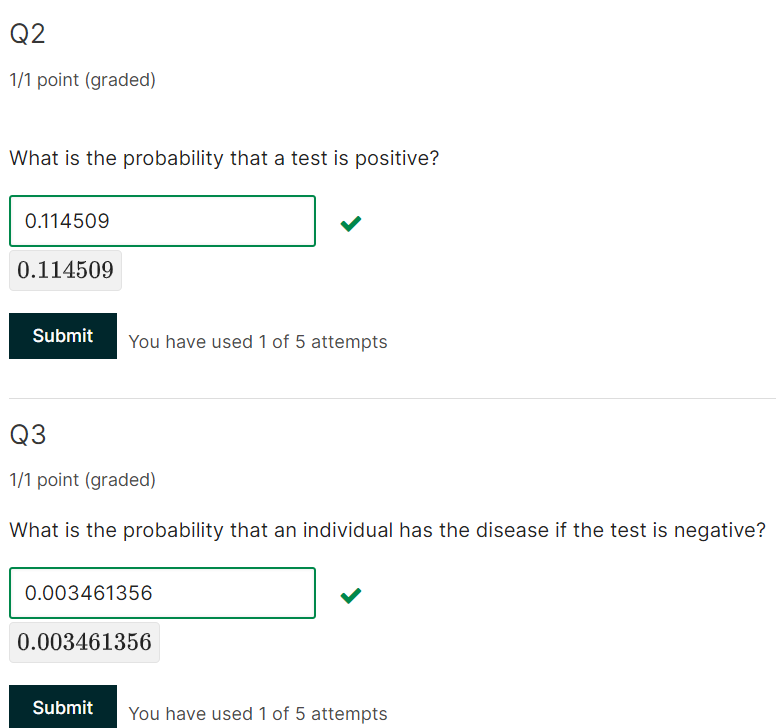

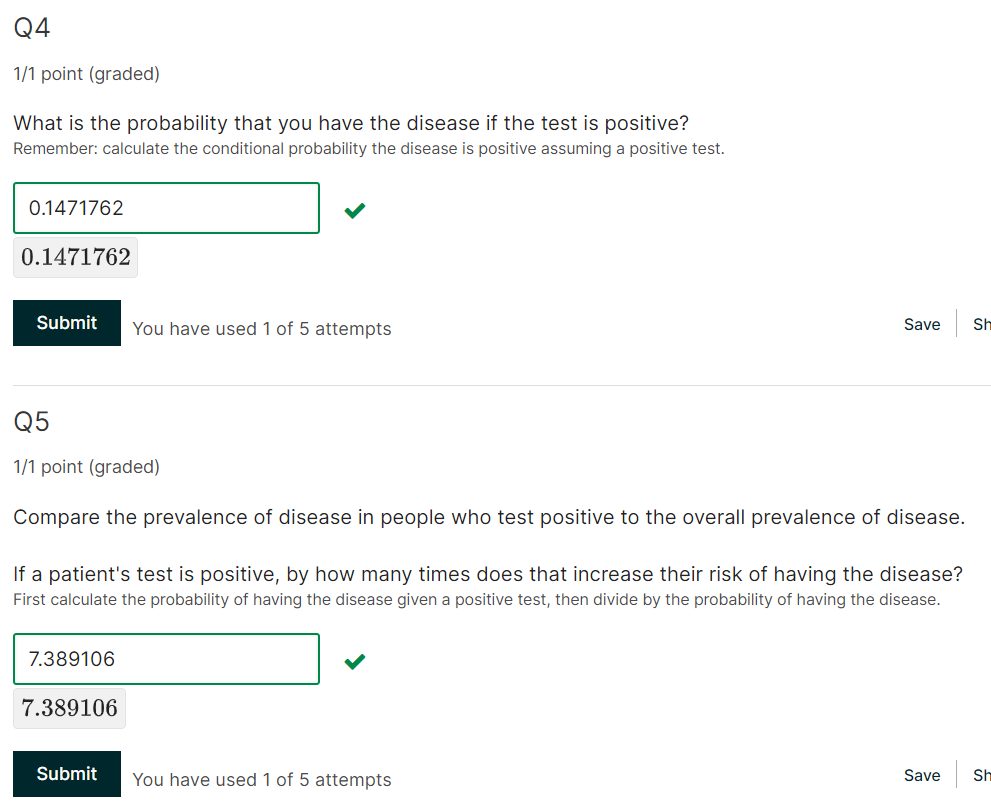

## **Comprehension Check: Conditional Probabilities Part 2**

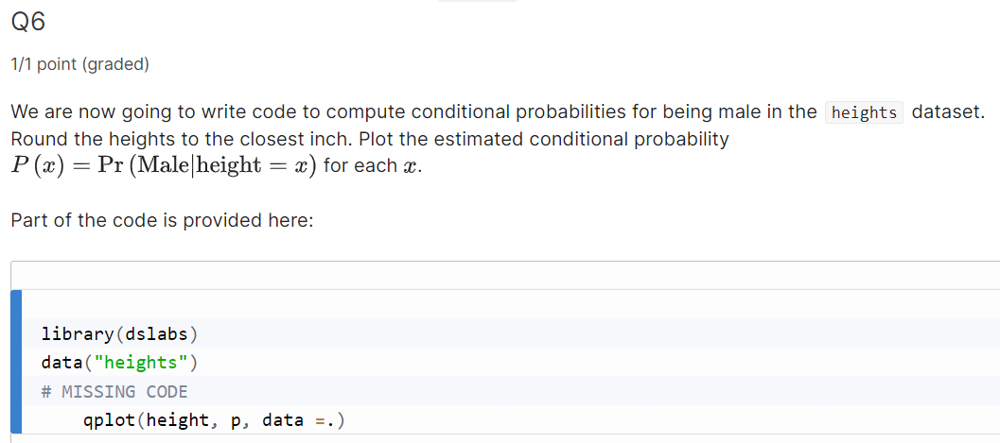

Which of the following blocks of code can be used to replace # MISSING CODE to make the correct plot?

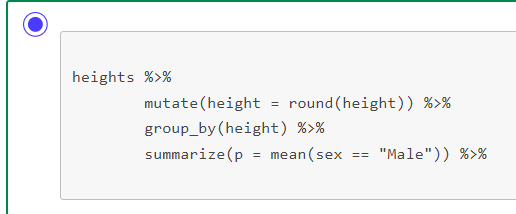

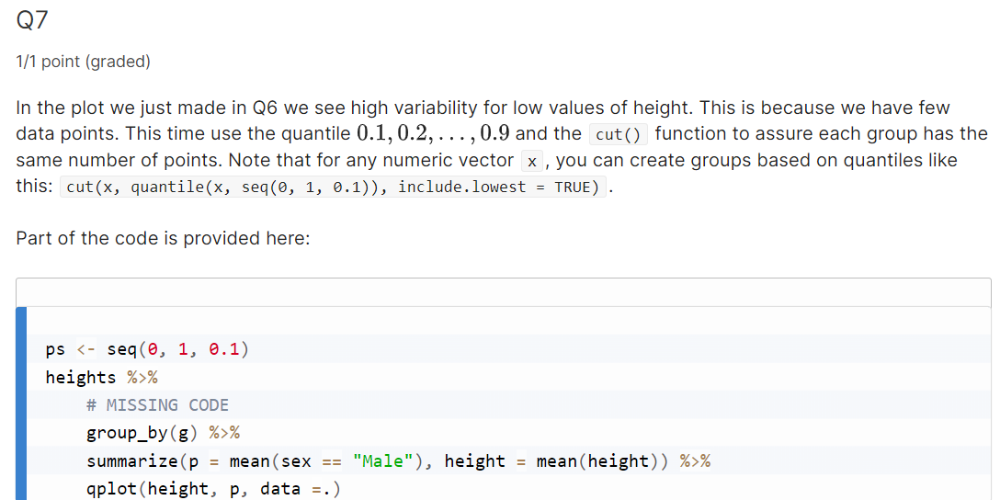

Which of the following lines of code can be used to replace # MISSING CODE to make the correct plot?

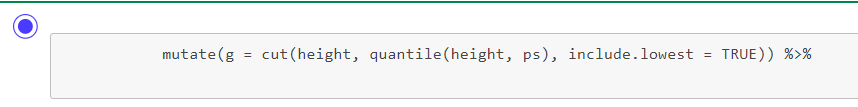

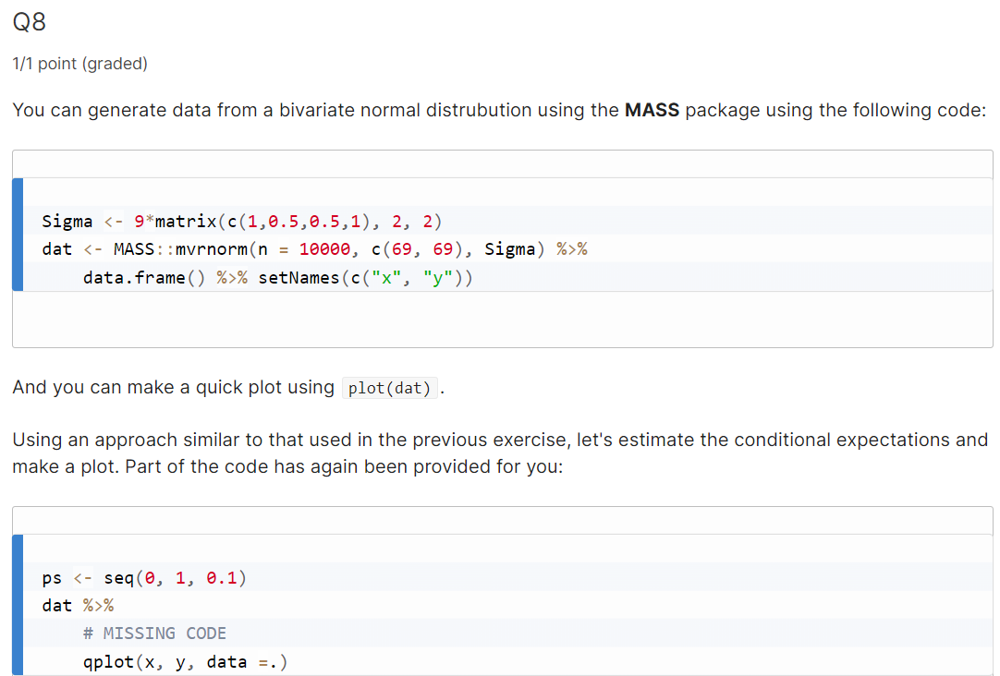

Which of the following blocks of code can be used to replace # MISSING CODE to make the correct plot?

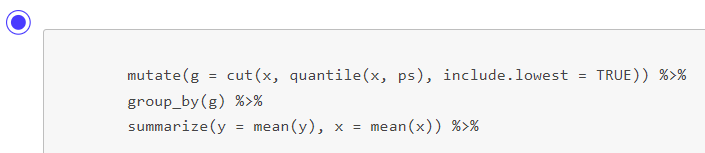

# **Section 3: Smoothing and Linear Regression for Prediction**

In the Smoothing and Linear Regression for Prediction section, you will learn why linear regression is a useful baseline approach but is often insufficiently flexible for more complex analyses and how to smooth noisy data.

After completing this section, you will be able to:

- Use linear regression for prediction as a baseline approach.
- Detect trends in noisy data using smoothing (also known as curve fitting or low pass filtering).

## **Case Study 2 or 7**

this data set, this problem, to one with two predictors and two classes. Specifically, we will define the challenge as building an algorithm that can distinguish the digit 2 from the digit 7.

These will be the proportion of dark pixels that are in the upper left
quadrant-- that will be x1--
and the proportion of dark pixels in the lower right quadrant-- that will be x2.

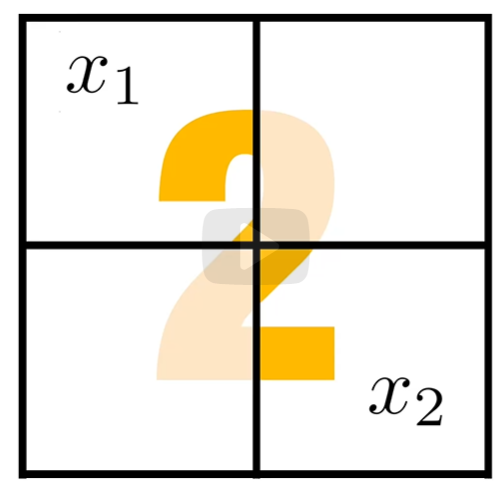

We then select a random sample of 1,000 digits.800 in training set and 200 in test set. We provide this illustrative data set in the dslabs package.

In [ ]:
# load the dataset
library(tidyverse)
library(dslabs)
data("mnist_27")

# explore the data by plotting the two predictors
mnist_27$train %>% ggplot(aes(x_1, x_2, color = y)) + geom_point()

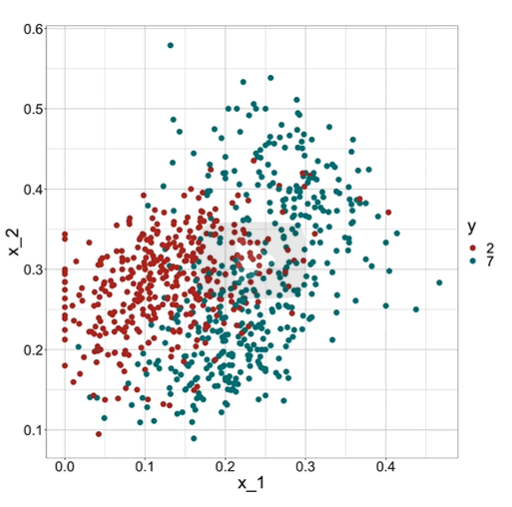

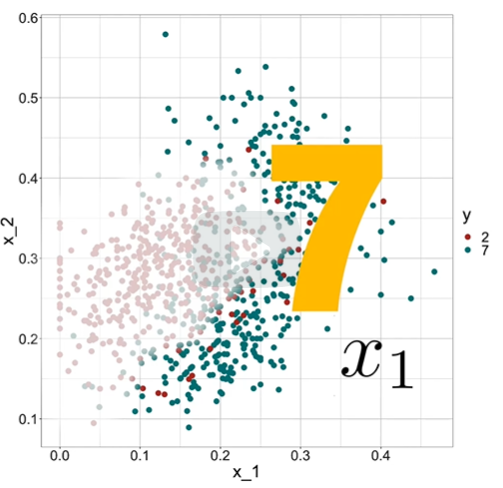

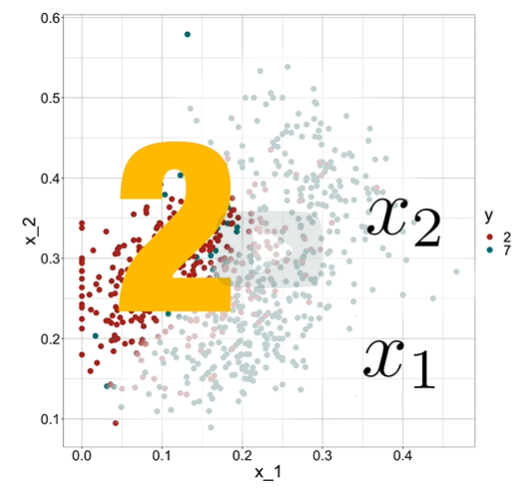

For example, if x1--the upper left panel-- is very large, then the digit is probably a seven.

Also for smaller values of x1, the 2 appear to be in the mid-range values of x2.

To illustrate how to interpret x1 and x2, we include four example images.
On the left are the original images of the two digits with the largest
and smallest values for x1.
And on the right, we have the images corresponding
to the largest and smallest values of x2.

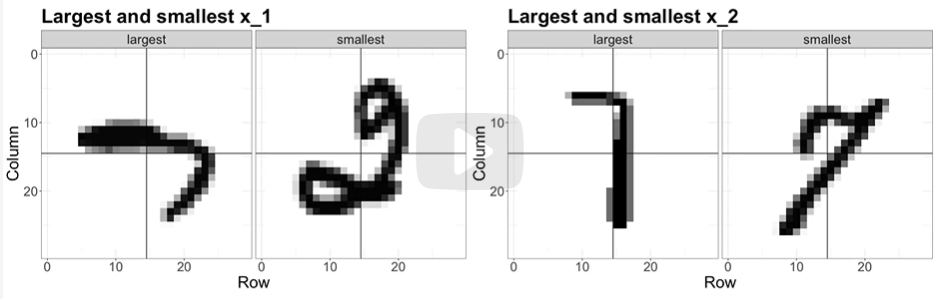



Use Linear Regression

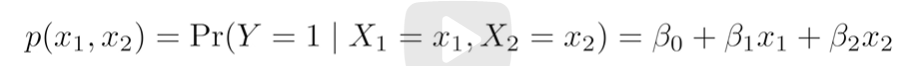

In [ ]:
# load the dataset
library(tidyverse)
library(dslabs)
data("mnist_27")

# explore the data by plotting the two predictors
mnist_27$train %>% ggplot(aes(x_1, x_2, color = y)) + geom_point()

# smallest and largest values of x1 and x2
if(!exists("mnist")) mnist <- read_mnist()
is <- mnist_27$index_train[c(which.min(mnist_27$train$x_1), which.max(mnist_27$train$x_1))]
titles <- c("smallest","largest")
tmp <- lapply(1:2, function(i){
    expand.grid(Row=1:28, Column=1:28) %>%
      mutate(label=titles[i],
             value = mnist$train$images[is[i],])
})
tmp <- Reduce(rbind, tmp)
p1 <- tmp %>% ggplot(aes(Row, Column, fill=value)) +
  geom_raster(show.legend = FALSE) +
  scale_y_reverse() +
  scale_fill_gradient(low="white", high="black") +
  facet_grid(.~label) +
  geom_vline(xintercept = 14.5) +
  geom_hline(yintercept = 14.5) +
  ggtitle("Largest and smallest x_1")

is <- mnist_27$index_train[c(which.min(mnist_27$train$x_2), which.max(mnist_27$train$x_2))]
titles <- c("smallest","largest")
tmp <- lapply(1:2, function(i){
    expand.grid(Row=1:28, Column=1:28) %>%
      mutate(label=titles[i],
             value = mnist$train$images[is[i],])
})
tmp <- Reduce(rbind, tmp)
p2 <- tmp %>% ggplot(aes(Row, Column, fill=value)) +
    geom_raster(show.legend = FALSE) +
    scale_y_reverse() +
    scale_fill_gradient(low="white", high="black") +
    facet_grid(.~label) +
    geom_vline(xintercept = 14.5) +
    geom_hline(yintercept = 14.5) +
  ggtitle("Largest and smallest x_2")
gridExtra::grid.arrange(p1, p2, ncol = 2)

# fit the model
fit <- mnist_27$train %>%
  mutate(y = ifelse(y == 7, 1, 0)) %>%
  lm(y ~ x_1 + x_2, data = .)

# build a decision rule
library(caret)

p_hat < predict(fit, newdata = mnist_27$test, type = "response")
y_hat <- factor(ifelse(p_hat > 0.5, 7, 2))

confusionMatrix(y_hat, mnist_27$test$y)$overall[["Accuracy"]]

# Output = 0.75

# plot the true values
mnist_27$true_p %>% ggplot(aes(x_1, x_2, z = p, fill = p)) +
  geom_raster() +
  scale_fill_gradientn(colors=c("#F8766D", "white", "#00BFC4")) +
  stat_contour(breaks=c(0.5), color="black")

# visual representation of p_hat
p_hat <- predict(fit, newdata = mnist_27$true_p)
p_hat <- scales::squish(p_hat, c(0, 1))
p1 <- mnist_27$true_p %>% mutate(p_hat = p_hat) %>%
  ggplot(aes(x_1, x_2,  z=p_hat, fill=p_hat)) +
  geom_raster() +
  scale_fill_gradientn(colors=c("#F8766D","white","#00BFC4")) +
  stat_contour(breaks=c(0.5), color="black")

p2 <- mnist_27$true_p %>% mutate(p_hat = p_hat) %>%
  ggplot() +
  stat_contour(aes(x_1, x_2, z=p_hat), breaks=c(0.5), color="black") +
  geom_point(mapping = aes(x_1, x_2, color=y), data = mnist_27$test)
gridExtra::grid.arrange(p1, p2, ncol = 2)

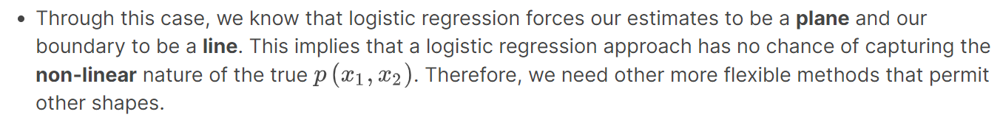

## **Comprehension Check: Linear Regression**

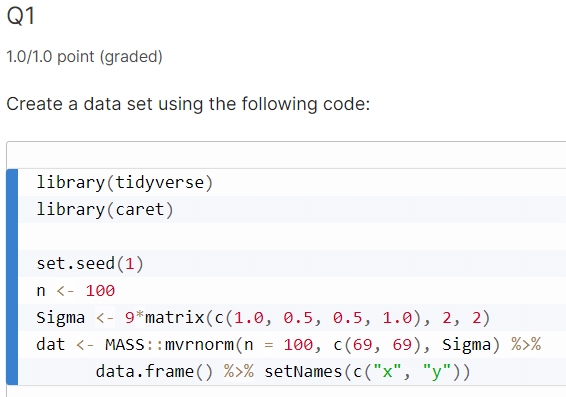

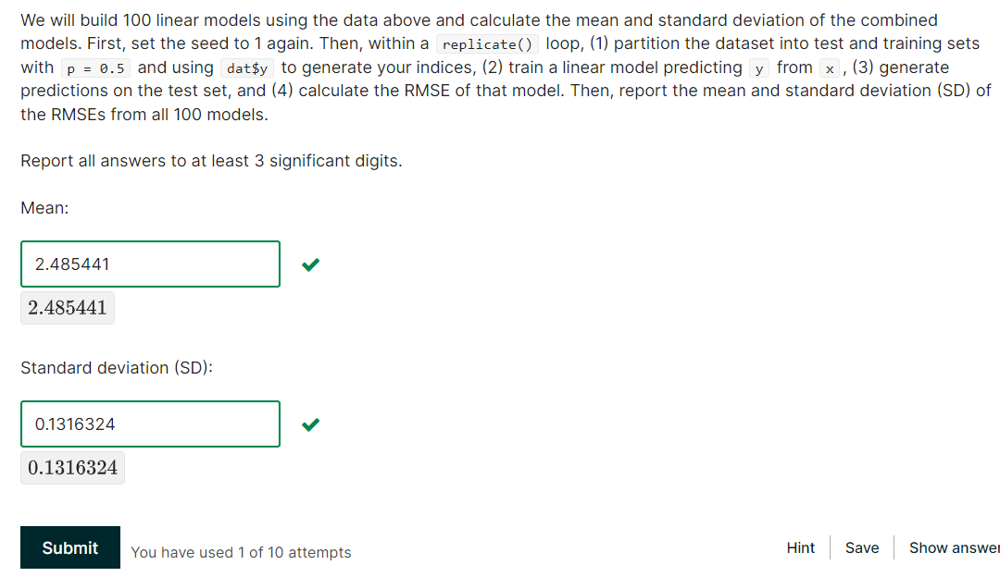

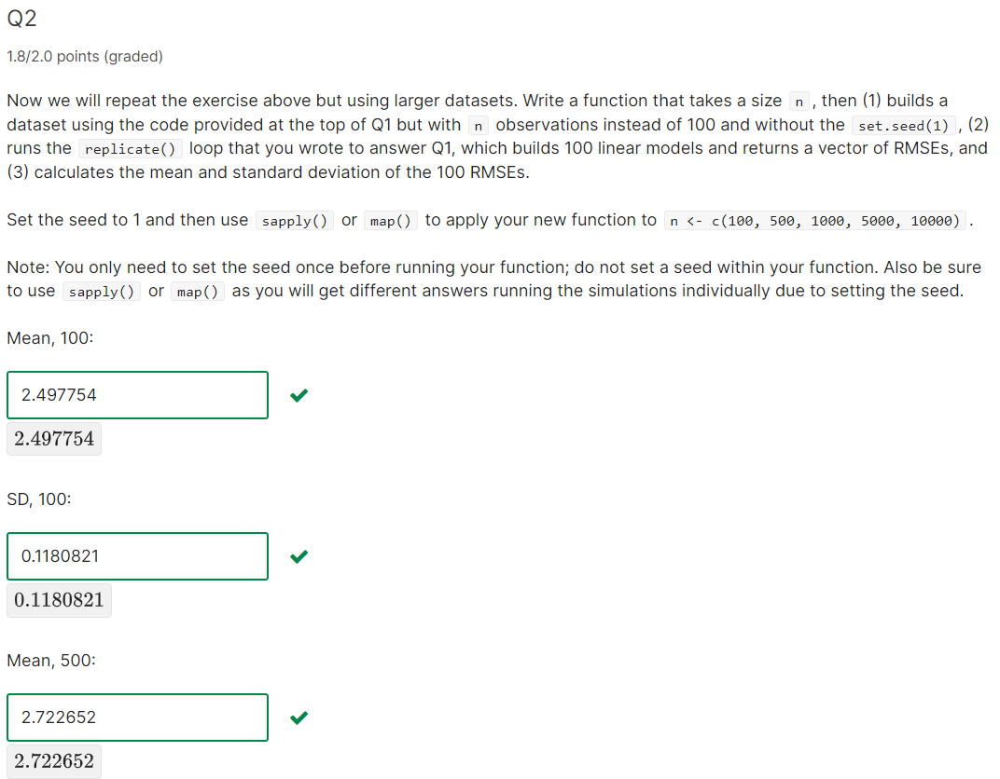

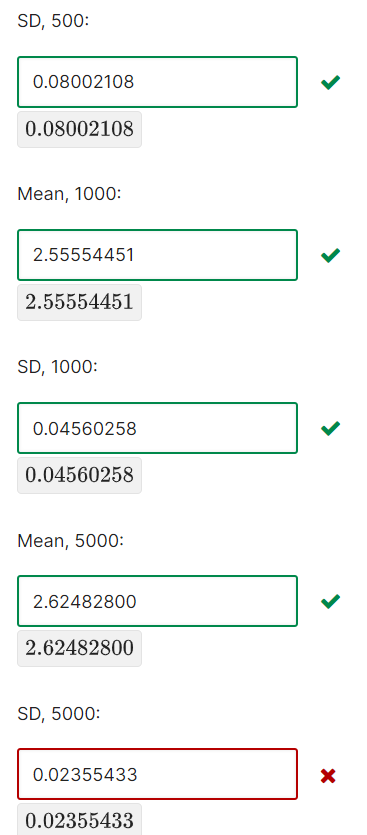

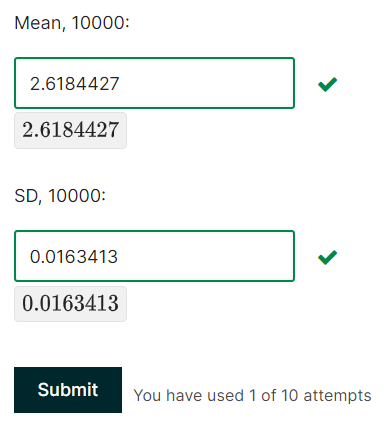

...

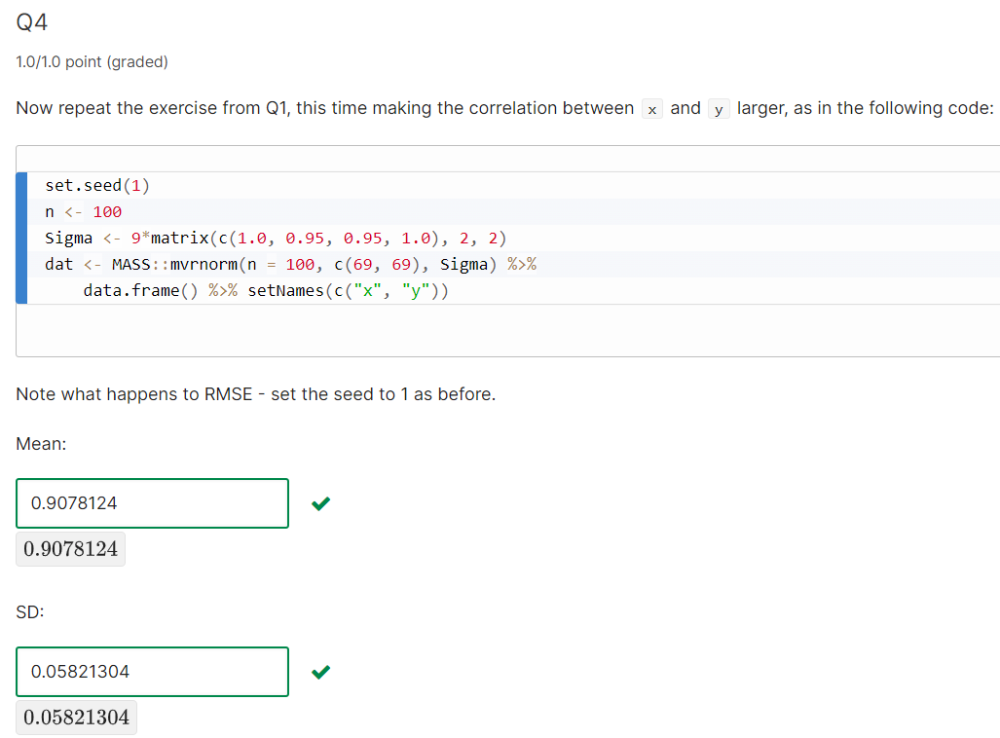

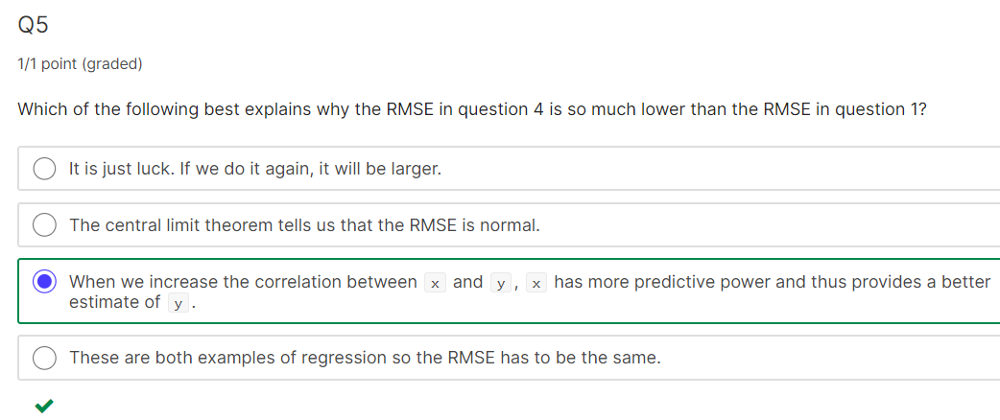

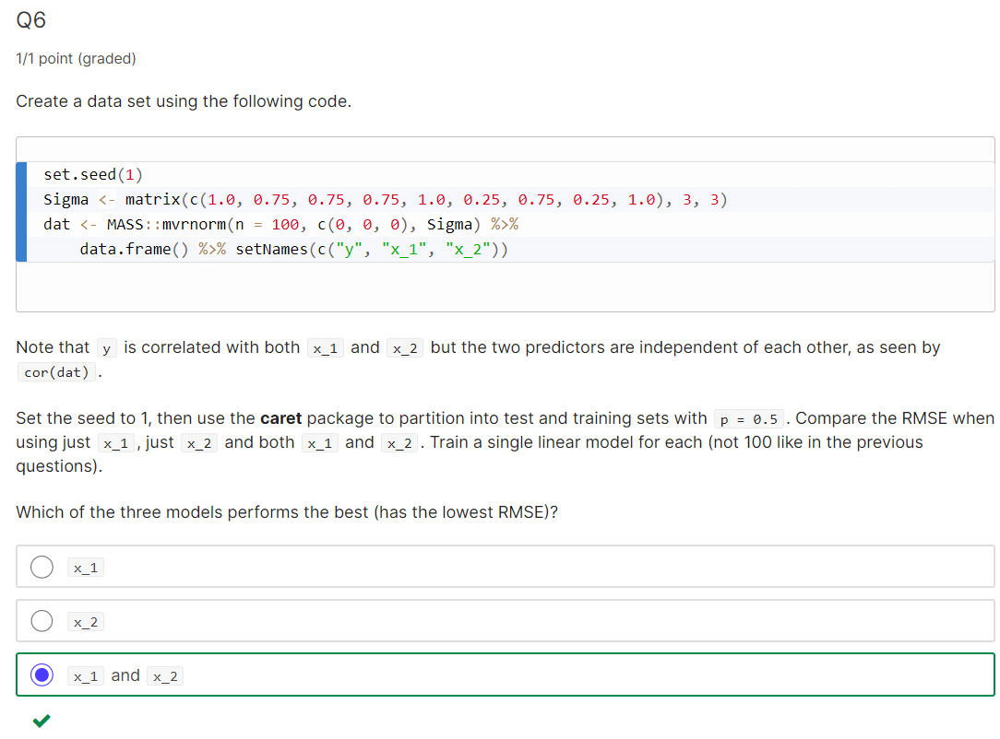

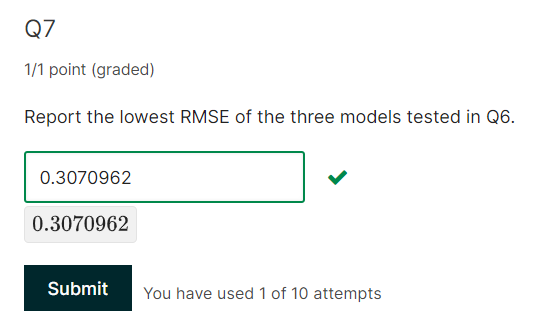

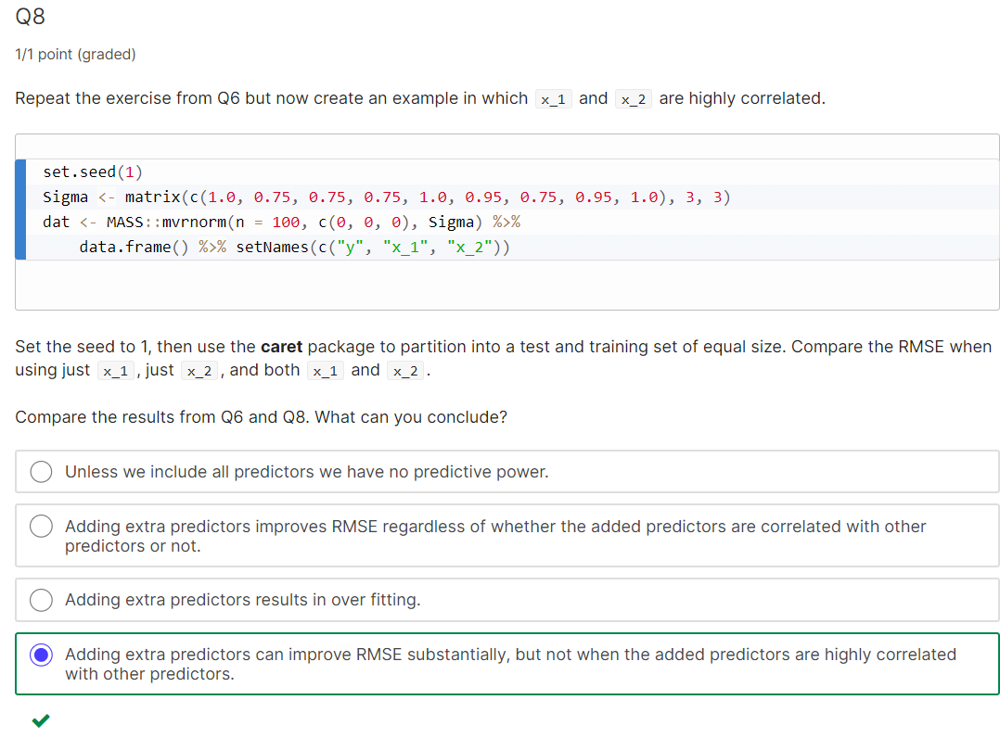

## **Smoothing/ Curve Fitting/ Low Pass Filtering**

Smoothing is a very powerful technique used all across data analysis. It is designed to detect trends in the presence of noisy data in cases in which the shape of the trend is unknown.

The concepts behind smoothing techniques are extremely useful in machine learning because conditional expectations/probabilities can be thought of as trends of unknown shapes that we need to estimate in the presence of uncertainty.

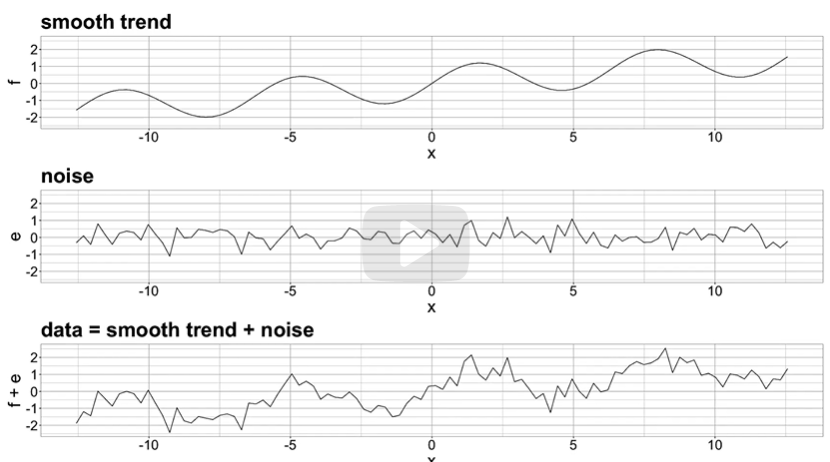

In [ ]:
# see that the trend is wobbly
library(tidyverse)
set.seed(1)
n <- 100
x <- seq(-pi*4, pi*4, len = n)
tmp <- data.frame(x = x , f = sin(x) + x/8, e = rnorm(n, 0, 0.5))
p1 <- qplot(x, f, main = "smooth trend", ylim = range(tmp$f+tmp$e), data = tmp, geom = "line")
p2 <- qplot(x, e, main = "noise", ylim = range(tmp$f+tmp$e), data = tmp, geom = "line")
p3 <- qplot(x, f+e, main = "data = smooth trend + noise", ylim = range(tmp$f+tmp$e), data = tmp, geom = "line")
gridExtra::grid.arrange(p1, p2, p3)

# estimate the time trend in the 2008 US popular vote poll margin
library(tidyverse)
library(dslabs)
data("polls_2008")
qplot(day, margin, data = polls_2008)

# use regression to estimate
resid <- ifelse(lm(margin~day, data = polls_2008)$resid > 0, "+", "-")
polls_2008 %>%
     mutate(resid = resid) %>%
     ggplot(aes(day, margin)) +
     geom_smooth(method = "lm", se = FALSE, color = "black") +
     geom_point(aes(color = resid), size = 3)

## **Bin Smoothing and Kernels**

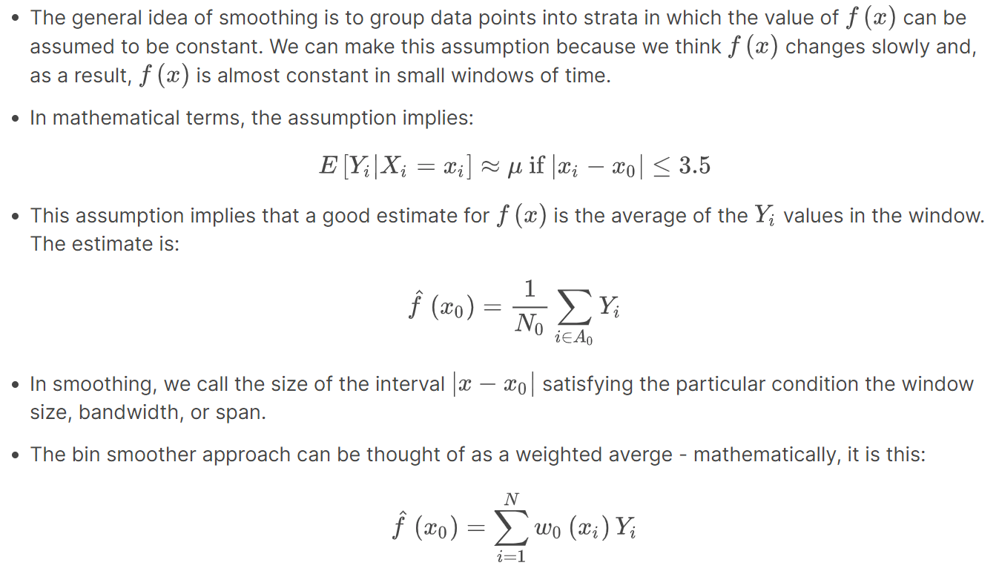

In [ ]:
# bin smoothers
span <- 3.5
tmp <- polls_2008 %>%
  crossing(center = polls_2008$day) %>%
  mutate(dist = abs(day - center)) %>%
  filter(dist <= span)

tmp %>% filter(center %in% c(-125, -55)) %>%
  ggplot(aes(day, margin)) +
  geom_point(data = polls_2008, size = 3, alpha = 0.5, color = "grey") +
  geom_point(size = 2) +
  geom_smooth(aes(group = center),
              method = "lm", formula=y~1, se = FALSE) +
  facet_wrap(~center)

# larger span
span <- 7
fit <- with(polls_2008,
            ksmooth(day, margin, kernel = "box", bandwidth = span))

polls_2008 %>% mutate(smooth = fit$y) %>%
  ggplot(aes(day, margin)) +
    geom_point(size = 3, alpha = .5, color = "grey") +
  geom_line(aes(day, smooth), color="red")

# kernel
span <- 7
fit <- with(polls_2008,
            ksmooth(day, margin, kernel = "normal", bandwidth = span))

polls_2008 %>% mutate(smooth = fit$y) %>%
  ggplot(aes(day, margin)) +
  geom_point(size = 3, alpha = .5, color = "grey") +
  geom_line(aes(day, smooth), color="red")

## **Local Weighted Regression (loess)**

A limitation of the bin smoothing approach is that we need small windows for the approximately constant assumptions to hold which may lead to imprecise estimates of f(x). Local weighted regression (loess) permits us to consider larger window sizes.

One important difference between loess and bin smoother is that we assume the smooth function is locally linear in a window instead of constant.

The result of loess is a smoother fit than bin smoothing because we use larger sample sizes to estimate our local parameters.

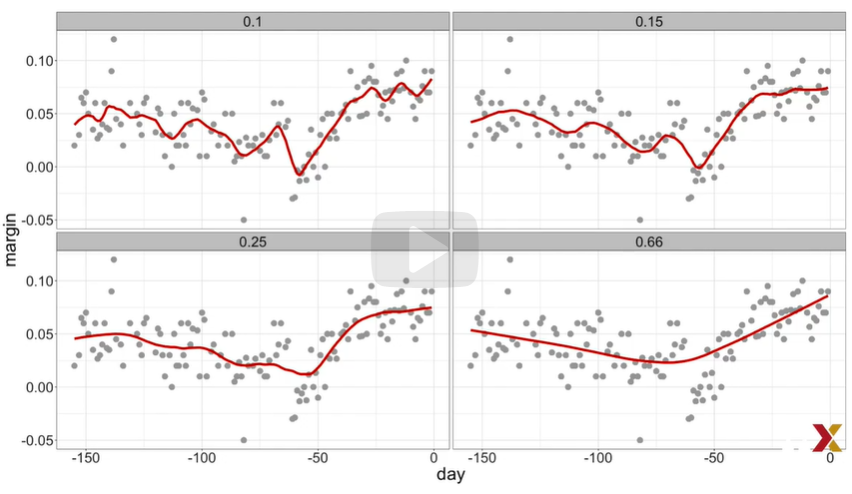

## **Beware of Default Smoothing Parameters**

Local weighted regression (loess) permits us to fit parabola by considering a larger window size than the one considered while fitting a line.

In [ ]:
total_days <- diff(range(polls_2008$day))
span <- 28/total_days
fit_1 <- loess(margin ~ day, degree=1, span = span, data=polls_2008)
fit_2 <- loess(margin ~ day, span = span, data=polls_2008)


polls_2008 %>% mutate(smooth_1 = fit_1$fitted, smooth_2 = fit_2$fitted) %>%
     ggplot(aes(day, margin)) +
     geom_point(size = 3, alpha = .5, color = "grey") +
     geom_line(aes(day, smooth_1), color="red", lty = 2) +
     geom_line(aes(day, smooth_2), color="orange", lty = 1)


polls_2008 %>% ggplot(aes(day, margin)) +
     geom_point() +
     geom_smooth()

Be careful with default parameters as they are rarely optimal. However, you can conveniently change them.

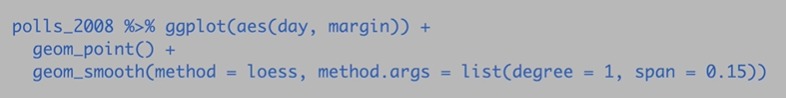

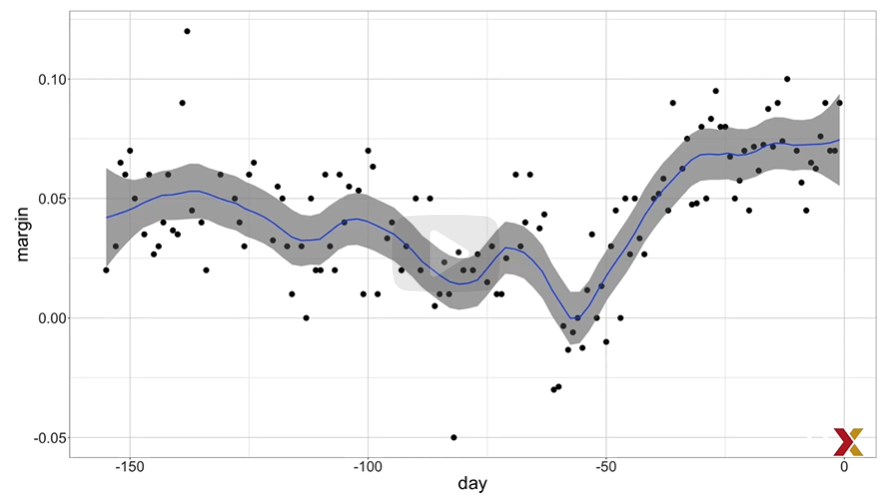

## **Connecting Smoothing to Machine Learning**

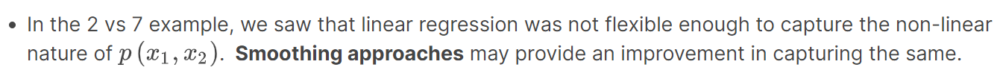

If we define our outcome to be y equals 1 for digits that are 7 and y equals 0 for digits that are 2, then we are interested in estimating the following conditional probability.

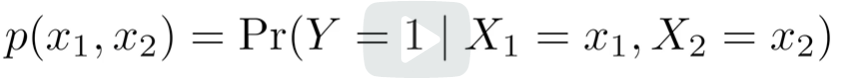

Here, x1 and x2 are the two predictors we defined in a previous lecture. They represent the average amount of black pixels in two quadrants.

In this example, the zeros and ones we observe are noisy, because for some regions, the probabilities p of x1,x2 are not that close to either 0 or 1, so we need to estimate p of x1,x2.

Previously, we used linear regression. Smoothing is an alternative to accomplishing this. We saw that linear regression was not flexible enough to capture the nonlinear nature of p of x1,x2. Thus, smoothing approaches may provide an improvement.

In an upcoming video, we describe a popular machine learning algorithm, k-nearest neighbors, which is based on smoothing.

## **Comprehension Check: Smoothing**



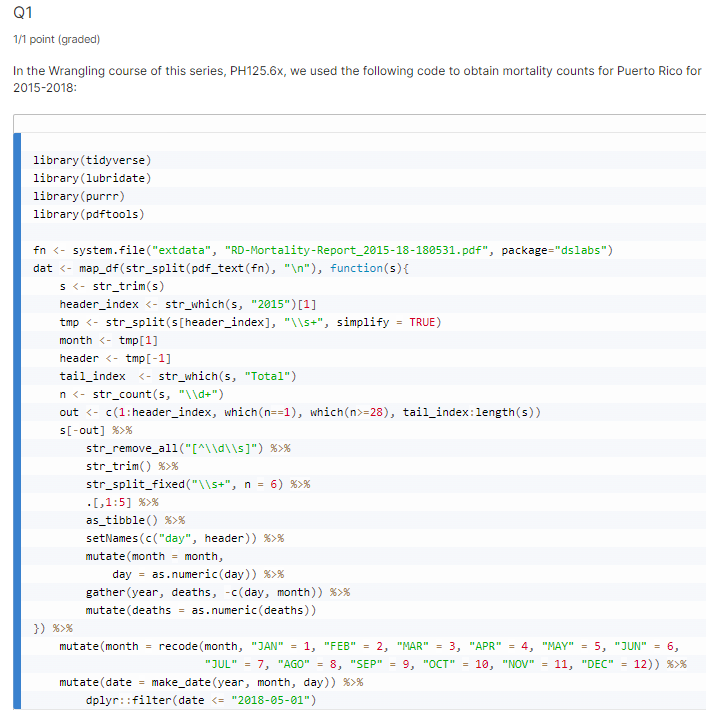

Use the loess() function to obtain a smooth estimate of the expected number of deaths as a function of date. Plot this resulting smooth function. Make the span about two months (60 days) long and use degree = 1.

Which of the following plots is correct?

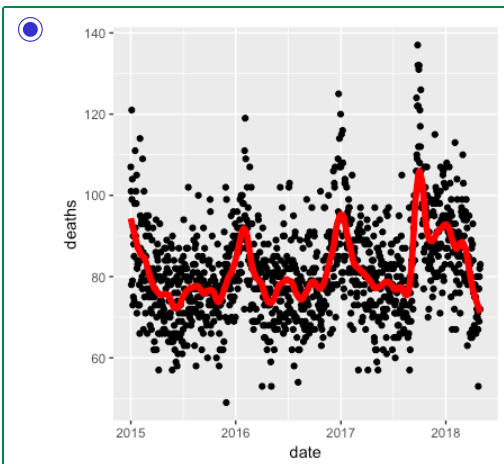

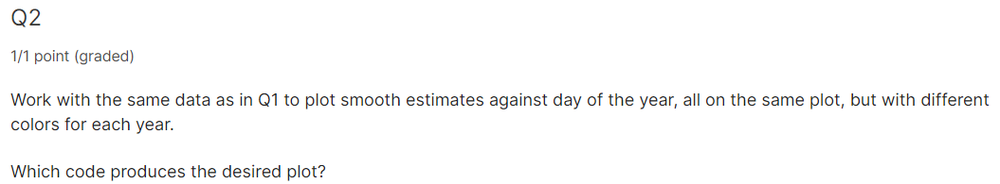




In [ ]:
dat %>%
    mutate(smooth = predict(fit, as.numeric(date)), day = yday(date), year = as.character(year(date))) %>%
    ggplot(aes(day, smooth, col = year)) +
    geom_line(lwd = 2)

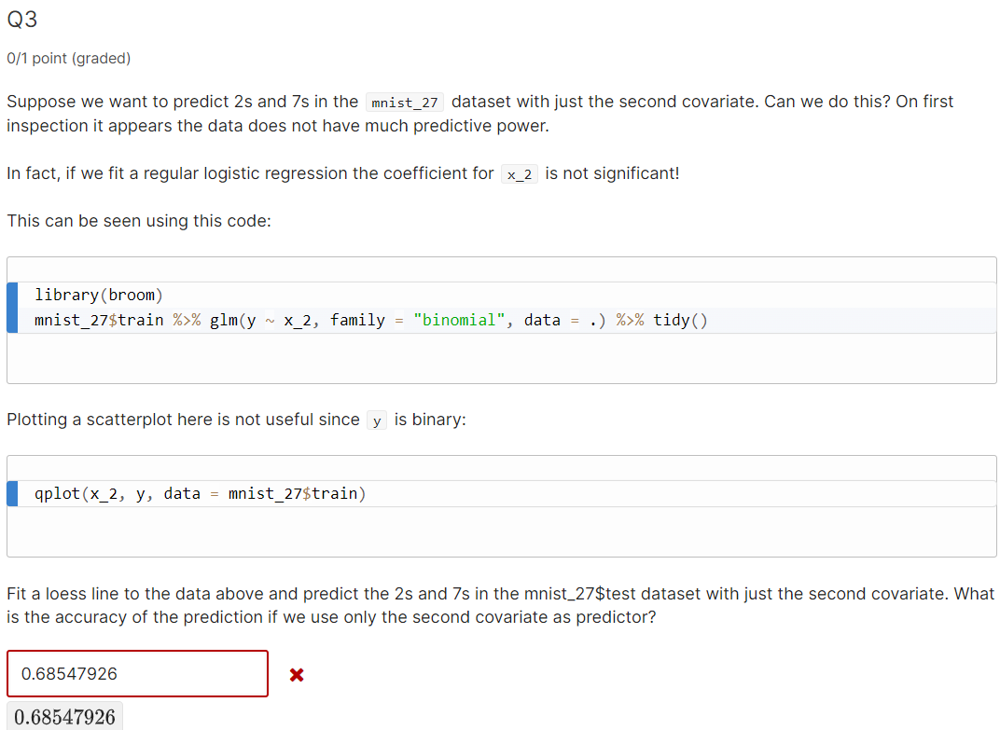

# **Section 4: Cross-validation and k-Nearest Neighbors**

In the Cross-validation and k-Nearest Neighbors section, you will learn about different types of discriminative and generative approaches for machine learning algorithms.

After completing this section, you will be able to:

- Use the k-nearest neighbors (kNN) algorithm.
- Understand the problems of overtraining and oversmoothing.
- Use cross-validation to reduce the true error and the apparent error.

**k-Nearest Neighbors (kNN)** estimates the conditional probabilities in a similar way to bin smoothing. However, kNN is easier to adapt to multiple dimensions.

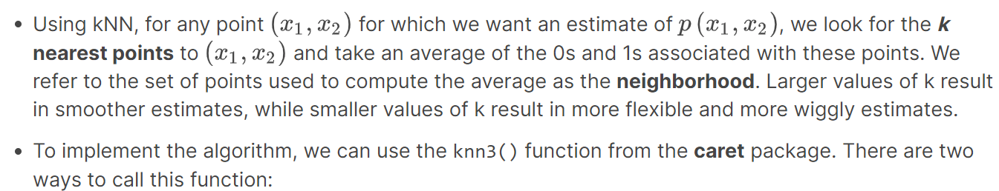

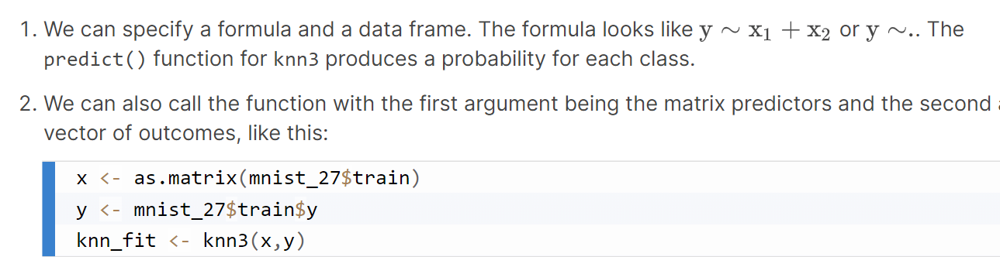

In [ ]:
library(tidyverse)
library(caret)
library(dslabs)
library(gridExtra)
library(tidyverse)

data("mnist_27")

mnist_27$test %>%
  ggplot(aes(x_1, x_2, color = y)) +
  geom_point()

knn_fit <- knn3(y ~ ., data = mnist_27$train)

y_hat_knn <- predict(knn_fit, mnist_27$test, type = "class")
confusionMatrix(y_hat_knn, mnist_27$test$y)$overall["Accuracy"]

fit_lm <- mnist_27$train %>%
  mutate(y = ifelse(y == 7, 1, 0)) %>%
  lm(y ~ x_1 + x_2, data = .)
p_hat_lm <- predict(fit_lm, mnist_27$test)
y_hat_lm <- factor(ifelse(p_hat_lm > 0.5, 7, 2))
confusionMatrix(y_hat_lm, mnist_27$test$y)$overall["Accuracy"]

plot_cond_prob <- function(p_hat=NULL){
  tmp <- mnist_27$true_p
  if(!is.null(p_hat)){
    tmp <- mutate(tmp, p=p_hat)
  }
  tmp %>% ggplot(aes(x_1, x_2, z=p, fill=p)) +
    geom_raster(show.legend = FALSE) +
    scale_fill_gradientn(colors=c("#F8766D", "white", "#00BFC4")) +
    stat_contour(breaks=c(0.5), color="black")
}
p1 <- plot_cond_prob() +
  ggtitle("True conditional probability")
p2 <- plot_cond_prob(predict(knn_fit, mnist_27$true_p)[,2]) +
  ggtitle("kNN-5 estimate")
grid.arrange(p2, p1, nrow=1)

y_hat_knn <- predict(knn_fit, mnist_27$train, type = "class")
confusionMatrix(y_hat_knn, mnist_27$train$y)$overall["Accuracy"]

y_hat_knn <- predict(knn_fit, mnist_27$test, type = "class")
confusionMatrix(y_hat_knn, mnist_27$test$y)$overall["Accuracy"]

## **Comprehension Check: Nearest Neighbors**

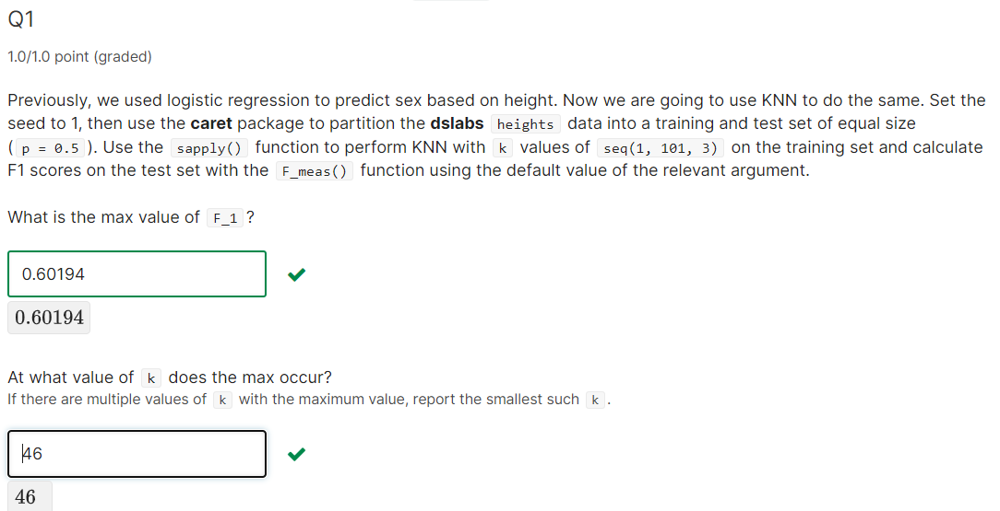

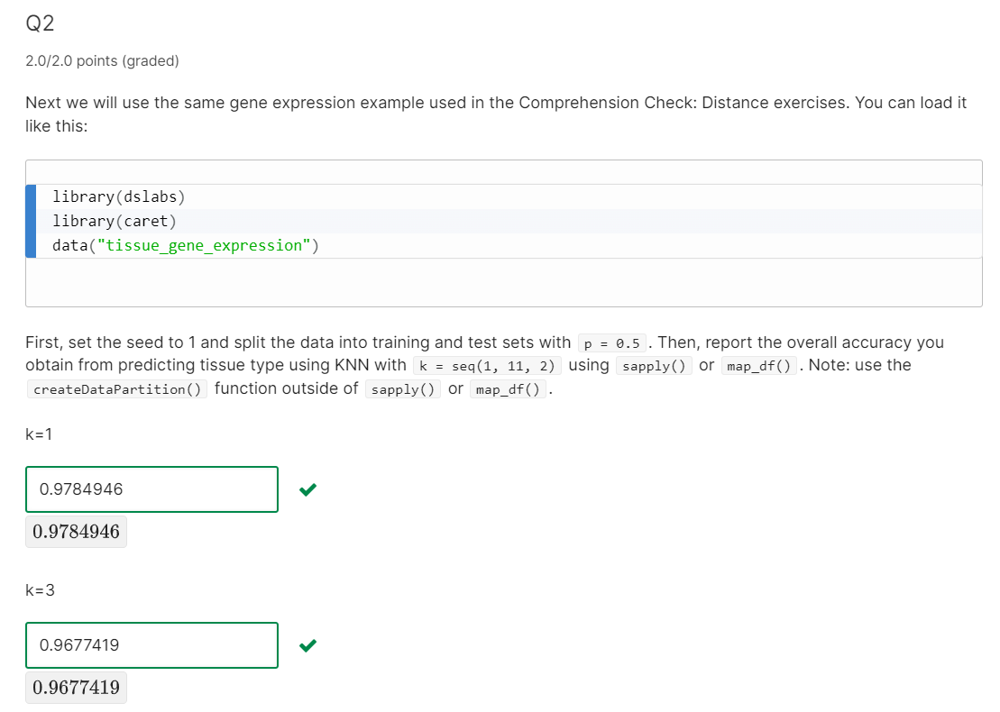

## **Choosing k**

Due to overtraining, the accuracy estimates obtained with the test set will be generally lower than the estimates obtained with the training set.

We prefer to minimize the expected loss rather than the loss we observe in just one dataset. Also, if we were to use the test set to pick k, we should not expect the accompanying accuracy estimate to extrapolate to the real world. This is because even here we broke a golden rule of machine learning: we selected the  using the test set. Cross validation provides an estimate that takes these into account.

In [ ]:
ks <- seq(3, 251, 2)

library(purrr)
accuracy <- map_df(ks, function(k){
  fit <- knn3(y ~ ., data = mnist_27$train, k = k)

  y_hat <- predict(fit, mnist_27$train, type = "class")
  cm_train <- confusionMatrix(y_hat, mnist_27$train$y)
  train_error <- cm_train$overall["Accuracy"]

  y_hat <- predict(fit, mnist_27$test, type = "class")
  cm_test <- confusionMatrix(y_hat, mnist_27$test$y)
  test_error <- cm_test$overall["Accuracy"]

  tibble(train = train_error, test = test_error)
})

accuracy %>% mutate(k = ks) %>%
  gather(set, accuracy, -k) %>%
  mutate(set = factor(set, levels = c("train", "test"))) %>%
  ggplot(aes(k, accuracy, color = set)) +
  geom_line() +
  geom_point()

ks[which.max(accuracy$test)]

# output: 41

max(accuracy$test)

# output: 0.86

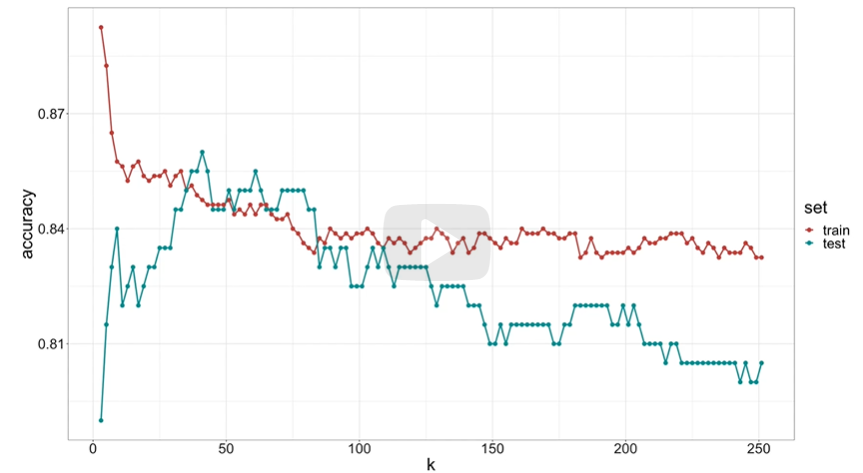

## **Mathematical description of cross-validation**

When we have just one dataset, we can estimate the MSE using the observed MSE. The theoretical MSE is often referred to as the true error, and the observed MSE as the apparent error.

There are two important characteristics of the apparent error to keep in mind. First, the apparent error is a random variable. Second, if we train an algorithm on the same dataset we use the compute the apparent error, we might be overtraining. In these cases, the apparent error will be an underestimate of the true error. Cross-validation helps to alleviate both of these problems.

Cross-validation helps imitate the theoretical set up of the true error as best as possible using the data we have. To do this, cross-validation randomly generates smaller datasets that are used to estimate the true error.

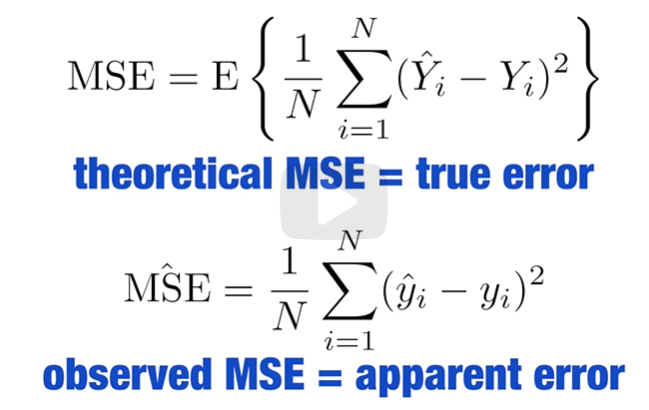

## **k-fold cross validation**



To imitate an independent dataset, we divide the dataset into a training set and a test set. The training set is used for training our algorithms and the test set is used exclusively for evaluation purposes. Typically 10-20% of the data is set aside for testing.

We need to optimize algorithm parameters without using the test set, but if we optimize and evaluate on the same dataset we will overtrain. This is where cross-validation is useful.

To calculate MSE, we want to create several datasets that can be thought of as independent random samples. With k-fold cross-validation, we randomly split the data into k non-overlapping sets. We obtain k estimates of the MSE and then compute the average as a final estimate of our loss. Finally, we can pick the parameters that minimize this estimate of the MSE.

For a final evaluation of our algorithm, we often just use the test set.
In terms of picking k for cross-validation, larger values of  are preferable but they will also take much more computational time. For this reason, the choices of 5 and 10 are common.

One way to improve the variance of our final estimate is to take more samples. We can do this by no longer requiring non-overlapping sets. The bootstrap can be thought of as a variation at which each fold observations are picked at random with replacement. This is the default approach of caret::train.

Example: k = 5

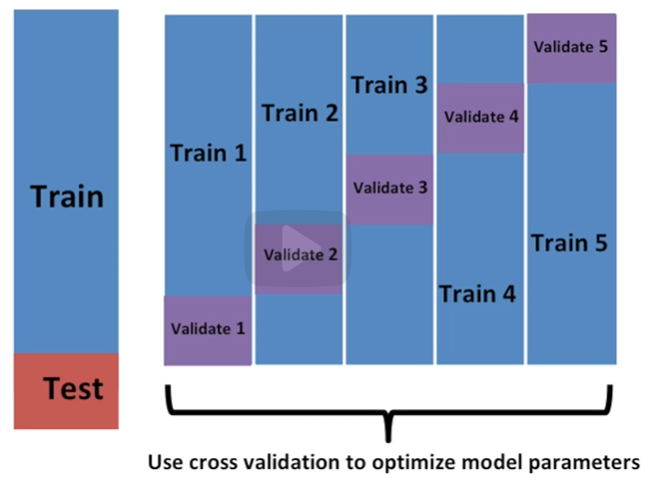

The first version of cross-validation
we describe is k-fold cross-validation.
Generally speaking, a machine learning challenge starts with a data set.
We need to build an algorithm using this data set that will eventually be used
in completely independent data sets.
But we don't get to see these independent data sets, so to imitate
this situation, we carve out a piece of our data set
and pretend it is an independent data set.
We divide a data set into a training set and a test set.
We will train our algorithm exclusively on the training set
and use the test set only for evaluation purposes.
We usually try to select a small piece of the data set so that we
have as much data as possible to train.
However, you also want the test set to be large
enough so that we obtain a stable estimate of the loss
without fitting an impractical number of models.
Typical choices are to use 10% to 20% of the data for testing.
Let's reiterate that it is indispensable that we not use the test set at all--
not for filtering out rows, not for selecting features, nothing.
Now, this presents a new problem because for most machine learning algorithms,
we need to select parameters-- for example, the number of neighbors k
and k-nearest neighbors.
Here, to follow what you see in books, we
will refer to the set of parameters as lambda.
Now, we need to optimize algorithm parameters without using our test set,
and we know that if we optimize and evaluate on the same data set,
we will over-train.
This is where cross-validation is most useful.
For each set of algorithm parameters being considered,
we want an estimate of the MSE.
And then, we will choose the parameters that minimizes estimate of the MSE.
Cross-validation provides this estimate.
First, before we start the cross-validation procedure,
it is important to fix all the algorithm parameters.
Although we will train the algorithm on the set of training sets,
the parameter lambda will be the same across all training sets.
We will use y i hat lambda to denote the predictors obtained
when we use the parameter lambda.
So if we're going to imitate this definition of MSE,
we want to consider data sets that can be
thought of as an independent random sample,
and we want to do this several times.
With k fold cross-validation, we do it k times.
Here, we're showing an example that uses k equals 5.
We will eventually end up with k samples,
but let's start by describing how we construct the first.
We simply pick M equals to N divided by K observations at random.
We'll round M if it's not round.
And think of these as a random sample: y 1 b all the way up to y M b with b
equals to 1.
This is the first one.
We call this the validation set.
Now, we can fit the model in the training
set then compute the apparent error on the independent set.
This is the formula.
Note that this is just one sample and will therefore return
a noisy estimate of the true error.
This is why we take k samples, not just one.
In k cross-validation, we randomly split the observations
into k non-overlapping sets.

Now, we repeat the calculation that we just did for each of these sets, b,
going one through k, and we obtain k estimates of the MSE.
Then, for our final estimate, we compute the average given by this formula,
and this gives us an estimate of our loss.
Our final step would be to select the lambda that the minimizes the MSE.
We have described how to use cross-validation to optimize
parameters.
However, we now have to take into account
the fact that the optimization occurred on the training data,
and therefore, we need an estimate for our final algorithm
based on data that was not used to optimize the choice.
Here is where we used the test set we separated early on.
We can do cross-validation again, if we want,
and obtain a final estimate of our expected loss.
However, note that this means that our entire compute time gets
multiplied by k.
You will learn that performing this task takes time because we're
performing many complex computations.
As a result, we're always looking for ways to reduce this time.
Therefore, for the final evaluation, we often just use the one test set.
Once we're satisfied with this model and want to make it available to others,
we could refit the model on the entire data set without changing
the optimization parameters.
Now, how do we pick the number of folds k for our cross-validation?
Large values of k are preferable because the training data better estimates
the original data set.
However, larger values of k will have much lower computation time.
For example, 100-fold cross validation will be 10 times slower
than 10-fold cross-validation.
For this reason, the choices of k equals 5 or 10 are popular.
Now, one way we can improve the variance of our final estimate
is to take more samples.
One way to do this is to no longer require
the training set to be partitioned into known overlapping sets.
Instead, we would just pick case sets of some size at random.
One popular version of this technique-- at each fold, peaks observations
at random with replacement, which means the same observations can appear twice.
This approach has some advantages that we're not going to discuss here,
and it is generally referred to as the bootstrap.
In fact, this is the default approach of the caret package.
We'll describe how to implement cross-validation
with the caret package in a later video.

## **Bootstrap**

Bootstrapping allows us to approximate a Monte Carlo simulation without access to the entire distribution. We act as if the observed sample is the population. Next, we sample datasets (with replacement) of the same sample size as the original dataset. Finally, we compute the summary statistic, in this case the median, on these bootstrap samples.

Suppose the income distribution of your population is as follows:

In [ ]:
# define the population distribution of income
set.seed(1995)
n <- 10^6
income <- 10^(rnorm(n, log10(45000), log10(3)))
qplot(log10(income), bins = 30, color = I("black"))

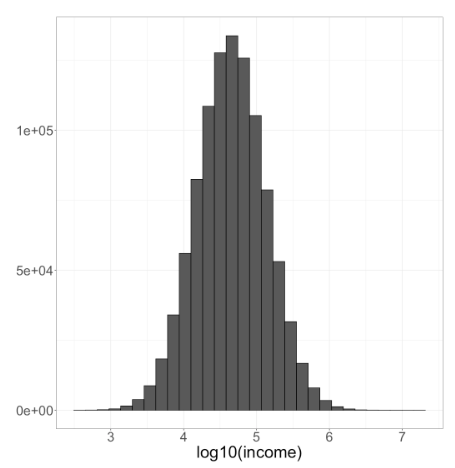

The population median is given by the following code:

In [ ]:
# calculate the population median
m <- median(income)

The population median is 44939.

However, if we don't have access to the entire population but want to estimate the median, we can take a sample of 100 and estimate the population median m  using the sample median M, like this:

In [ ]:
# estimate the population median
N <- 100
X <- sample(income, N)
median(X)

The sample median here is 38461.

Now let's consider constructing a confidence interval and determining the distribution of M.

Because we are simulating the data, we can use a Monte Carlo simulation to learn the distribution of M using the following code:

In [ ]:
# use a Monte Carlo simulation to learn the distribution of M
library(gridExtra)
B <- 10^4
M <- replicate(B, {
  X <- sample(income, N)
  median(X)
})
p1 <- qplot(M, bins = 30, color = I("black"))
p2 <- qplot(sample = scale(M), xlab = "theoretical", ylab = "sample") +
  geom_abline()
grid.arrange(p1, p2, ncol = 2)

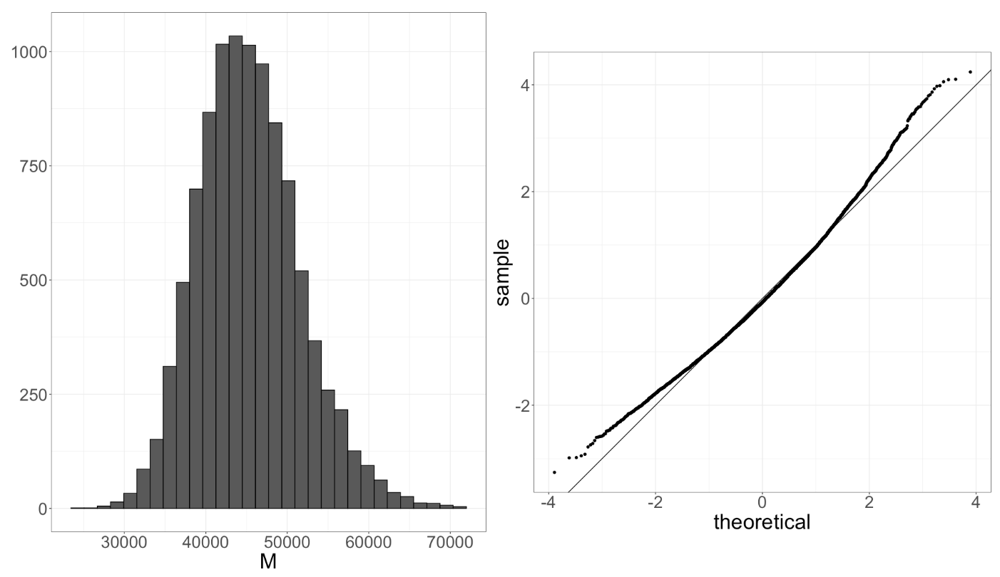

Knowing the distribution allows us to construct a confidence interval. However, as we have discussed before, in practice, we do not have access to the distribution. In the past, we have used the Central Limit Theorem (CLT), but the CLT we studied applies to averages and here we are interested in the median. If we construct the 95% confidence interval based on the CLT using the code below, we see that it is quite different from the confidence interval we would generate if we knew the actual distribution of M.

In [ ]:
# compare the 95% CI based on the CLT to the actual one
median(X) + 1.96 * sd(X) / sqrt(N) * c(-1, 1)

The 95% confidence interval based on the CLT is (21017, 55904).

In [ ]:
quantile(M, c(0.025, 0.975))

The confidence interval based on the actual distribution of M is (34438, 59050).

The bootstrap permits us to approximate a Monte Carlo simulation without access to the entire distribution. The general idea is relatively simple. We act as if the observed sample is the population. We then sample (with replacement) datasets, of the same sample size as the original dataset. Then we compute the summary statistic, in this case the median, on these bootstrap samples.

Theory tells us that, in many situations, the distribution of the statistics obtained with bootstrap samples approximate the distribution of our actual statistic. We can construct bootstrap samples and an approximate distribution using the following code:

In [ ]:
# bootstrap and approximate the distribution
B <- 10^4
M_star <- replicate(B, {
  X_star <- sample(X, N, replace = TRUE)
  median(X_star)
})

The confidence interval constructed using the bootstrap is much closer to the one constructed with the theoretical distribution, as you can see by using this code:

In [ ]:
# look at the confidence interval from the bootstrap
quantile(M_star, c(0.025, 0.975))

The confidence interval from the bootstrap is (30253, 56909).

To learn more about the boostrap, including corrections one can apply to improve these confidence intervals, the book An introduction to the bootstrap by Efron and Tibshirani is a great resource.

Note that we can use ideas similar to those used in the bootstrap in cross-validation: instead of dividing the data into equal partitions, we can simply bootstrap many times.

## **Comprehension Check: Bootstrap**

Previously, sample(replace = TRUE) was used to perform bootstrap sampling. As an alternative, this assessment will use createResample from the caret package. Similar to createDataPartition, createResample outputs indexes. These indexes need to be used to obtain the actual samples.

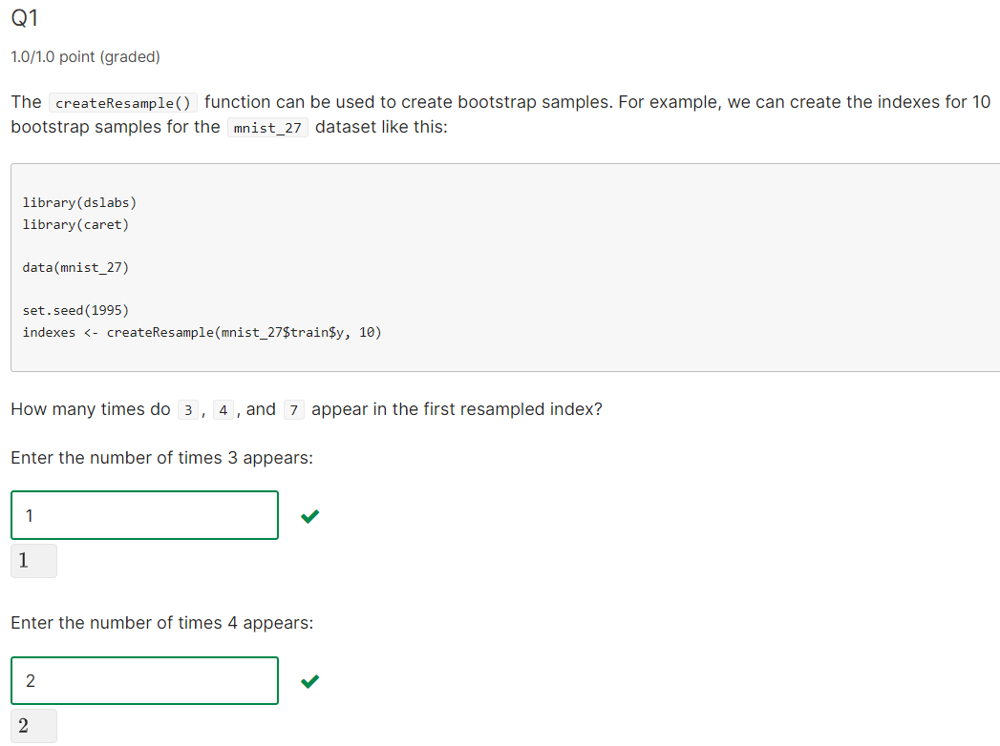

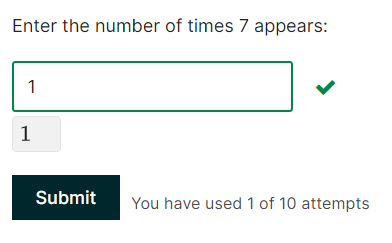

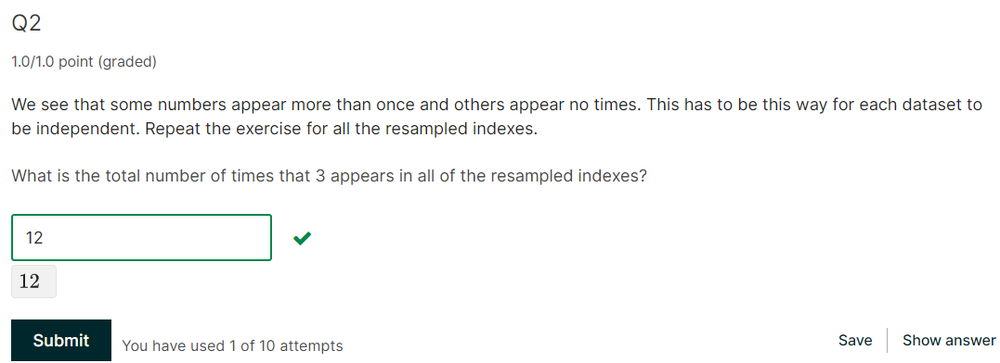

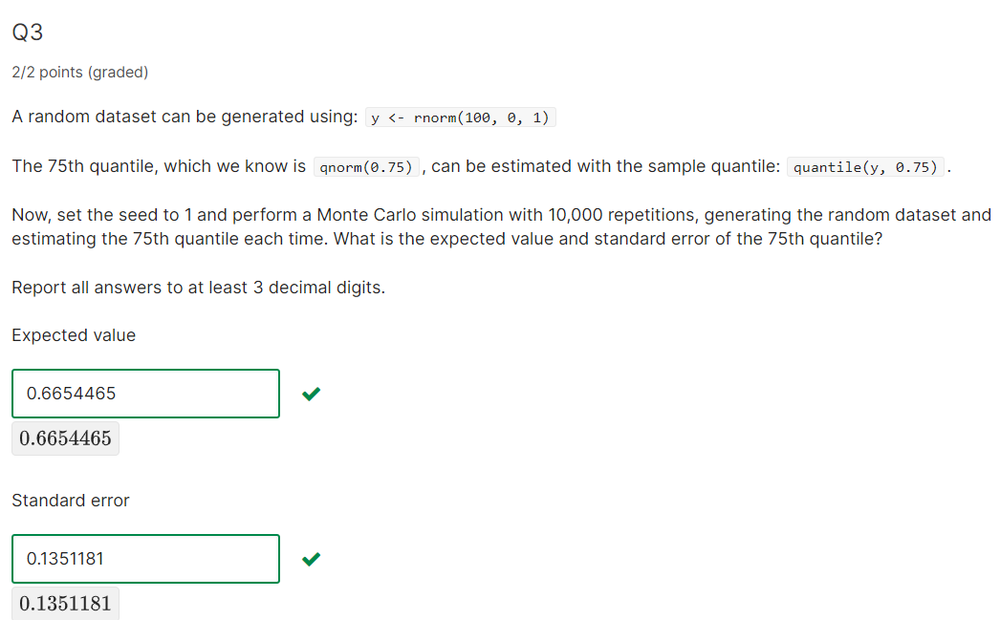

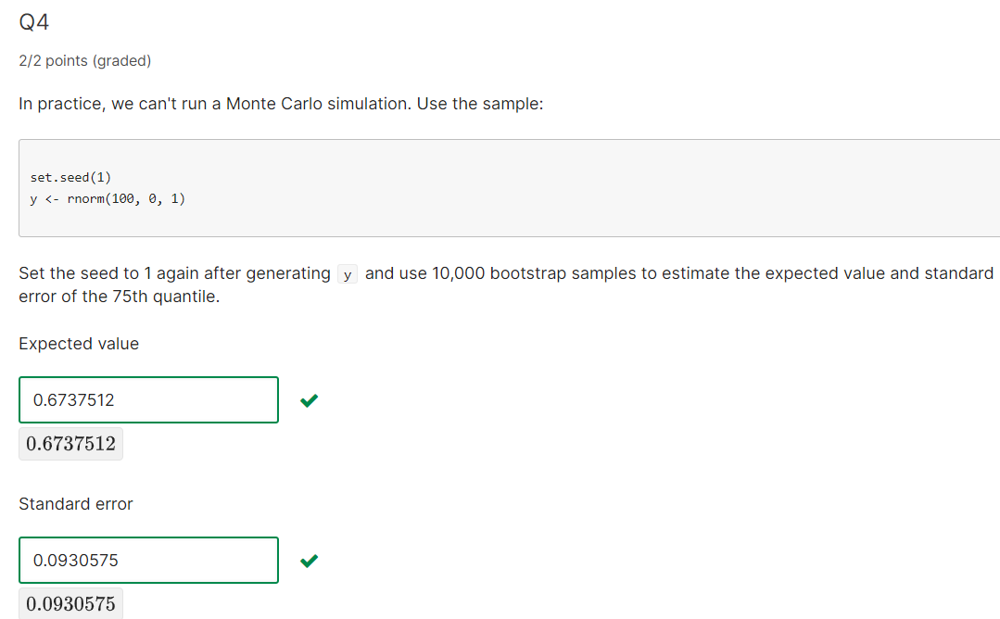

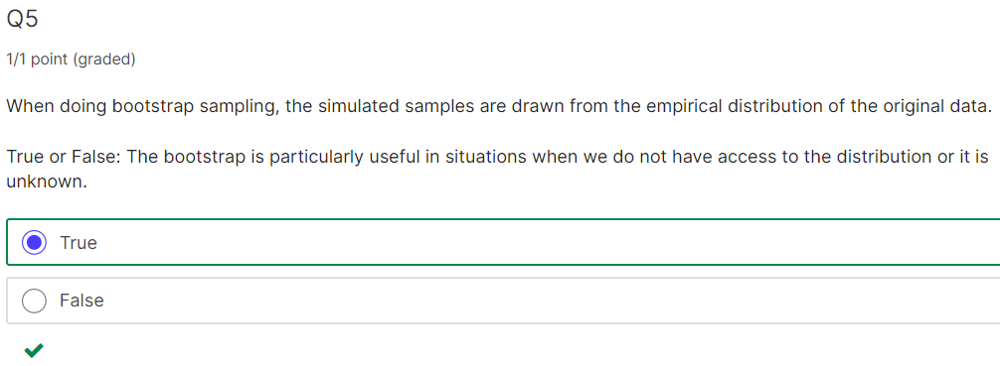

# **Section 5: The Caret Package**

In the Caret Package section, you will learn how to use the caret package to implement many different machine learning algorithms.

After completing this section, you will be able to:

- Use the caret package to implement a variety of machine learning algorithms, including kNN and Loess.
- Use classification (decision) trees.
- Apply random forests to address the shortcomings of decision trees.

Caret package links

http://topepo.github.io/caret/available-models.html

http://topepo.github.io/caret/train-models-by-tag.html



The caret package helps provides a uniform interface and standardized syntax for the many different machine learning packages in R. Note that caret does not automatically install the packages needed.

The train() function automatically uses cross-validation to decide among a few default values of a tuning parameter.

The getModelInfo() and modelLookup() functions can be used to learn more about a model and the parameters that can be optimized.

We can use the tunegrid() parameter in the train() function to select a grid of values to be compared.

The trControl parameter and trainControl() function can be used to change the way cross-validation is performed.

Note that not all parameters in machine learning algorithms are tuned. We use the train() function to only optimize parameters that are tunable.

In [ ]:
library(tidyverse)
library(dslabs)
data("mnist_27")

library(caret)
train_glm <- train(y ~ ., method = "glm", data = mnist_27$train)
train_knn <- train(y ~ ., method = "knn", data = mnist_27$train)

y_hat_glm <- predict(train_glm, mnist_27$test, type = "raw")
y_hat_knn <- predict(train_knn, mnist_27$test, type = "raw")

confusionMatrix(y_hat_glm, mnist_27$test$y)$overall[["Accuracy"]]
# output: 0.75

confusionMatrix(y_hat_knn, mnist_27$test$y)$overall[["Accuracy"]]
# output: 0.84

getModelInfo("knn")
modelLookup("knn")

ggplot(train_knn, highlight = TRUE)

data.frame(k = seq(9, 67, 2))
# fitting 30 versions of KNN to 25 bootstrap samples. Since we're filling 30 times 25, or 750, KNN models, running the following code which implements all this will take several seconds.

set.seed(2008)
train_knn <- train(y ~ ., method = "knn",
                   data = mnist_27$train,
                   tuneGrid = data.frame(k = seq(9, 71, 2)))

ggplot(train_knn, highlight = TRUE)

train_knn$bestTune
train_knn$finalModel

confusionMatrix(predict(train_knn, mnist_27$test, type = "raw"),
                mnist_27$test$y)$overall["Accuracy"]
# output: Accuracy = 0.835

control <- trainControl(method = "cv", number = 10, p = .9)
train_knn_cv <- train(y ~ ., method = "knn",
                      data = mnist_27$train,
                      tuneGrid = data.frame(k = seq(9, 71, 2)),
                      trControl = control)
ggplot(train_knn_cv, highlight = TRUE)

names(train_knn_cv$results)

plot_cond_prob <- function(p_hat=NULL){
     tmp <- mnist_27$true_p
     if(!is.null(p_hat)){
          tmp <- mutate(tmp, p=p_hat)
     }
     tmp %>% ggplot(aes(x_1, x_2, z=p, fill=p)) +
     geom_raster(show.legend = FALSE) +
          scale_fill_gradientn(colors=c("#F8766D","white","#00BFC4")) +
          stat_contour(breaks=c(0.5),color="black")
}

plot_cond_prob(predict(train_knn, mnist_27$true_p, type = "prob")[,2])

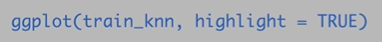

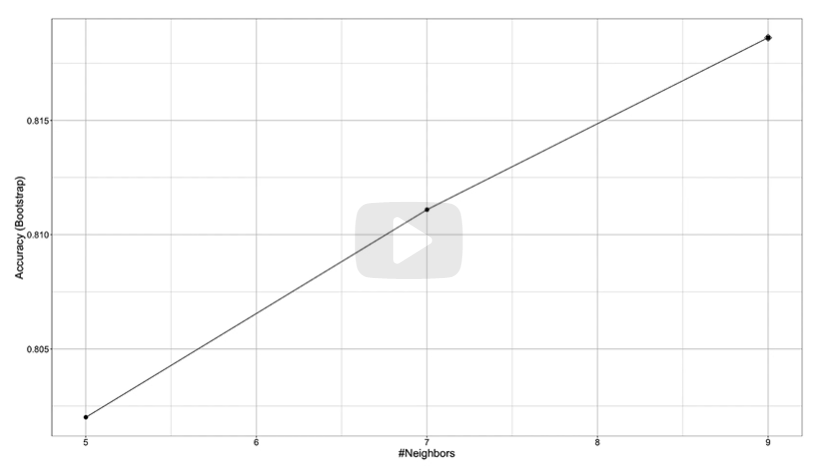



set.seed(2008)
train_knn <- train(y ~ ., method = "knn",
                   data = mnist_27$train,
                   tuneGrid = data.frame(k = seq(9, 71, 2)))

ggplot(train_knn, highlight = TRUE)


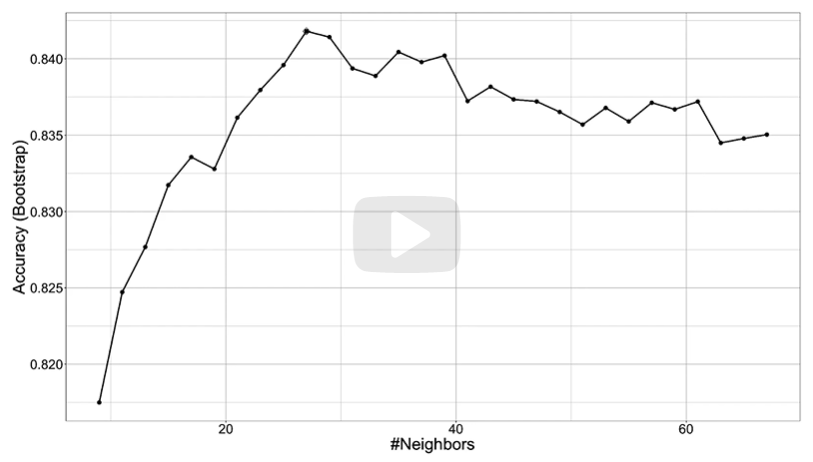

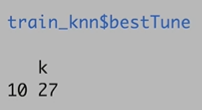

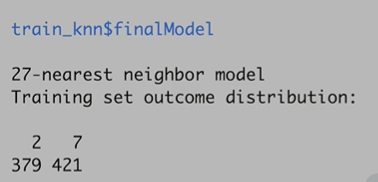


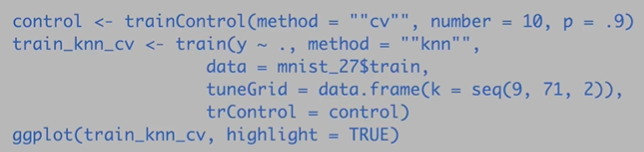

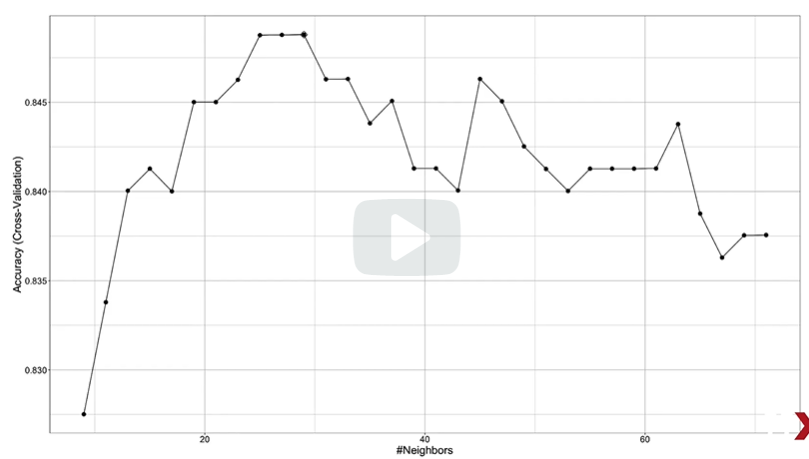

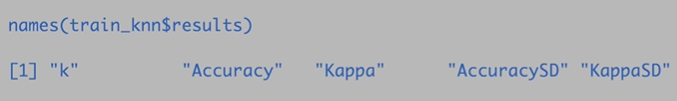

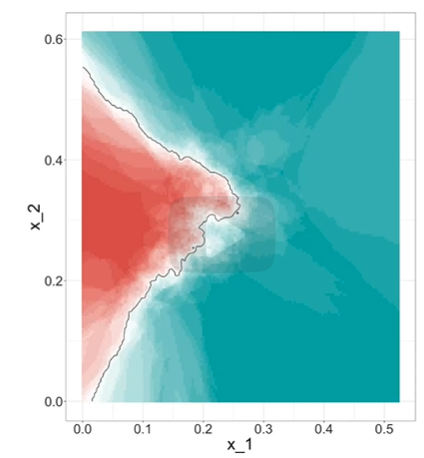

Now, let's look at the best fitting kNN model.
The best fitting kNN model approximates the true conditional probability.
However, we do see that the boundary is somewhat wiggly.
This is because kNN, like the basic bin smoother, does not use a kernel.
To improve this, we could use another algorithm called loess.

## **Fitting with Loess**

The "gam" package allows us to fit a model using the gamLoess method in caret. This method produces a smoother estimate of the conditional probability than kNN.


In [ ]:
install.packages("gam")
modelLookup("gamLoess")

grid <- expand.grid(span = seq(0.15, 0.65, len = 10), degree = 1)

train_loess <- train(y ~ .,
               method = "gamLoess",
               tuneGrid=grid,
               data = mnist_27$train)
ggplot(train_loess, highlight = TRUE)

confusionMatrix(data = predict(train_loess, mnist_27$test),
                reference = mnist_27$test$y)$overall["Accuracy"]
# output: Accuracy = 0.845

p1 <- plot_cond_prob(predict(train_loess, mnist_27$true_p, type = "prob")[,2])
p1

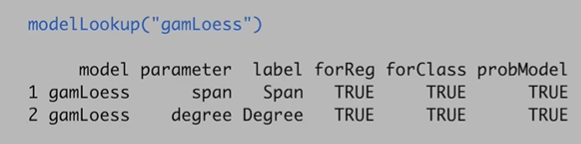

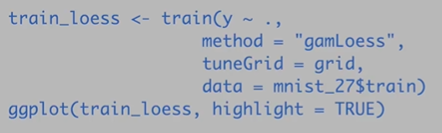

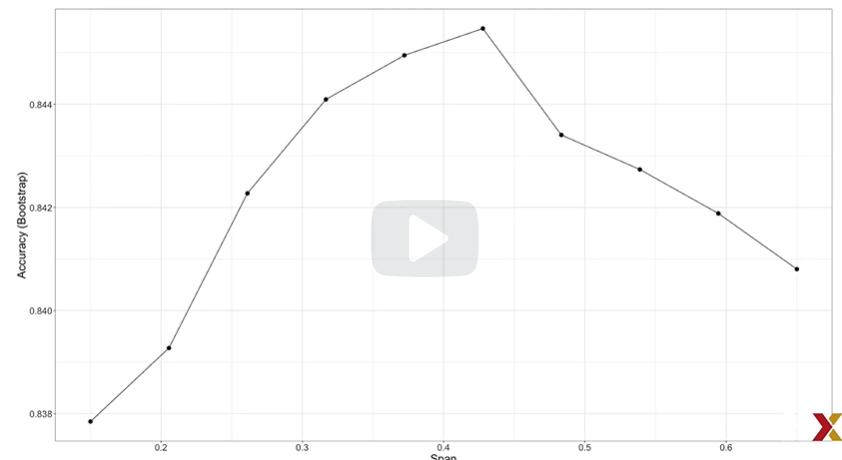

In [ ]:
p1 <- plot_cond_prob(predict(train_loess, mnist_27$true_p, type = "prob")[,2])
p1

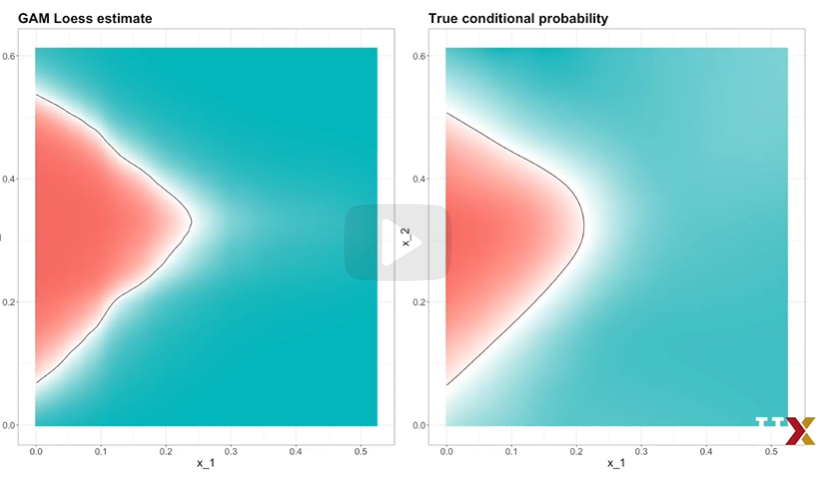

## **Comprehension Check: Cross-validation**

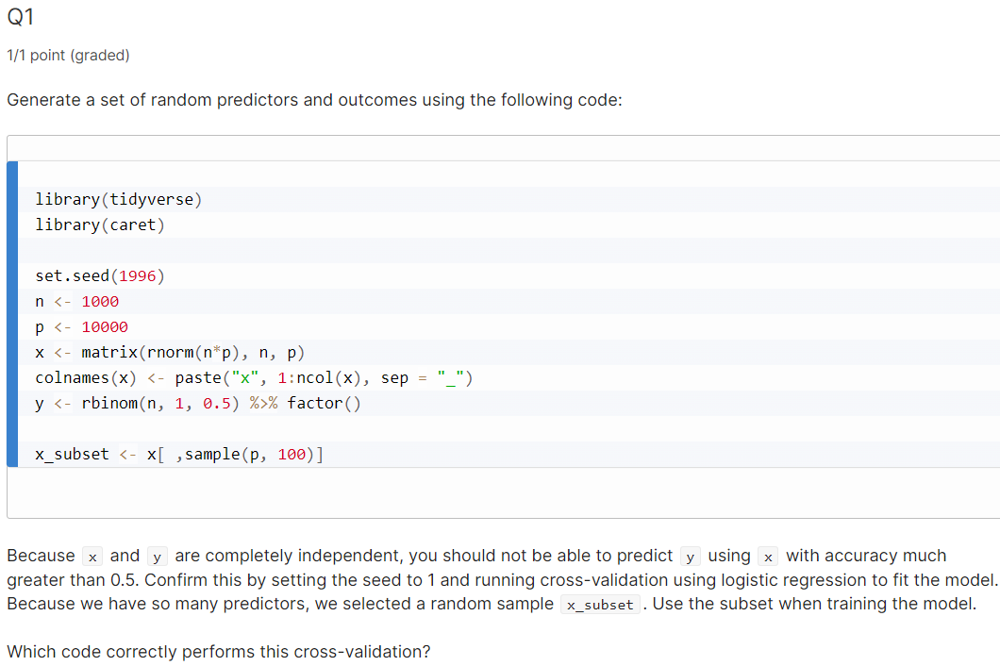

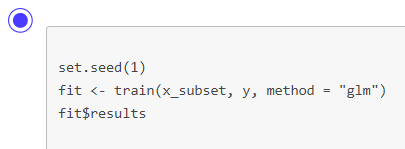

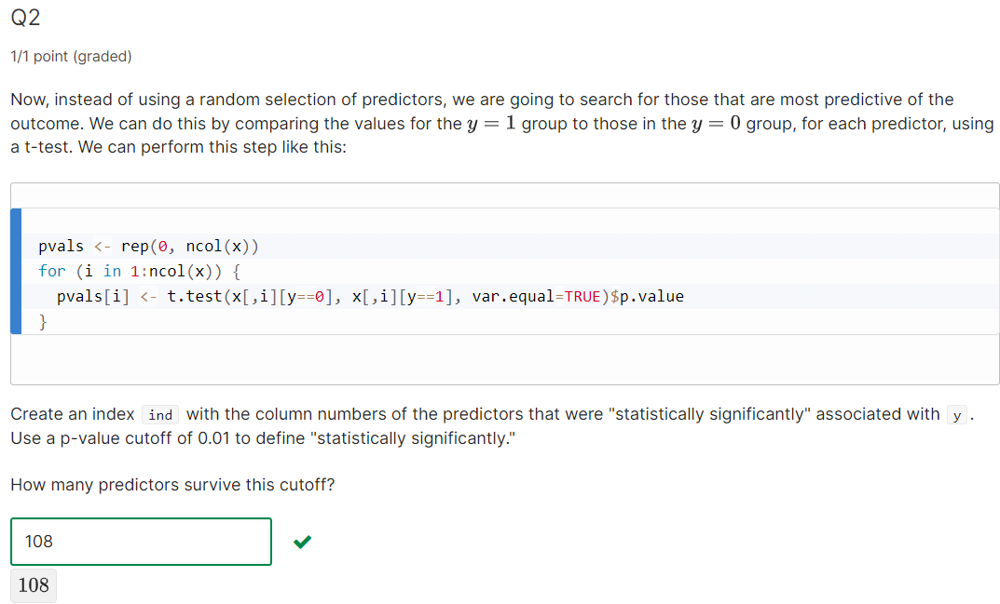

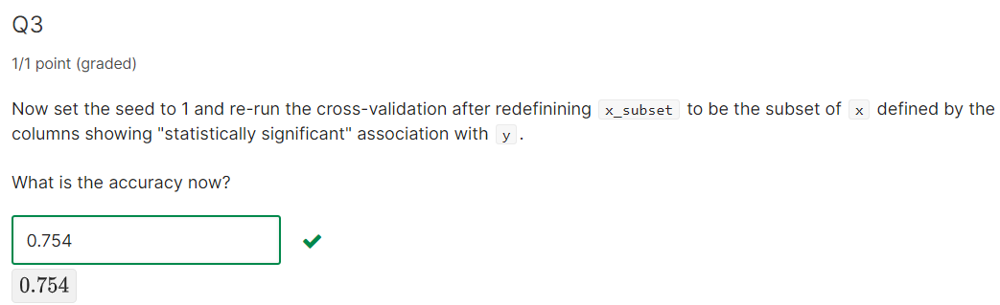

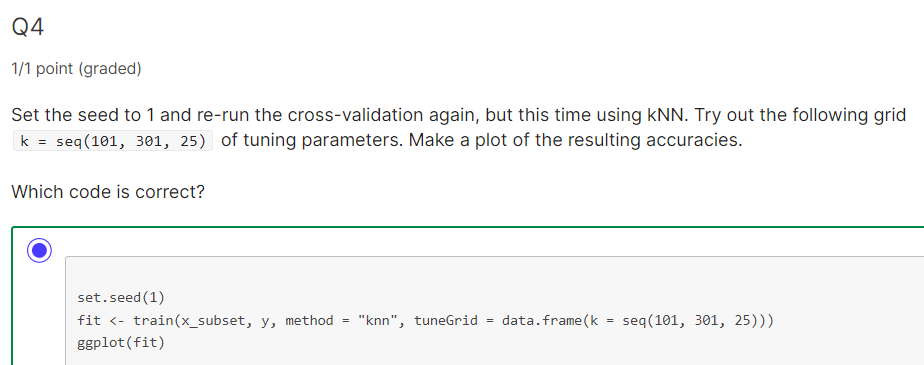

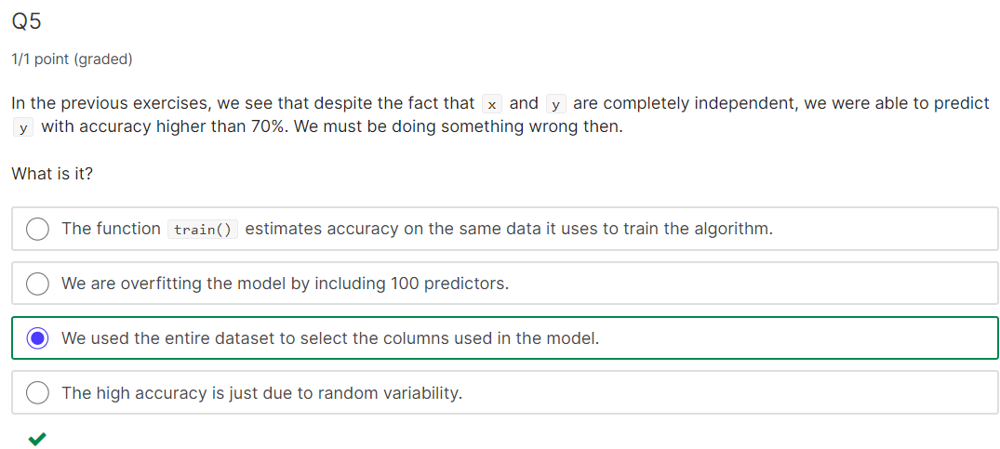

## **Trees and Random Forests**

**Introduction**

While we have explored machine learning algorithms such as kNN and Loess in the course thus far, tree-based methods such as classification and regression trees (CART) and random forest are other commonly-used machine learning methods you may encounter. Here, we present key points to introduce these methods along with a comprehension check to assess understanding of these methods.

**Key points**

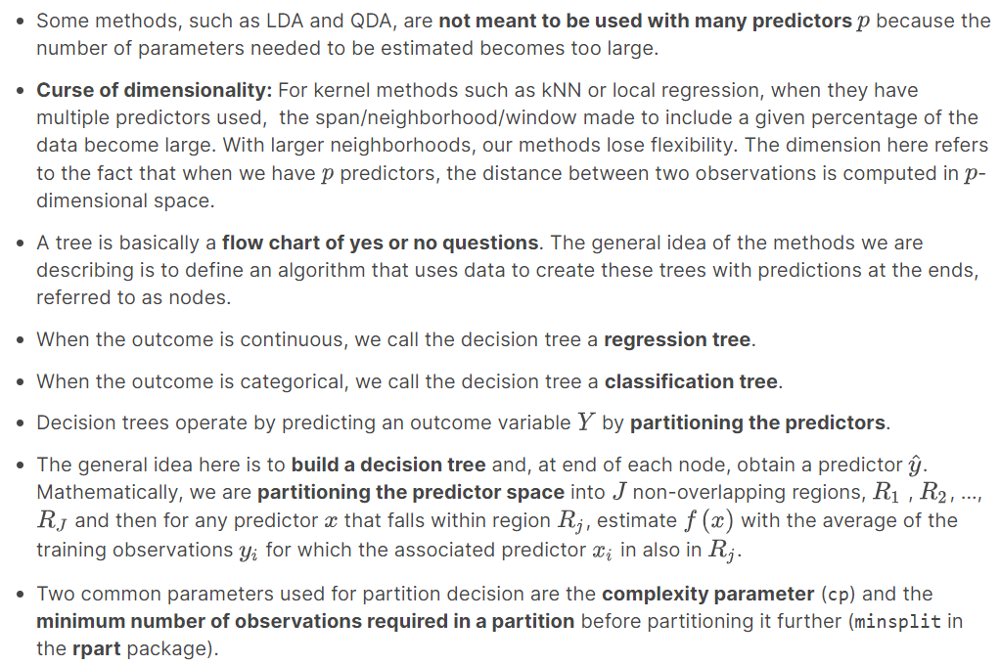

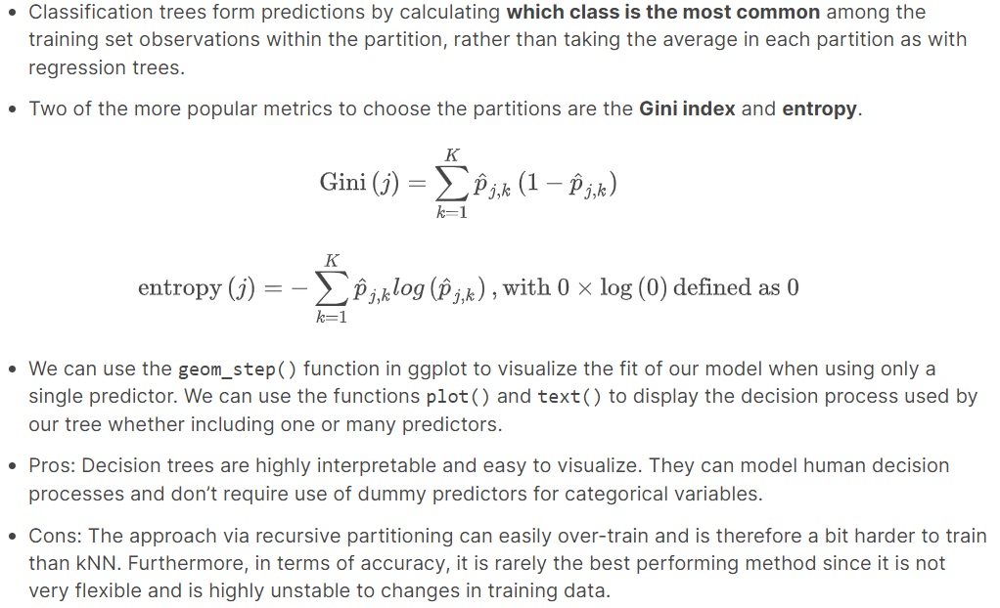

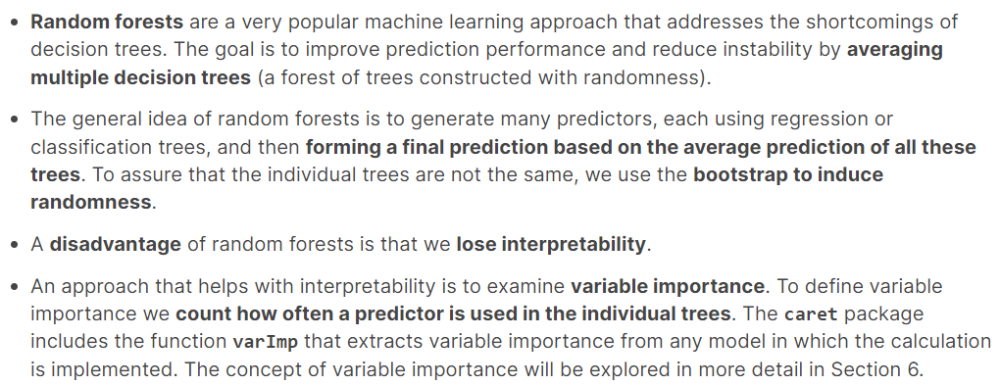

In [ ]:
# Load tidyverse
library(tidyverse)

# load package for decision tree
library(rpart)

# load the dslabs package
library(dslabs)

# fit a decision tree using the polls_2008 dataset,
# which contains only one predictor (day)
# and the outcome (margin)
fit <- rpart(margin ~ ., data = polls_2008)

# display the decision tree
plot(fit, margin = 0.1)
text(fit, cex = 0.75)

# examine the fit from the decision tree model
polls_2008 %>%
  mutate(y_hat = predict(fit)) %>%
  ggplot() +
  geom_point(aes(day, margin)) +
  geom_step(aes(day, y_hat), col="red")

# fit a decision tree on the mnist data using cross validation
train_rpart <- train(y ~ .,
              method = "rpart",
              tuneGrid = data.frame(cp = seq(0.0, 0.1, len = 25)),
              data = mnist_27$train)
# and plot it
plot(train_rpart)

# compute accuracy
confusionMatrix(predict(train_rpart, mnist_27$test), mnist_27$test$y)$overall["Accuracy"]

# view the final decision tree
plot(train_rpart$finalModel, margin = 0.1) # plot tree structure
text(train_rpart$finalModel) # add text labels

# load library for random forest
library(randomForest)
train_rf <- randomForest(y ~ ., data=mnist_27$train)
confusionMatrix(predict(train_rf, mnist_27$test), mnist_27$test$y)$overall["Accuracy"]

# use cross validation to choose parameter
train_rf_2 <- train(y ~ .,
      method = "Rborist",
      tuneGrid = data.frame(predFixed = 2, minNode = c(3, 50)),
      data = mnist_27$train)
confusionMatrix(predict(train_rf_2, mnist_27$test), mnist_27$test$y)$overall["Accuracy"]

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.4.2     ✔ purrr   1.0.1
✔ tibble  3.2.1     ✔ dplyr   1.1.1
✔ tidyr   1.3.0     ✔ stringr 1.4.1
✔ readr   2.1.4     ✔ forcats 1.0.0

── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()



ERROR: ignored

## **Comprehension Check: Trees and Random Forests**

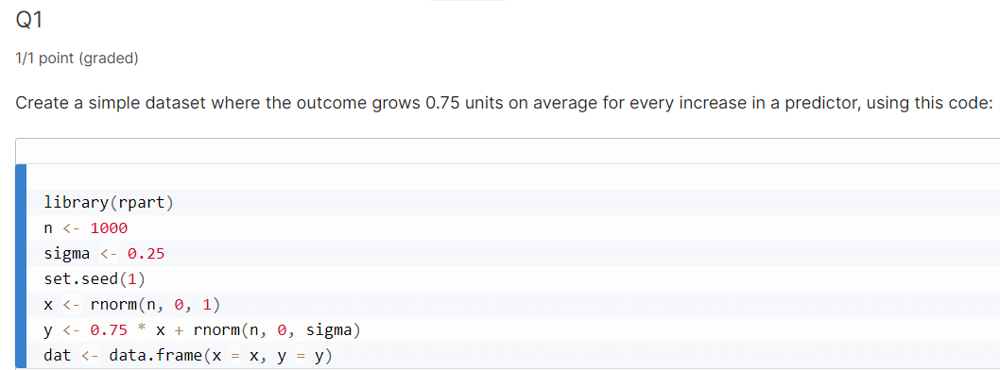

Which code correctly uses rpart() to fit a regression tree and saves the result to fit?

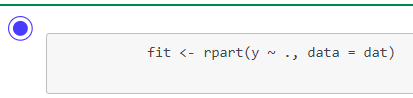

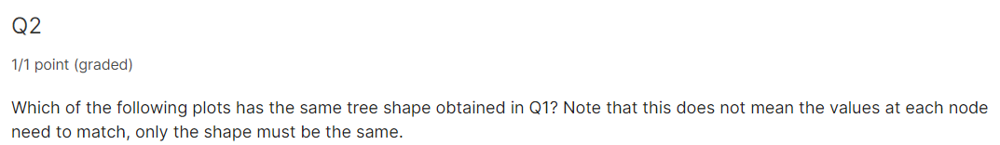

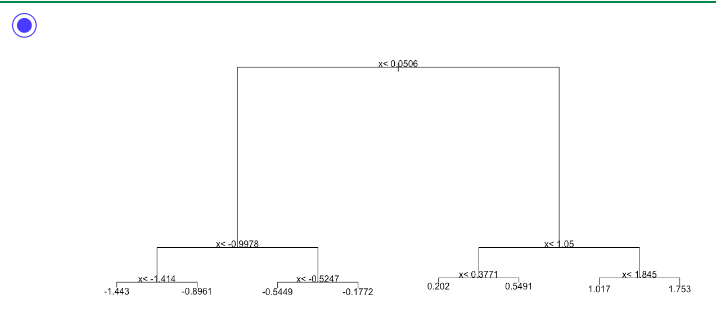

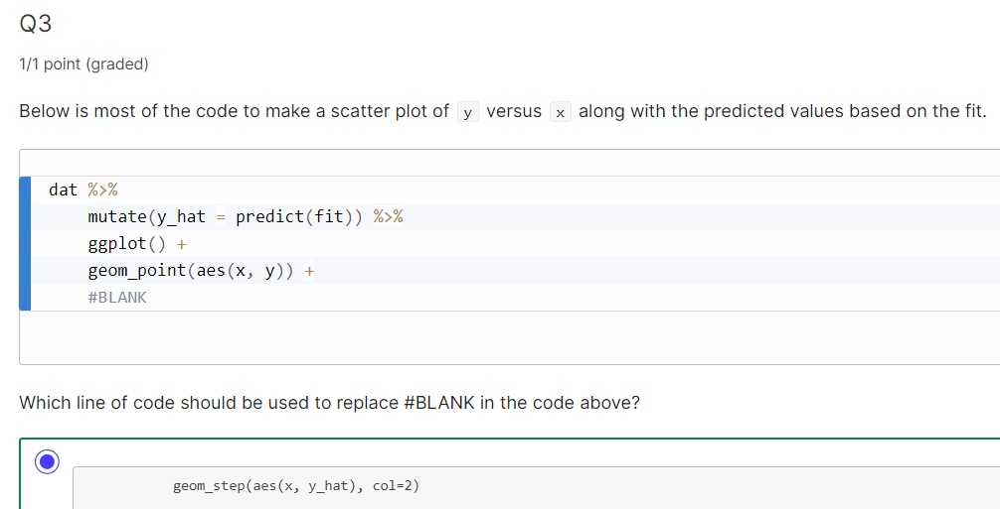

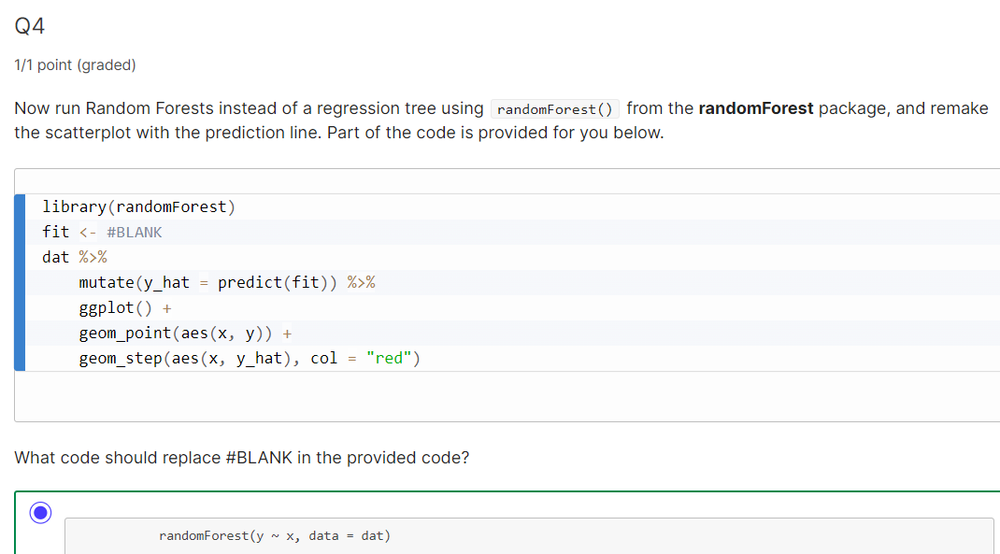

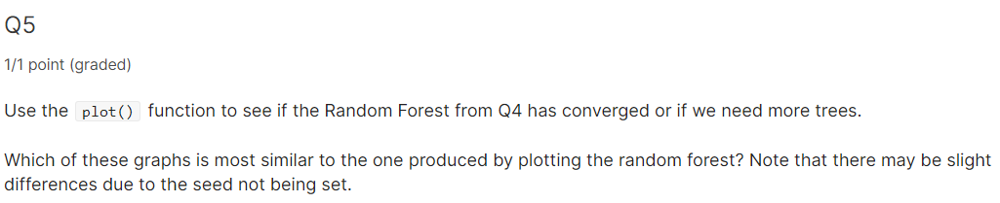

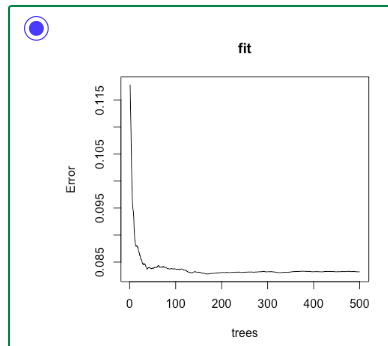

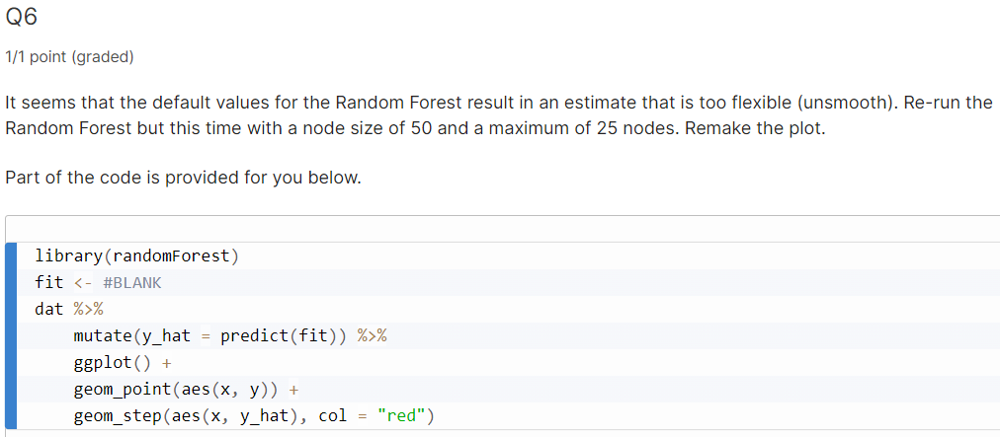

What code should replace #BLANK in the provided code?

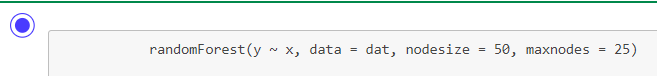


## **Comprehension Check: Caret Package**

These exercises take you through an analysis using the tissue_gene_expression dataset, which can be found in the "dslabs" packge.

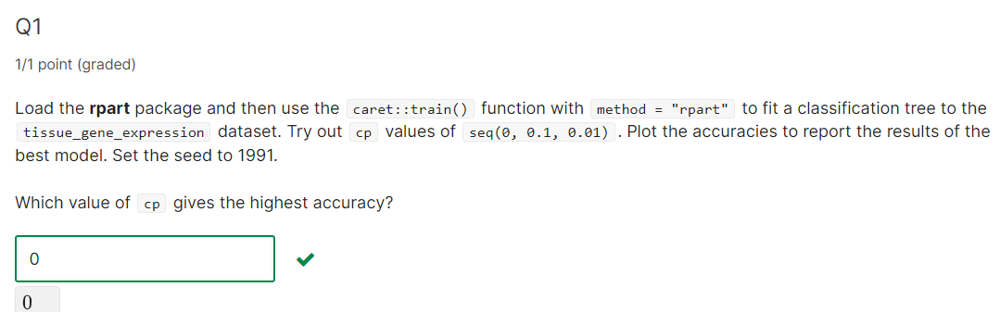

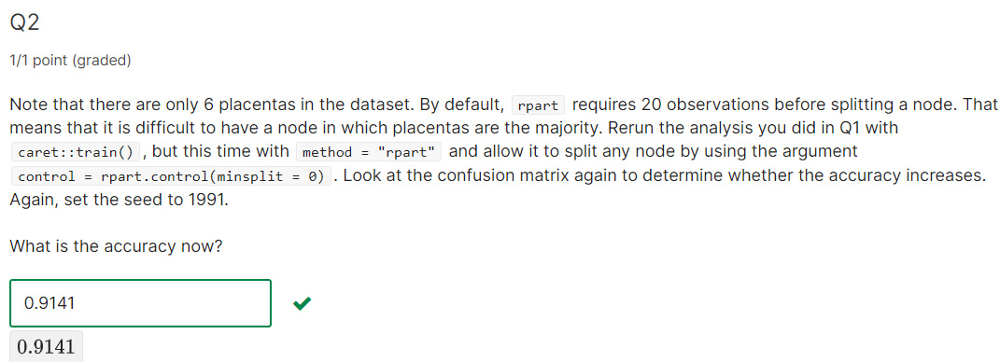

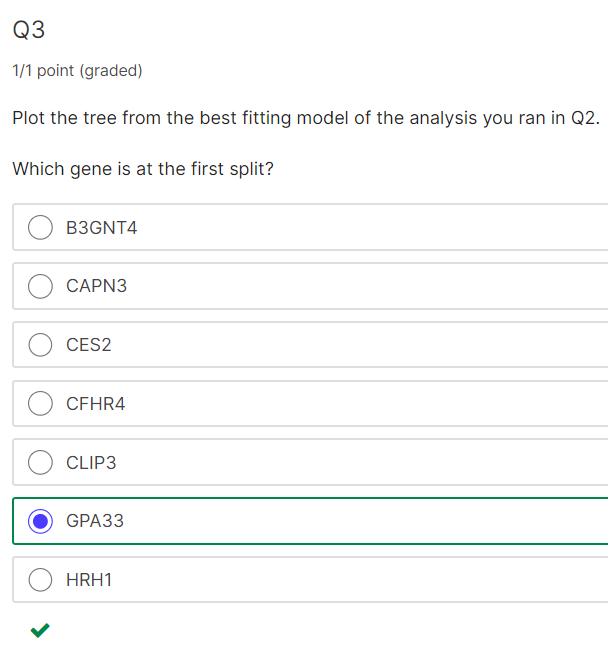

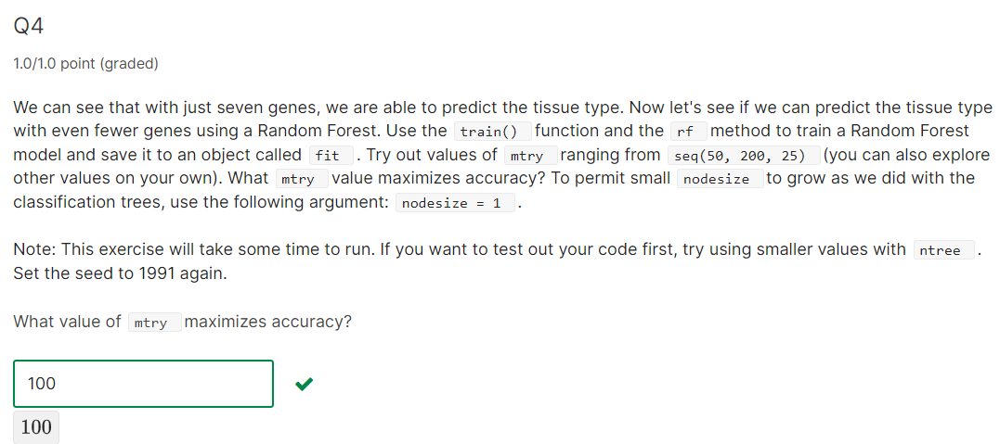

## **Titanic Exercise Part 1**

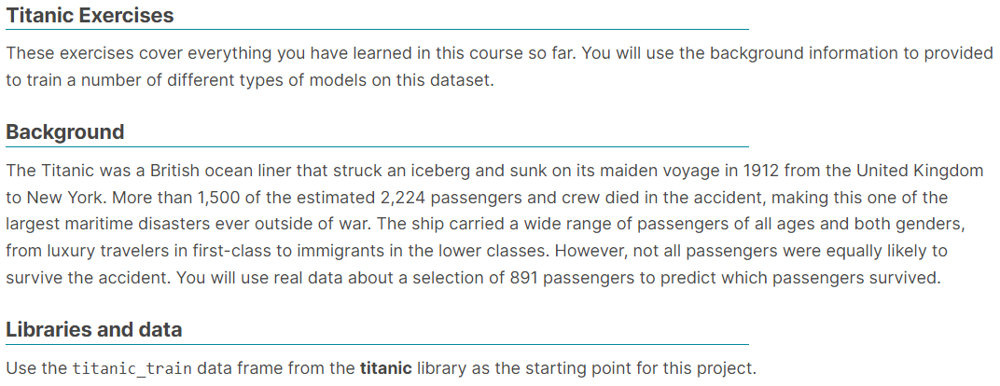

In [ ]:
library(titanic)    # loads titanic_train data frame
library(caret)
library(tidyverse)
library(rpart)

# 3 significant digits
options(digits = 3)

# clean the data - `titanic_train` is loaded with the titanic package
titanic_clean <- titanic_train %>%
    mutate(Survived = factor(Survived),
           Embarked = factor(Embarked),
           Age = ifelse(is.na(Age), median(Age, na.rm = TRUE), Age), # NA age to median age
           FamilySize = SibSp + Parch + 1) %>%    # count family members
    select(Survived,  Sex, Pclass, Age, Fare, SibSp, Parch, FamilySize, Embarked)

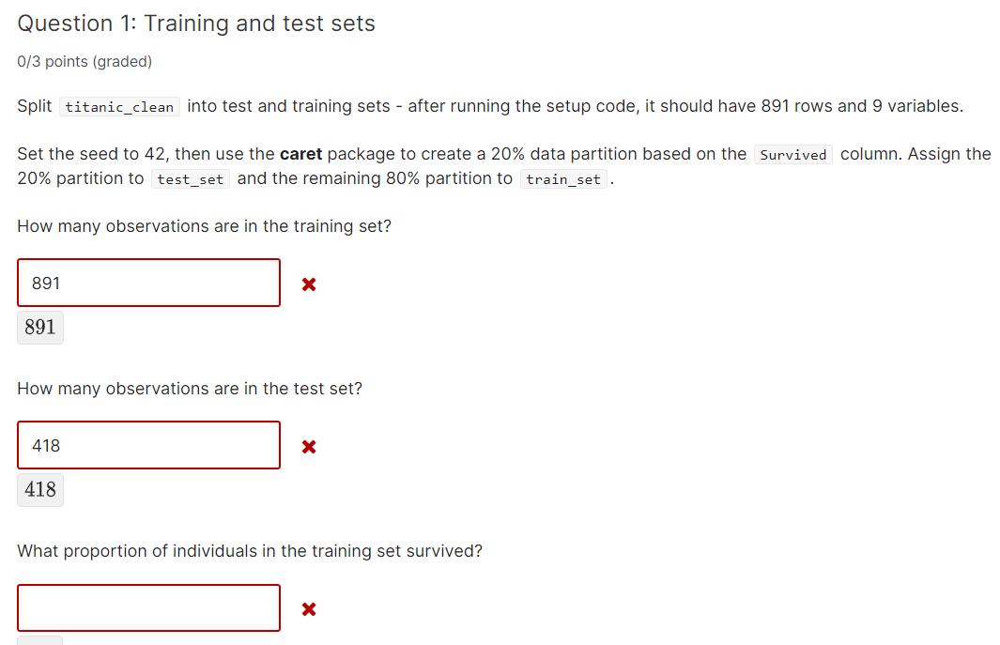

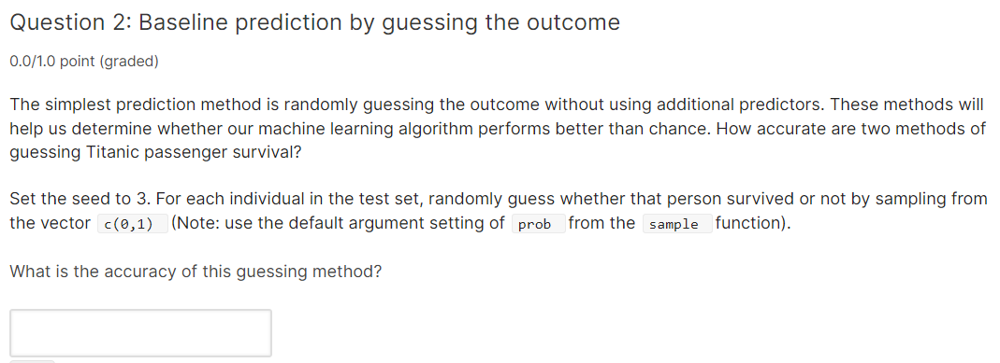

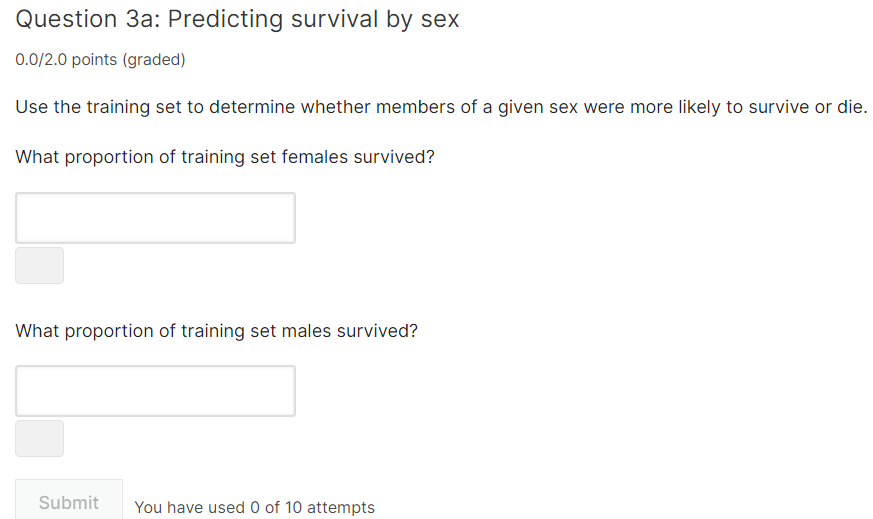

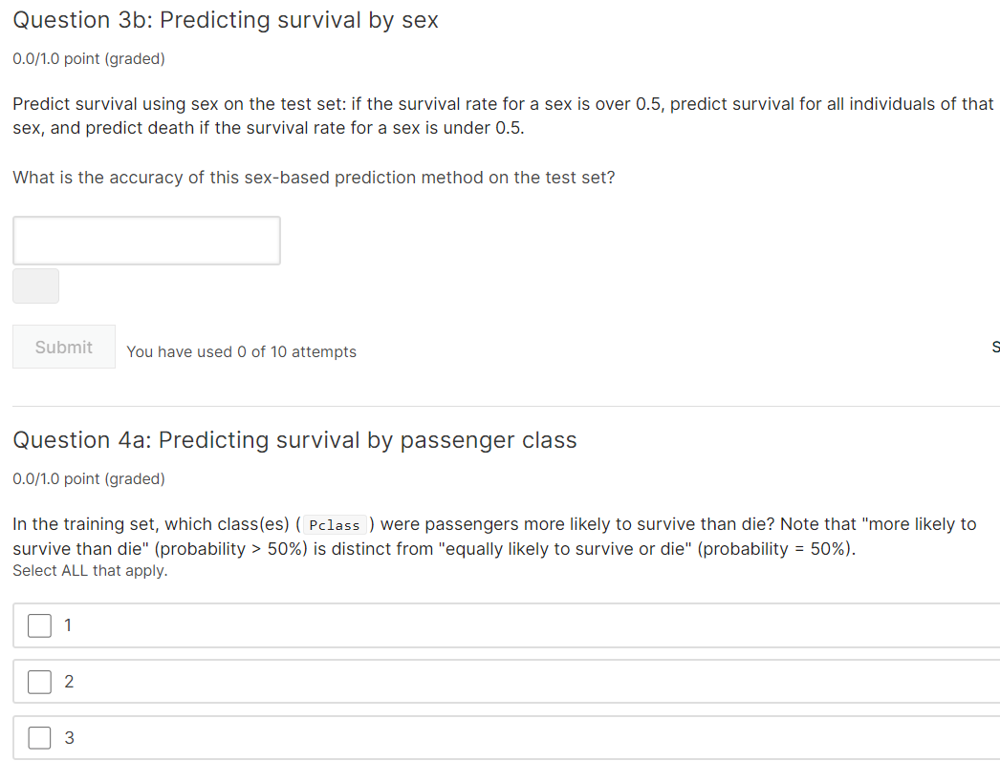

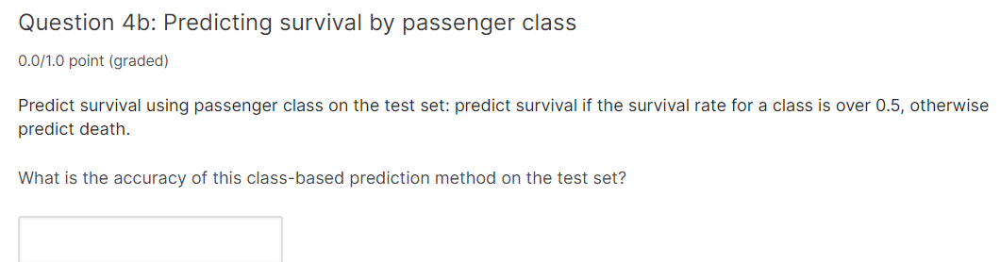

...

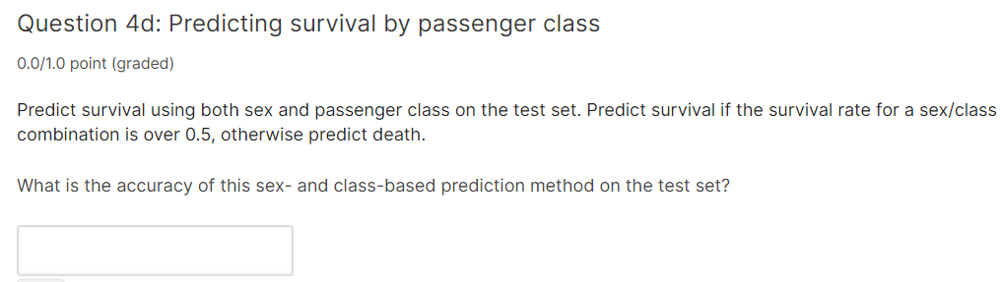

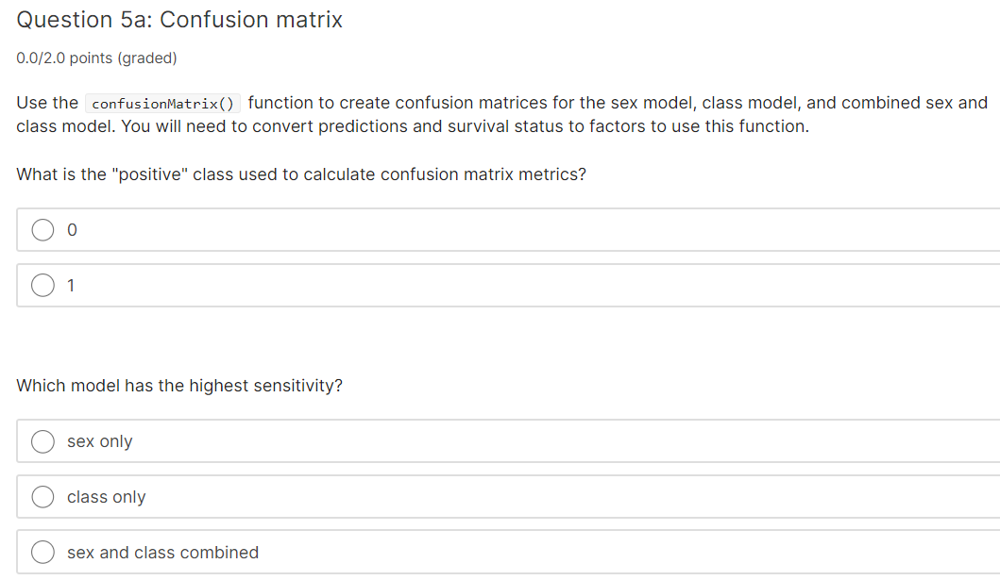

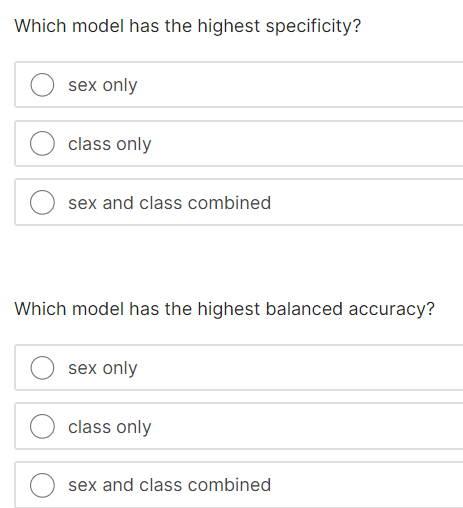

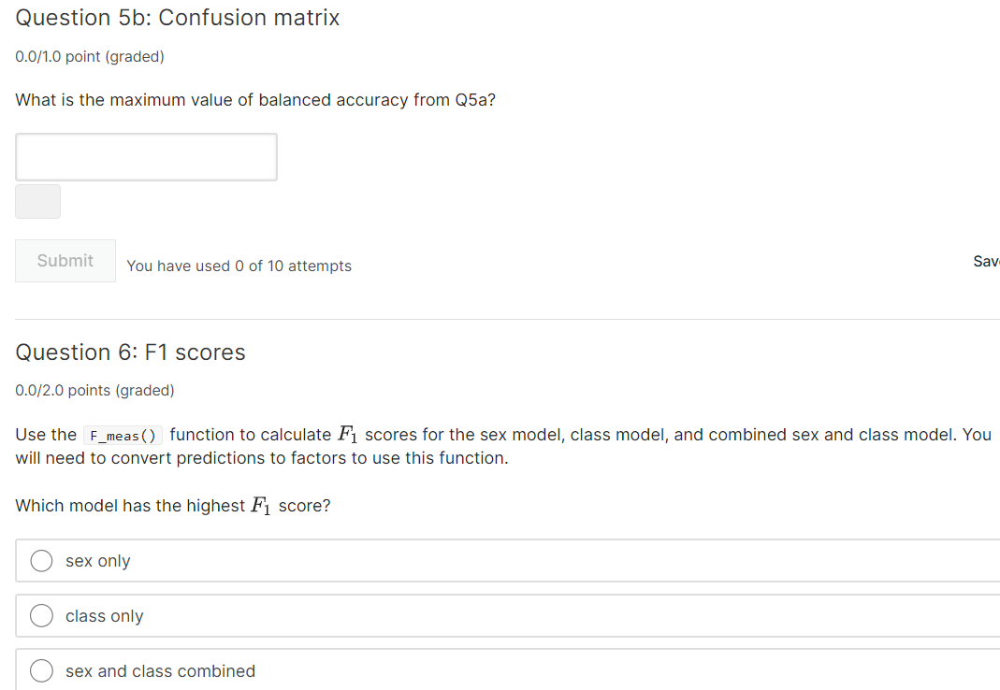

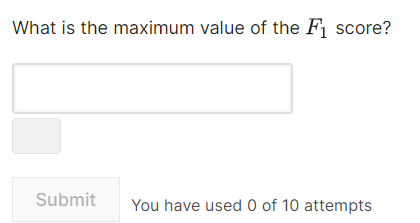

## **Titanic Exercise Part 2**

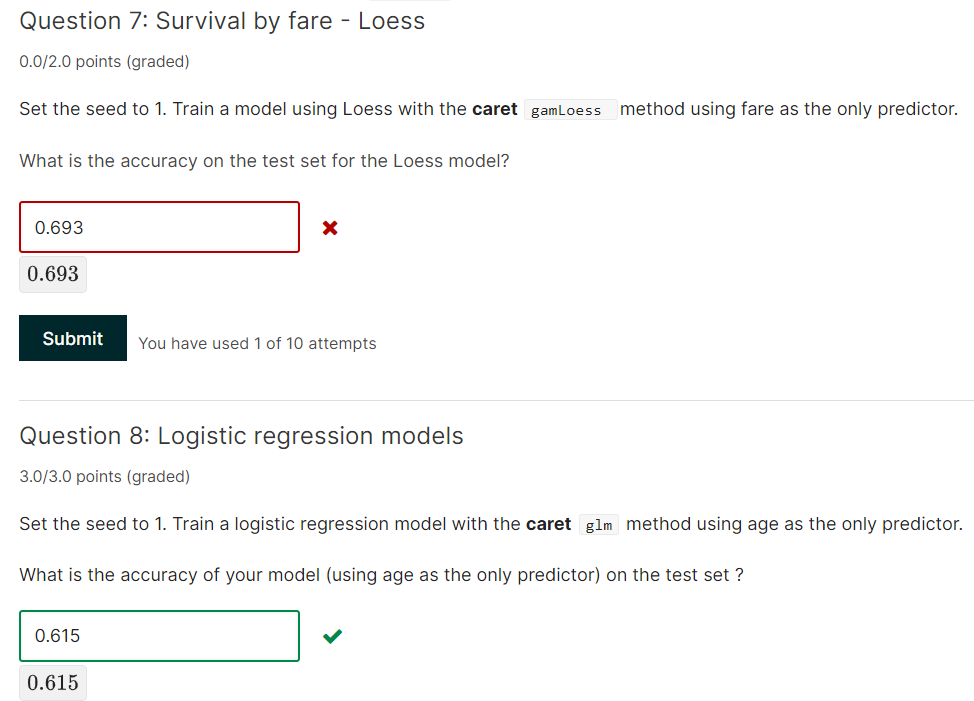

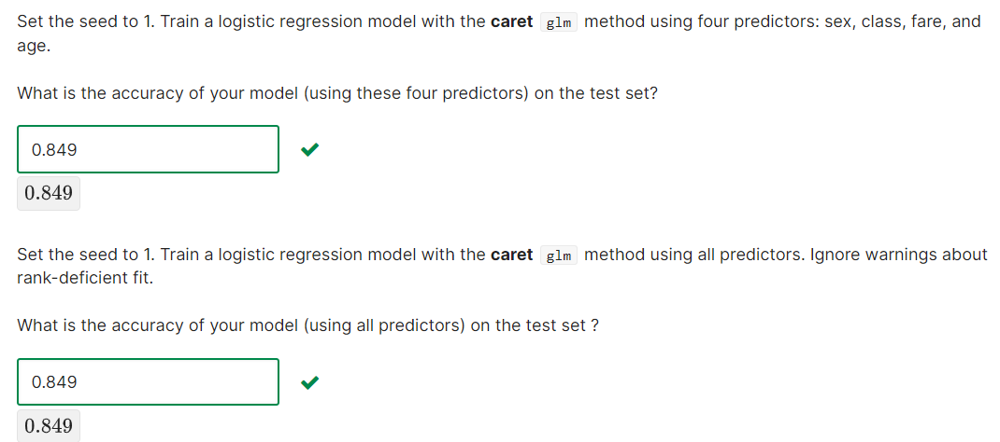

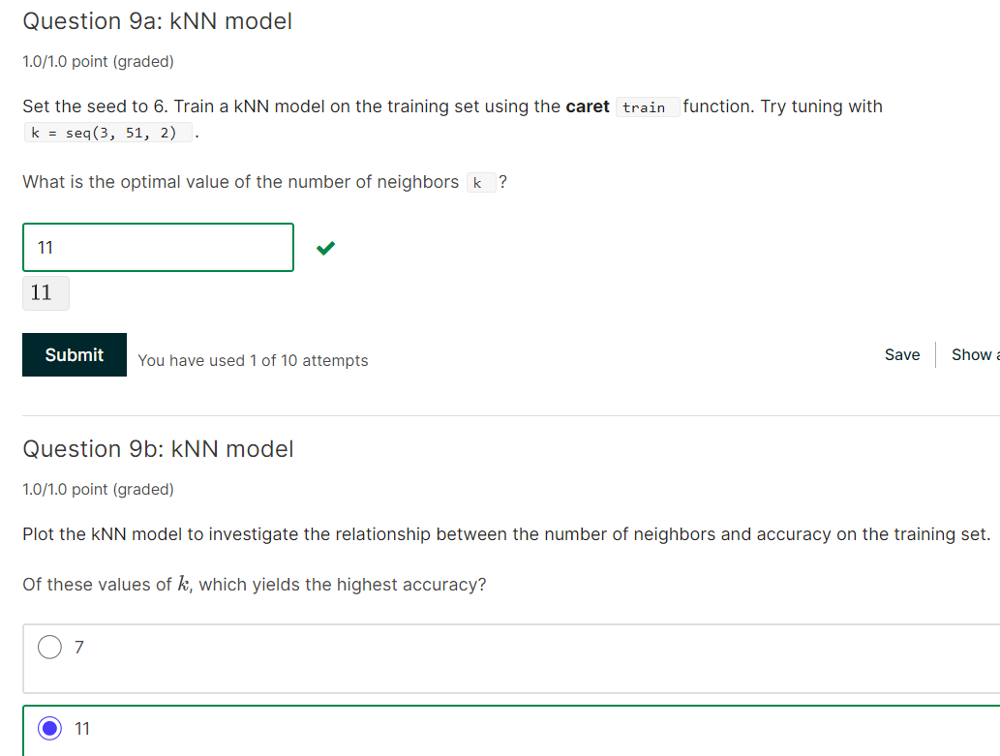

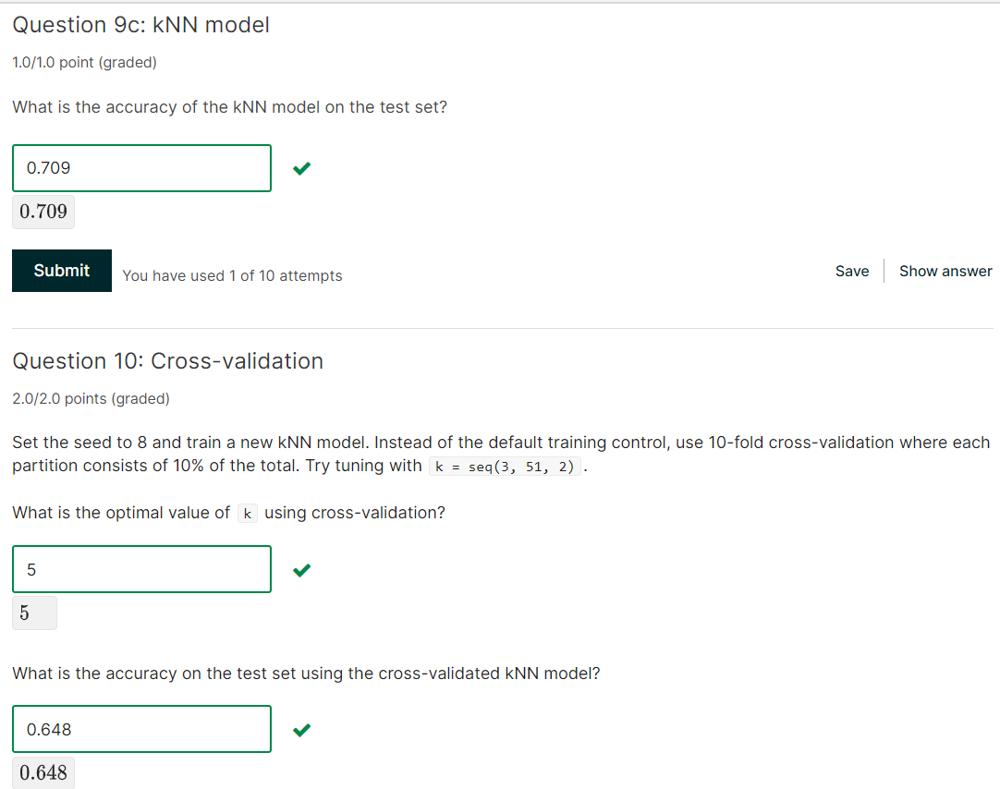

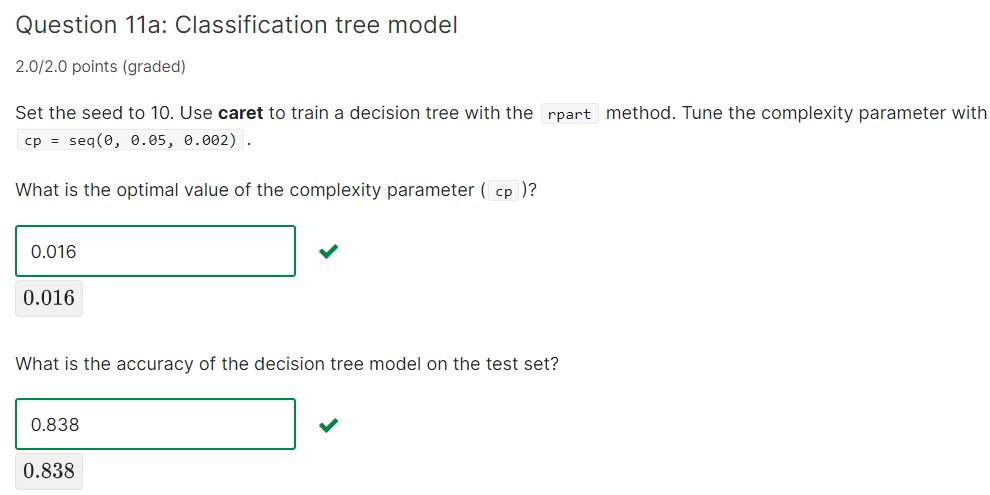

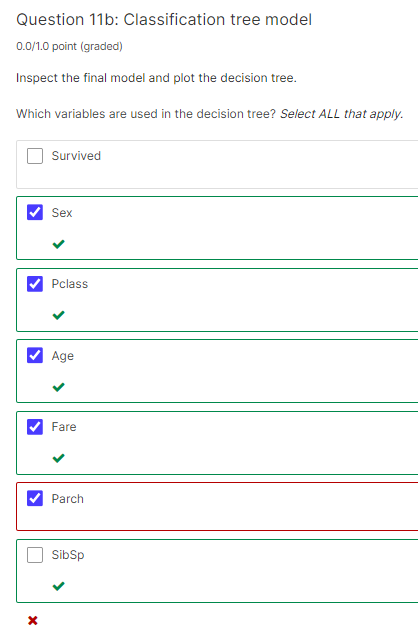

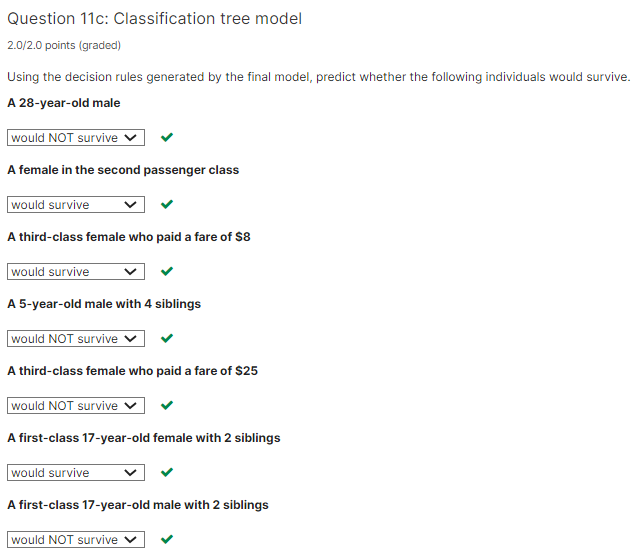

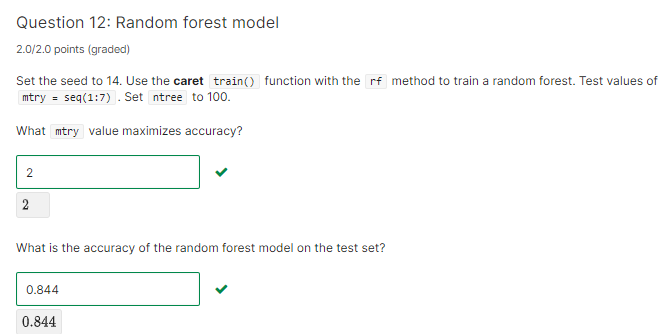

# **Section 6: Model Fitting and Recommendation Systems**


In the Model Fitting and Recommendation Systems section, you will learn how to apply the machine learning algorithms you have learned.

After completing this section, you will be able to:

- Apply the methods we have learned to an example, the MNIST digits.
- Build a movie recommendation system using machine learning.
- Penalize large estimates that come from small sample sizes using regularization.

## **MNIST case study: preprocessing**

We will apply what we have learned in the course on the Modified National Institute of Standards and Technology database (MNIST) digits, a popular dataset used in machine learning competitions.
Common preprocessing steps include:
- standardizing or transforming predictors and
- removing predictors that are not useful, are highly correlated with others, have very few non-unique values, or have close to zero variation.

In [ ]:
library(dslabs)
mnist <- read_mnist()

names(mnist)
dim(mnist$train$images)

class(mnist$train$labels)
table(mnist$train$labels)

# sample 10k rows from training set, 1k rows from test set
set.seed(1990)
index <- sample(nrow(mnist$train$images), 10000)
x <- mnist$train$images[index,]
y <- factor(mnist$train$labels[index])

index <- sample(nrow(mnist$test$images), 1000)
x_test <- mnist$test$images[index,]
y_test <- factor(mnist$test$labels[index])

library(matrixStats)
sds <- colSds(x)
qplot(sds, bins = 256, color = I("black"))

library(caret)
nzv <- nearZeroVar(x)
image(matrix(1:784 %in% nzv, 28, 28))

col_index <- setdiff(1:ncol(x), nzv)
length(col_index)

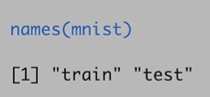

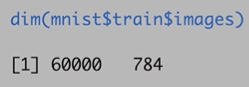

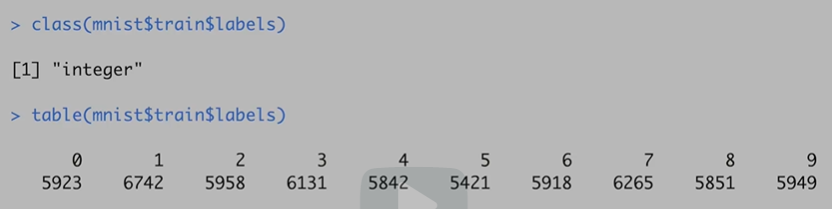



## **MNIST case study: kNN**

The caret package requires that we add column names to the feature matrices.

In general, it is a good idea to test out a small subset of the data first to get an idea of how long your code will take to run.

In [ ]:
colnames(x) <- 1:ncol(mnist$train$images)
colnames(x_test) <- colnames(x)

control <- trainControl(method = "cv", number = 10, p = .9)
train_knn <- train(x[,col_index], y,
                                method = "knn",
                                tuneGrid = data.frame(k = c(3,5,7)),
                                trControl = control)

n <- 1000
b <- 2
index <- sample(nrow(x), n)
control <- trainControl(method = "cv", number = b, p = .9)
train_knn <- train(x[index ,col_index], y[index],
                   method = "knn",
                   tuneGrid = data.frame(k = c(3,5,7)),
                   trControl = control)
fit_knn <- knn3(x[ ,col_index], y,  k = 3)

y_hat_knn <- predict(fit_knn,
                     x_test[, col_index],
                     type="class")
cm <- confusionMatrix(y_hat_knn, factor(y_test))
cm$overall["Accuracy"]
# output: 0.954

cm$byClass[,1:2]

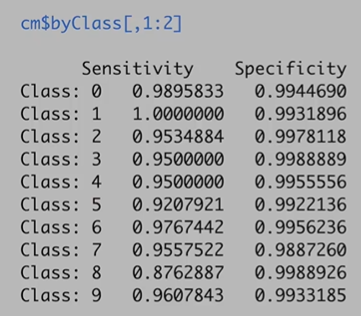

## **MNIST case study: random forest**

The caret package requires that we add column names to the feature matrices.

In general, it is a good idea to test out a small subset of the data first to get an idea of how long your code will take to run.

In [ ]:
library(randomForest)
control <- trainControl(method="cv", number = 5)
grid <- data.frame(mtry = c(1, 5, 10, 25, 50, 100))
train_rf <-  train(x[, col_index], y,
                   method = "rf",
                   nTree = 150,
                   trControl = control,
                   tuneGrid = grid,
                   nSamp = 5000)

fit_rf <- randomForest(x[, col_index], y,
                  minNode = train_rf$bestTune$mtry)

y_hat_rf <- predict(fit_rf, x_test[ ,col_index])
cm <- confusionMatrix(y_hat_rf, y_test)
cm$overall["Accuracy"]
# output: Accuracy = 0.956

## **MNIST case study: variable importance**

The randomForest package supports variable importance calculations.
An important part of data science is visualizing results to determine why we are failing.

In [ ]:
imp <- importance(fit_rf)
imp

mat <- rep(0, ncol(x))
mat[col_index] <- imp
image(matrix(imp, 28, 28))


p_max <- predict(fit_rf, x_test[,col_index], type = "prob")
p_max <- p_max / rowSums(p_max)
p_max <- apply(p_max, 1, max)

ind  <- which(y_hat_rf != y_test)
ind <- ind[order(p_max[ind], decreasing = TRUE)]

rafalib::mypar(1,4)
for(i in ind[1:4]){
    image(matrix(x_test[i,], 28, 28)[, 28:1],
                 main = paste0("Pr(",y_hat_rf[i],")=",round(p_max[i], 2),
                 " but is a ",y_test[i]),
                 xaxt="n", yaxt="n")
}

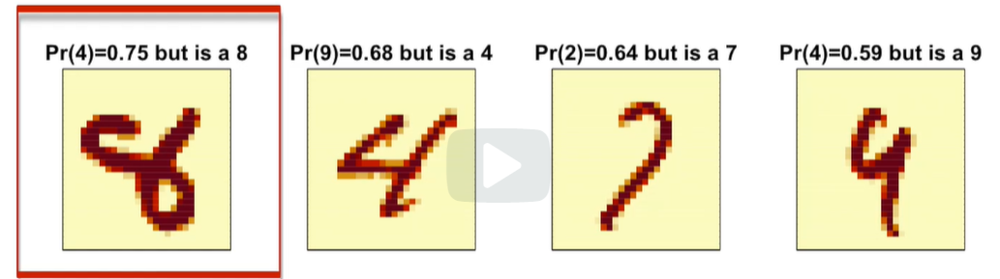

**The errors obtained are are actually the digits 4 (Pr(9) = 0.64), 3 (Pr(5) = 0.61), 7 (Pr(2) = 0.59) and 9 (Pr(0) = 0.59).**

## **Ensembles**

Ensembles combine multiple machine learning algorithms into one model to improve predictions.

Here we present a very simple example, where we compute new class probabilities by taking the average of the class probabilities provided by random forest and k-nearest neighbors.

We can use this code to simply average these probabilities.

In [ ]:
p_rf <- predict(fit_rf, x_test[,col_index], type = "prob")
p_rf <- p_rf / rowSums(p_rf)
p_knn <- predict(fit_knn, x_test[,col_index])
p <- (p_rf + p_knn)/2
y_pred <- factor(apply(p, 1, which.max)-1)
confusionMatrix(y_pred, y_test)$overall["Accuracy"]

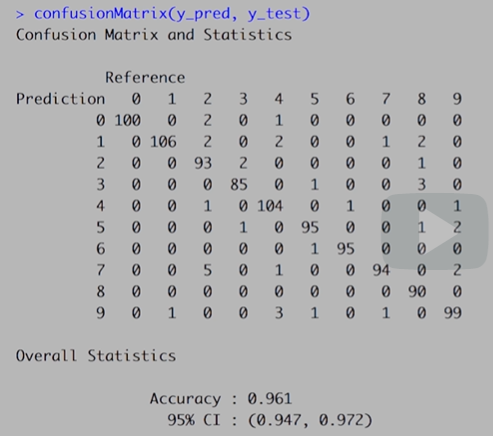

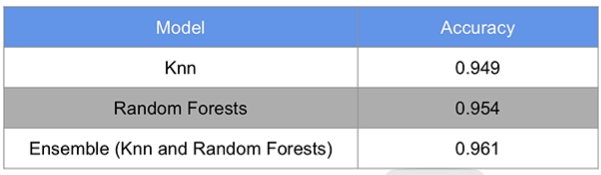

## **Comprehension Check: Ensembles**

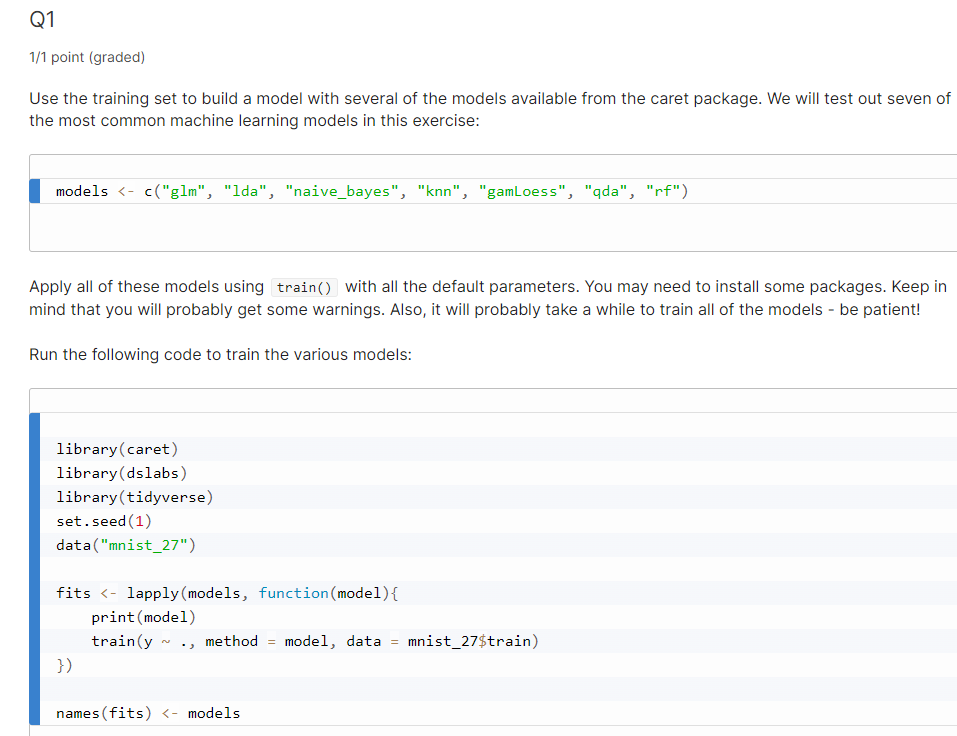

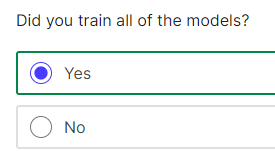

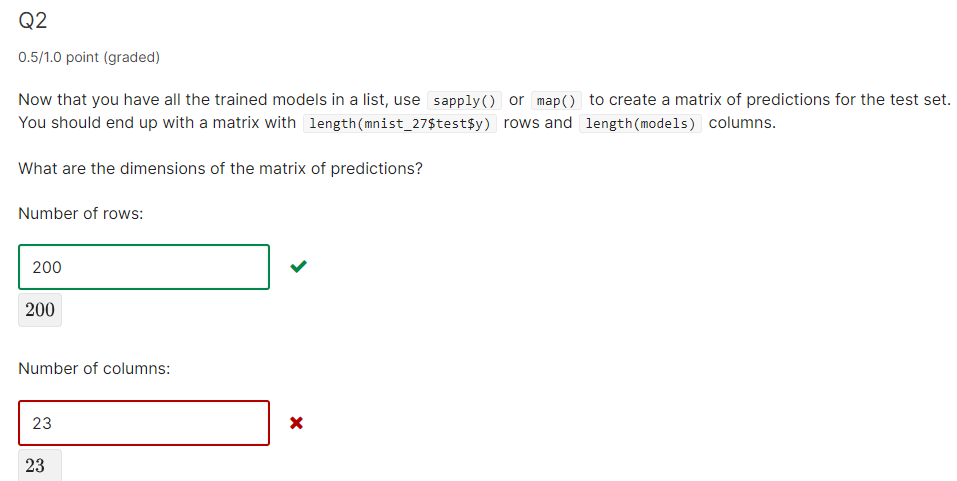

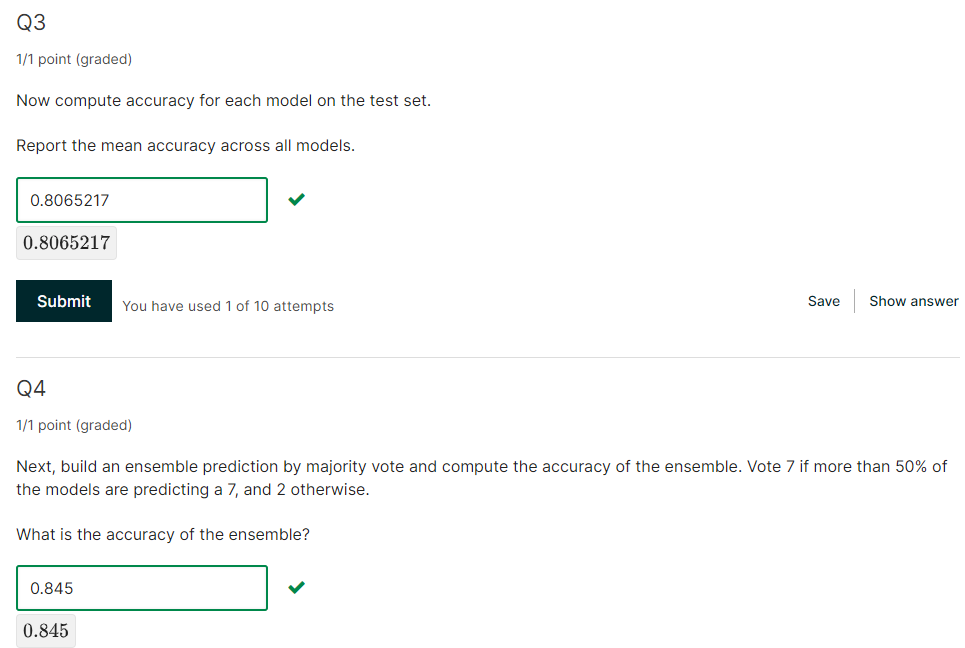

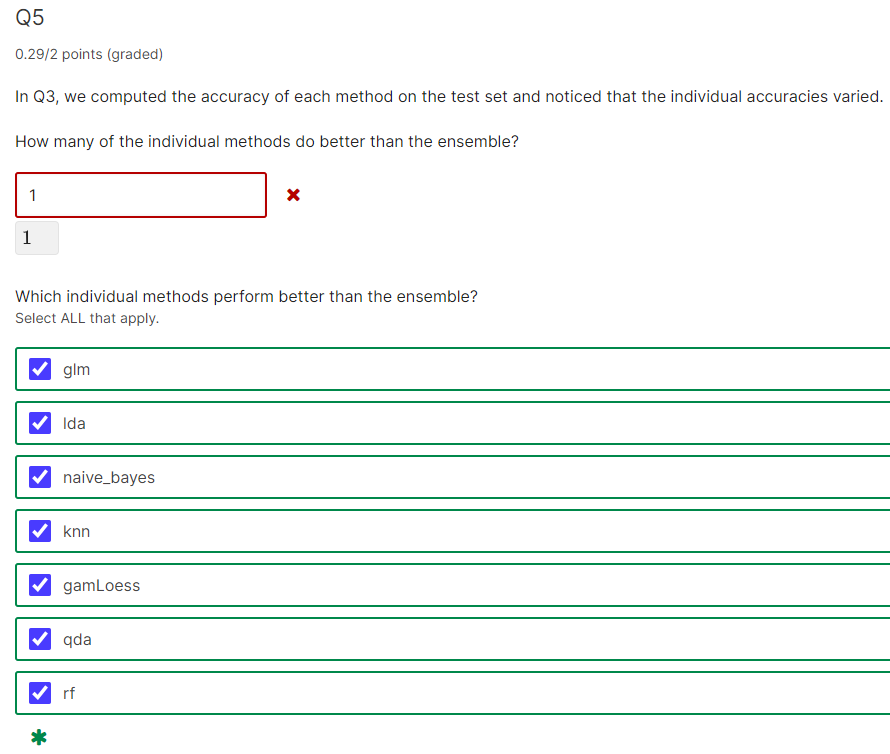

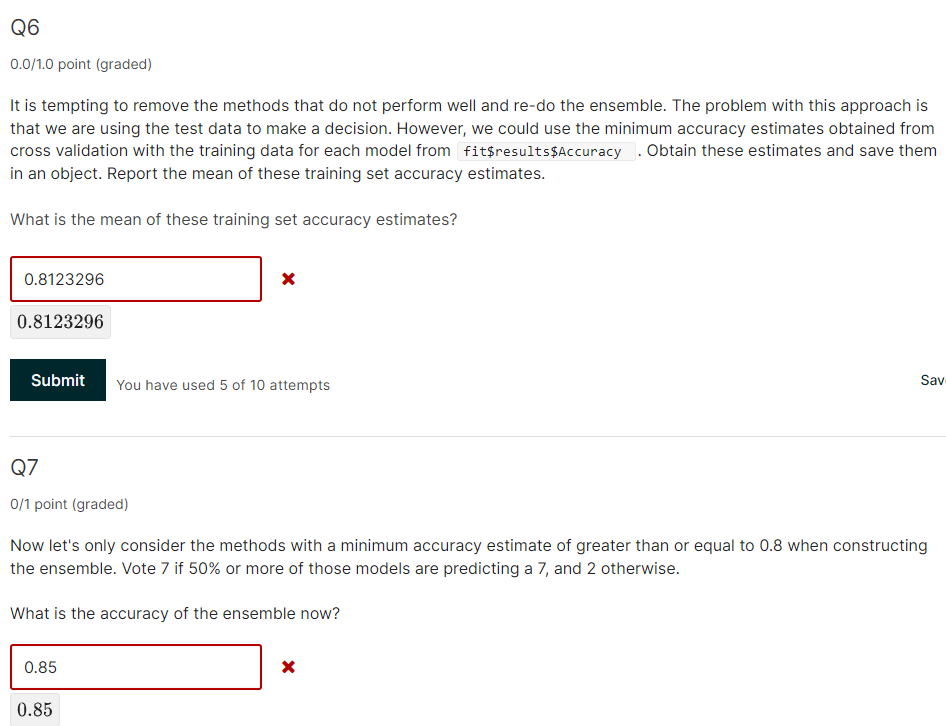

## **Recommendation Systems**

**Netflix Challenge links**

For more information about the "Netflix Challenge," you can check out these sites:

https://bits.blogs.nytimes.com/2009/09/21/netflix-awards-1-million-prize-and-starts-a-new-contest/
http://blog.echen.me/2011/10/24/winning-the-netflix-prize-a-summary/
https://www.netflixprize.com/assets/GrandPrize2009_BPC_BellKor.pdf

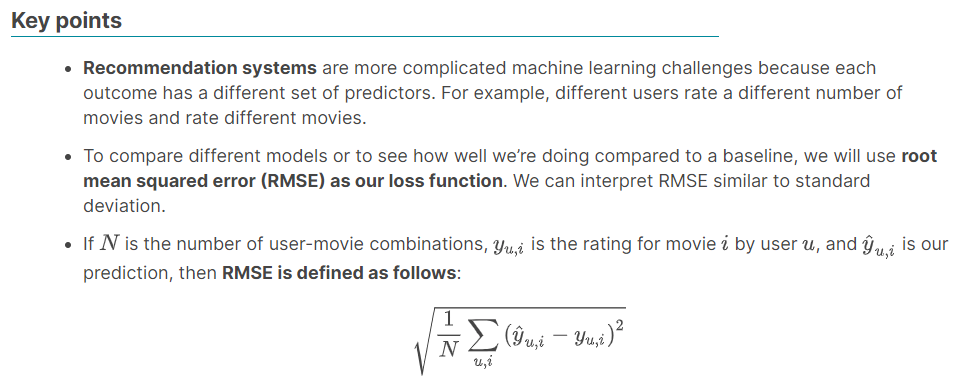

In [ ]:
# HarvardX: PH125.8x
# Data Science: Machine Learning
# R code from course videos

# Model Fitting and Recommendation Systems

## Recommendation Systems

### Recommendation Systems

# https://bits.blogs.nytimes.com/2009/09/21/netflix-awards-1-million-prize-and-starts-a-new-contest/
# http://blog.echen.me/2011/10/24/winning-the-netflix-prize-a-summary/
# https://www.netflixprize.com/assets/GrandPrize2009_BPC_BellKor.pdf

library(dslabs)
library(tidyverse)

data("movielens")

movielens %>% as_tibble()

movielens %>%
     summarize(n_users = n_distinct(userId),
               n_movies = n_distinct(movieId))

keep <- movielens %>%
     dplyr::count(movieId) %>%
     top_n(5) %>%
     pull(movieId)

tab <- movielens %>%
     filter(userId %in% c(13:20)) %>%
     filter(movieId %in% keep) %>%
     dplyr::select(userId, title, rating) %>%
     pivot_wider(names_from="title", values_from="rating")
tab %>% knitr::kable()

users <- sample(unique(movielens$userId), 100)
rafalib::mypar()
movielens %>% filter(userId %in% users) %>%
dplyr::select(userId, movieId, rating) %>%
mutate(rating = 1) %>%
pivot_wider(names_from = movieId, values_from = rating) %>%
(\(mat) mat[, sample(ncol(mat), 100)])()%>%
as.matrix() %>%
t() %>%
image(1:100, 1:100,. , xlab="Movies", ylab="Users")
abline(h=0:100+0.5, v=0:100+0.5, col = "grey")

library(gridExtra)
p1 <- movielens %>%
     dplyr::count(movieId) %>%
     ggplot(aes(n)) +
     geom_histogram(bins = 30, color = "black") +
     scale_x_log10() +
     ggtitle("Movies")

p2 <- movielens %>%
     dplyr::count(userId) %>%
     ggplot(aes(n)) +
     geom_histogram(bins = 30, color = "black") +
     scale_x_log10() +
     ggtitle("Users")
grid.arrange(p1, p2, ncol = 2)

library(caret)
set.seed(755)
test_index <- createDataPartition(y = movielens$rating, times = 1,
                                  p = 0.2, list = FALSE)
train_set <- movielens[-test_index,]
test_set <- movielens[test_index,]

#To make sure we don't include users and movies in the test set that do not appear in the training set, we removed these using the semi_join function, using this simple code.
test_set <- test_set %>%
     semi_join(train_set, by = "movieId") %>%
     semi_join(train_set, by = "userId")

RMSE <- function(true_ratings, predicted_ratings){
     sqrt(mean((true_ratings - predicted_ratings)^2))
}

### Building the Recommendation System
# A first model
mu_hat <- mean(train_set$rating)
mu_hat

naive_rmse <- RMSE(test_set$rating, mu_hat)
naive_rmse

predictions <- rep(2.5, nrow(test_set))
RMSE(test_set$rating, predictions)

rmse_results <- data_frame(method = "Just the average", RMSE = naive_rmse)

# Modeling movie effects

# fit <- lm(rating ~ as.factor(userId), data = movielens)
mu <- mean(train_set$rating)
movie_avgs <- train_set %>%
     group_by(movieId) %>%
     summarize(b_i = mean(rating - mu))


movie_avgs %>% qplot(b_i, geom ="histogram", bins = 30, data = ., color = I("black"))

predicted_ratings <- mu + test_set %>%
     left_join(movie_avgs, by='movieId') %>%
     pull(b_i)

model_1_rmse <- RMSE(predicted_ratings, test_set$rating)
rmse_results <- bind_rows(rmse_results,
                          data_frame(method="Movie Effect Model",
                                     RMSE = model_1_rmse ))
rmse_results %>% knitr::kable()

# Modeling user effects

train_set %>%
     group_by(userId) %>%
     summarize(b_u = mean(rating)) %>%
     filter(n()>=100) %>%
     ggplot(aes(b_u)) +
     geom_histogram(bins = 30, color = "black")

# lm(rating ~ as.factor(movieId) + as.factor(userId))
user_avgs <- train_set %>%
     left_join(movie_avgs, by='movieId') %>%
     group_by(userId) %>%
     summarize(b_u = mean(rating - mu - b_i))

predicted_ratings <- test_set %>%
     left_join(movie_avgs, by='movieId') %>%
     left_join(user_avgs, by='userId') %>%
     mutate(pred = mu + b_i + b_u) %>%
     pull(pred)

model_2_rmse <- RMSE(predicted_ratings, test_set$rating)

rmse_results <- bind_rows(rmse_results,
                          data_frame(method="Movie + User Effects Model",
                                     RMSE = model_2_rmse ))
rmse_results %>% knitr::kable()

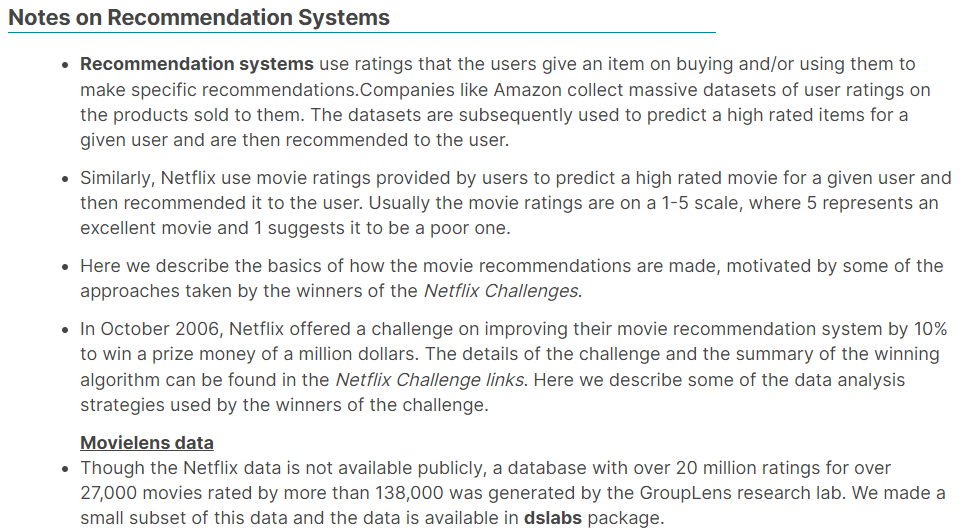

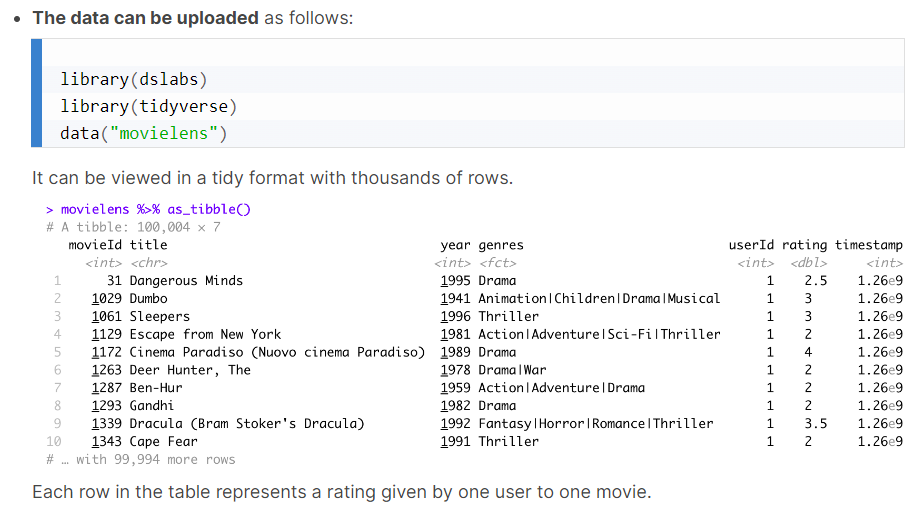

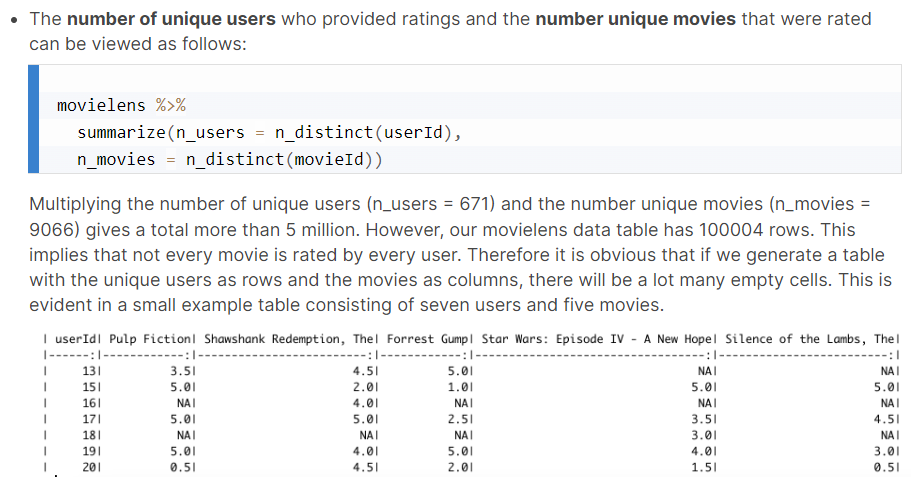

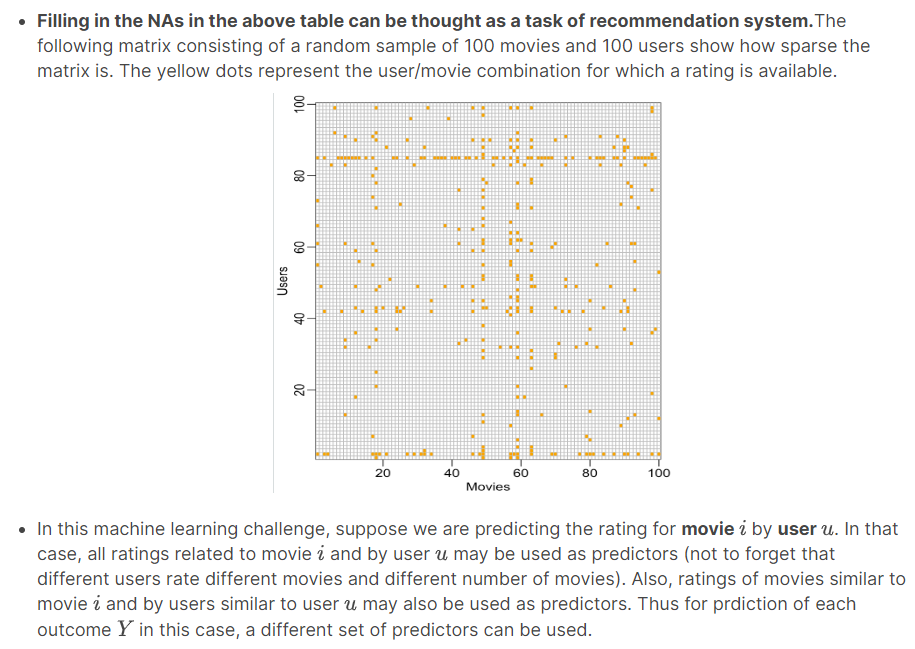

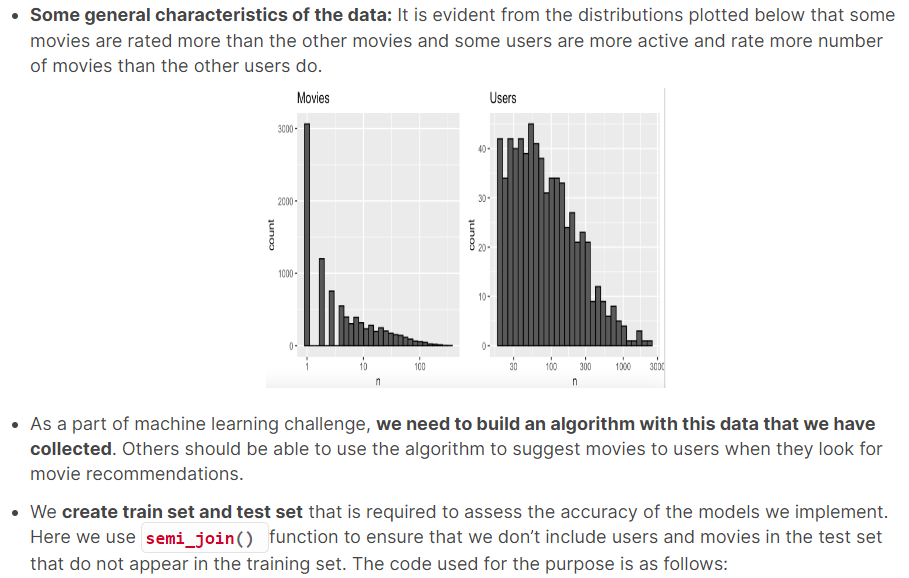

In [ ]:
library(caret)
set.seed(755)
test_index <- createDataPartition(y = movielens$rating, times = 1,
                                  p = 0.2, list = FALSE)
train_set <- movielens[-test_index,]
test_set <- movielens[test_index,]

test_set <- test_set %>%
 semi_join(train_set, by = "movieId") %>%
 semi_join(train_set, by = "userId")

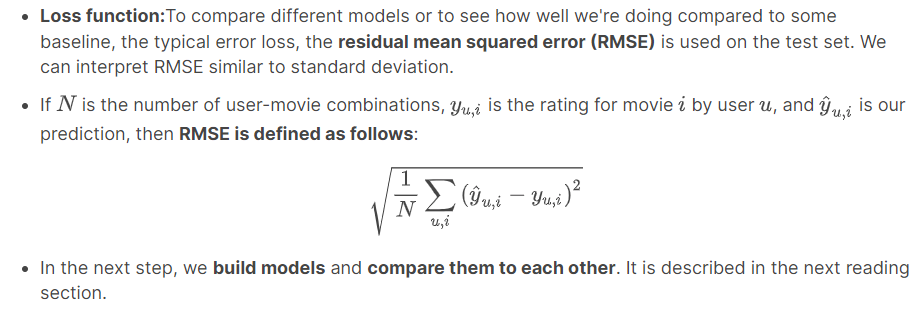

## **Building the Recommendation System**

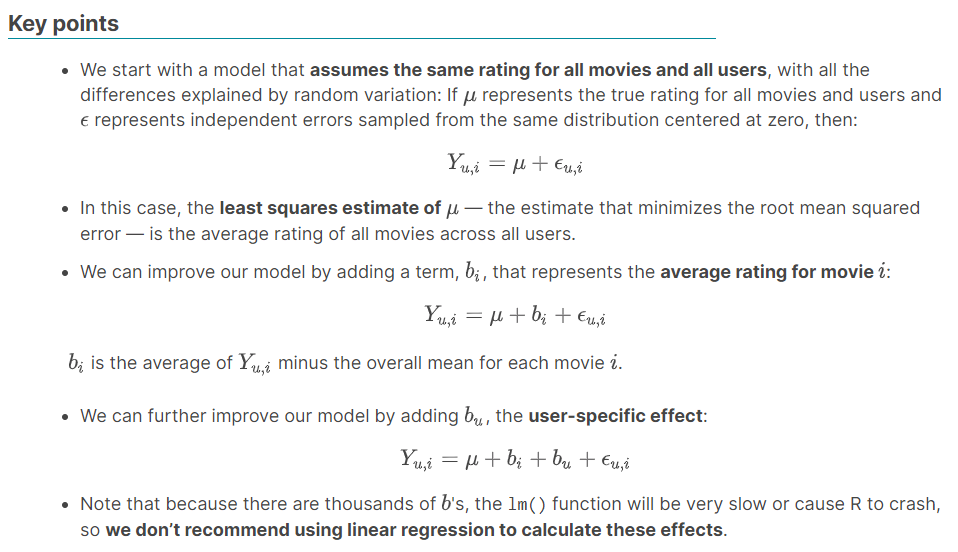

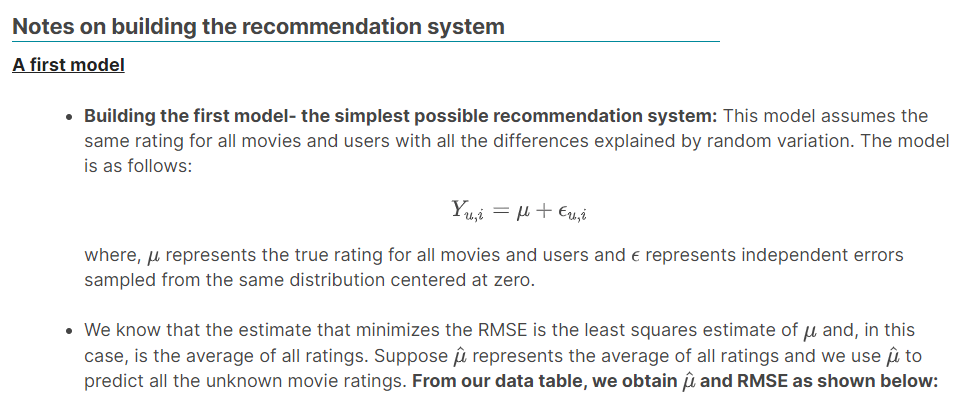

In [ ]:
RMSE <- function(true_ratings, predicted_ratings){
     sqrt(mean((true_ratings - predicted_ratings)^2))
}

mu_hat <- mean(train_set$rating)
mu_hat

naive_rmse <- RMSE(test_set$rating, mu_hat)
naive_rmse

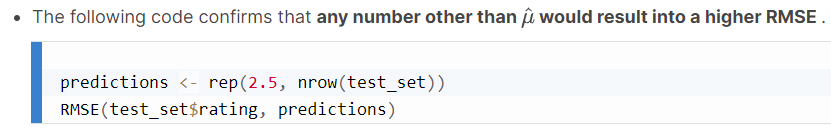

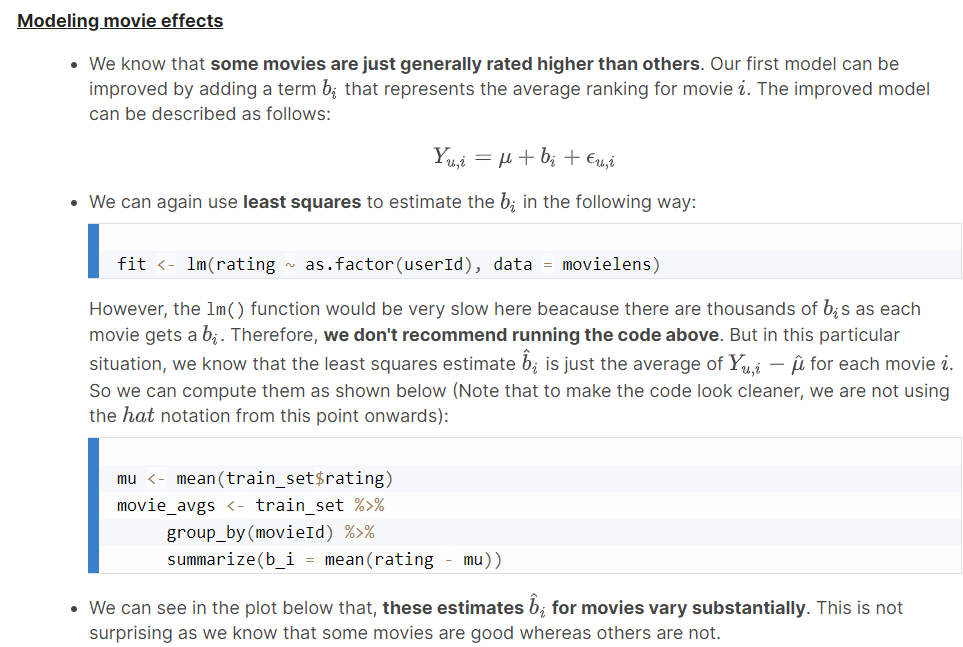

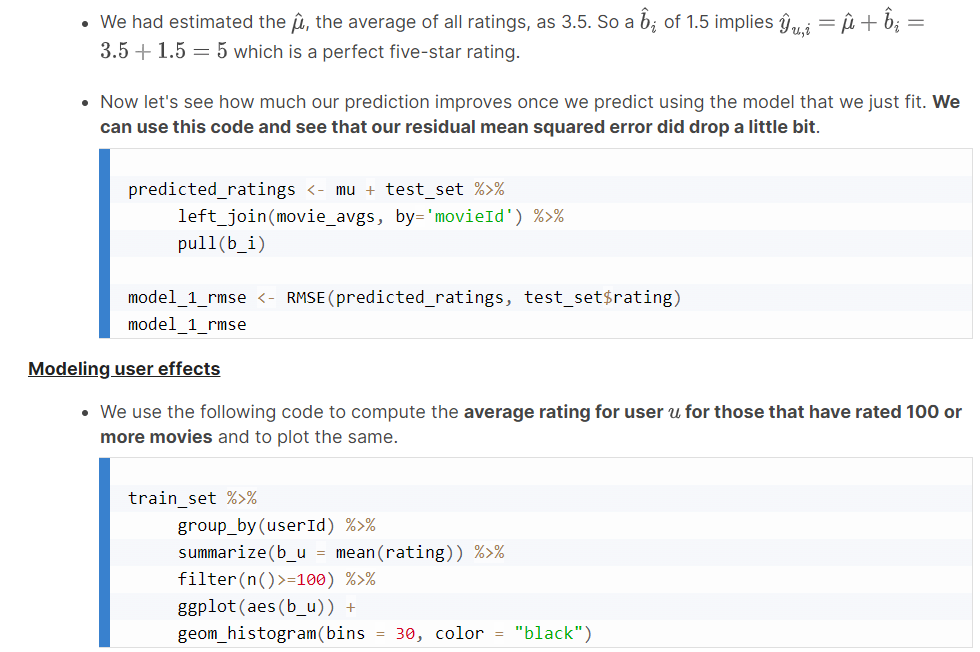

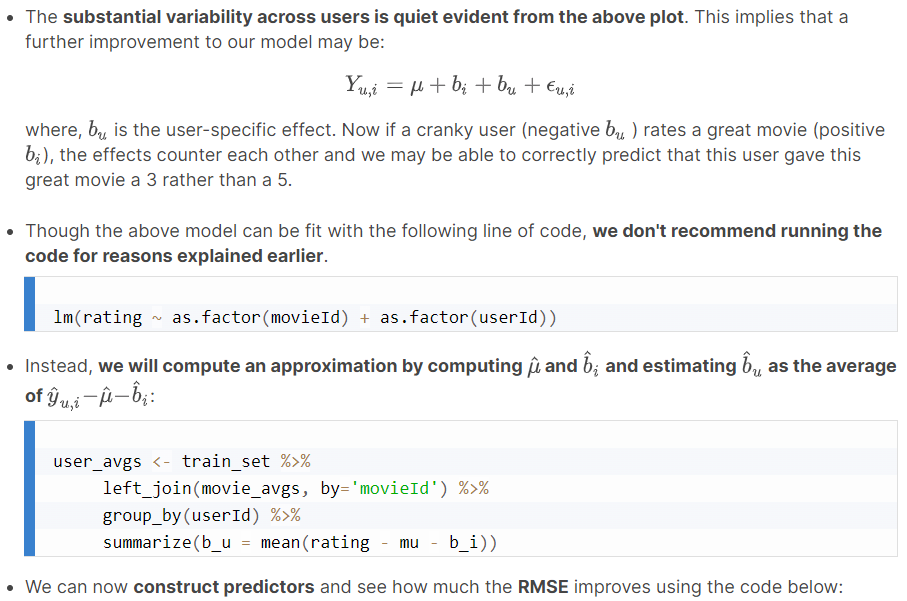

In [ ]:
predicted_ratings <- test_set %>%
     left_join(movie_avgs, by='movieId') %>%
     left_join(user_avgs, by='userId') %>%
     mutate(pred = mu + b_i + b_u) %>%
     pull(pred)

model_2_rmse <- RMSE(predicted_ratings, test_set$rating)
model_2_rmse

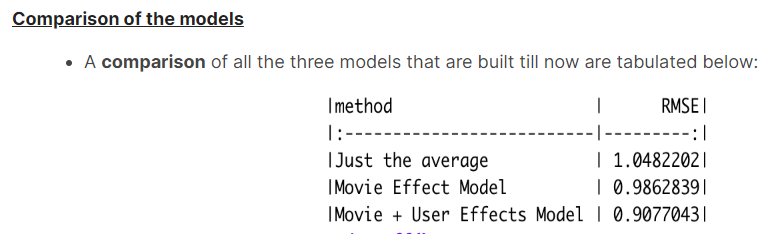

## **Comprehension Check: Recommendation Systems**

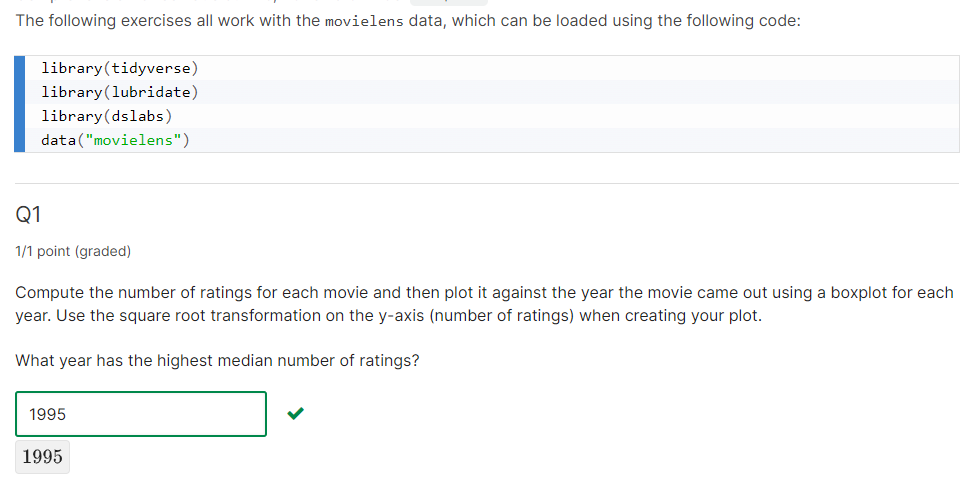

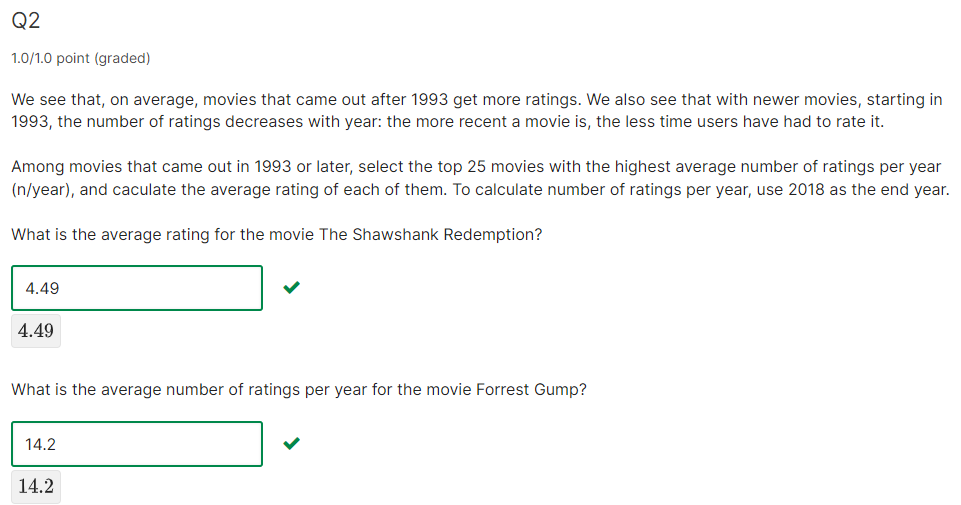

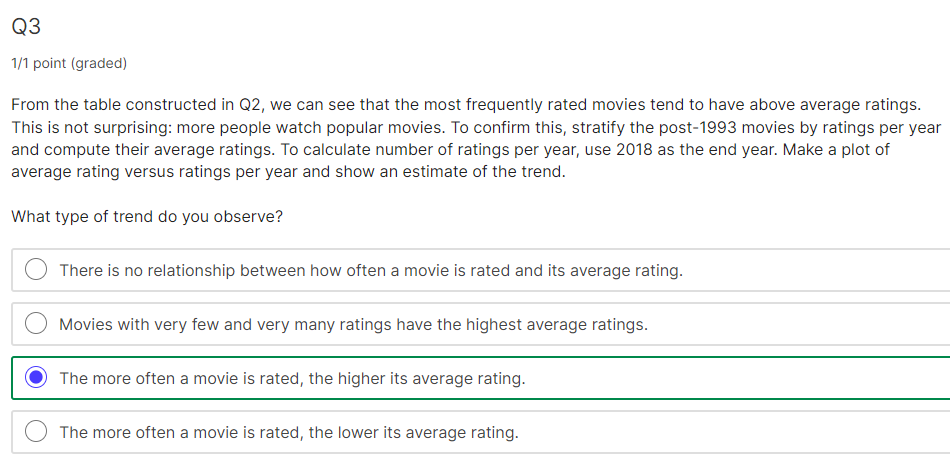

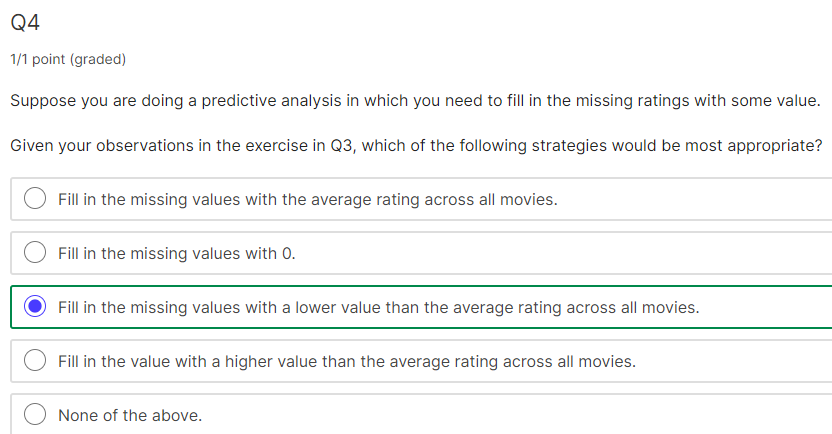

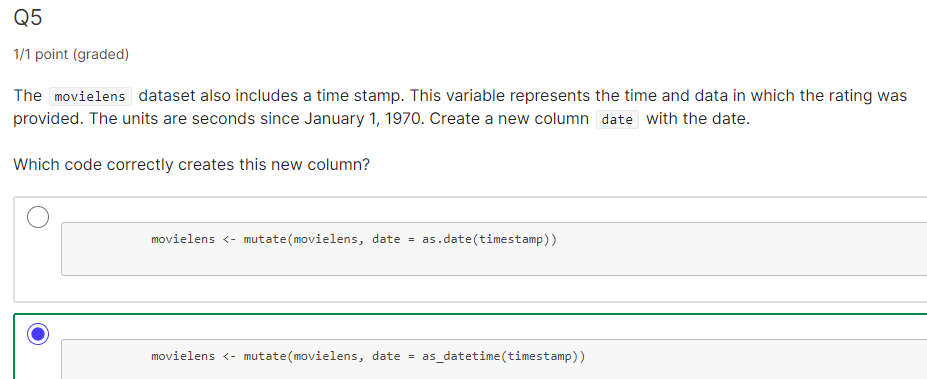

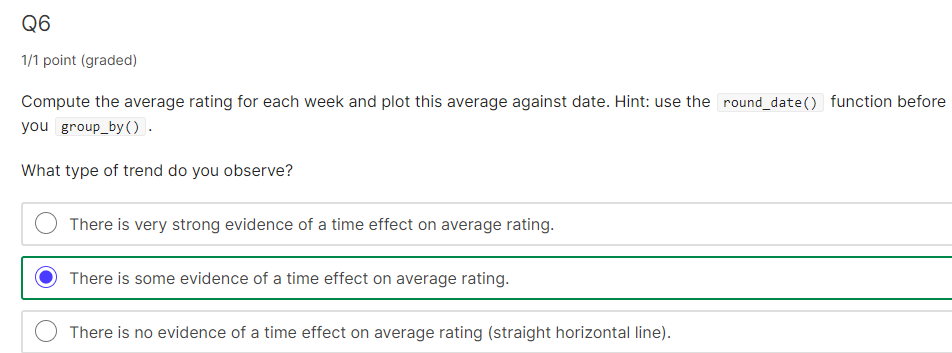

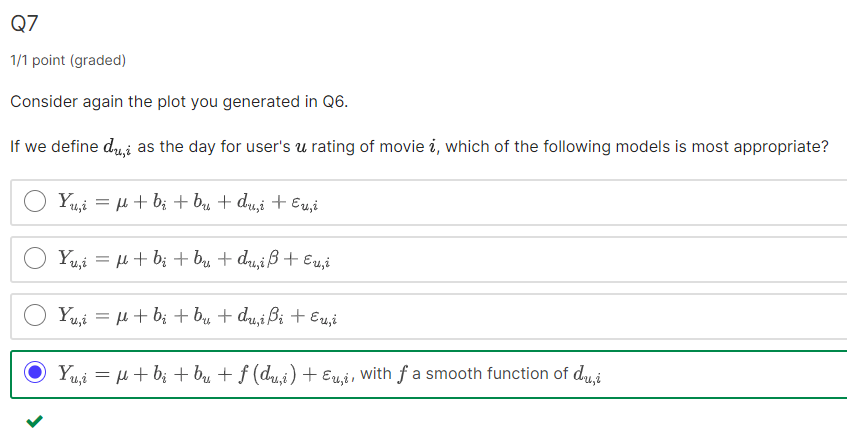

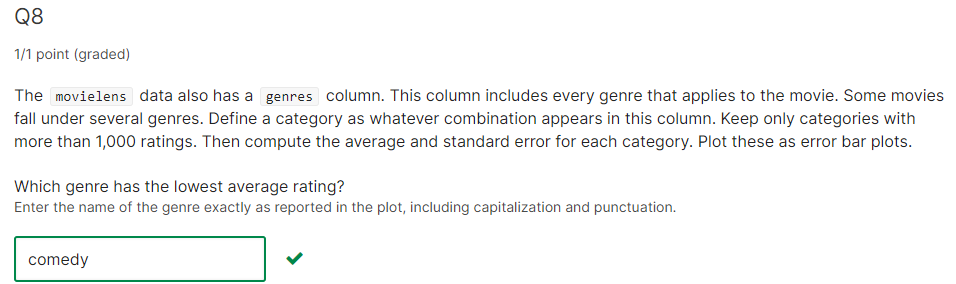

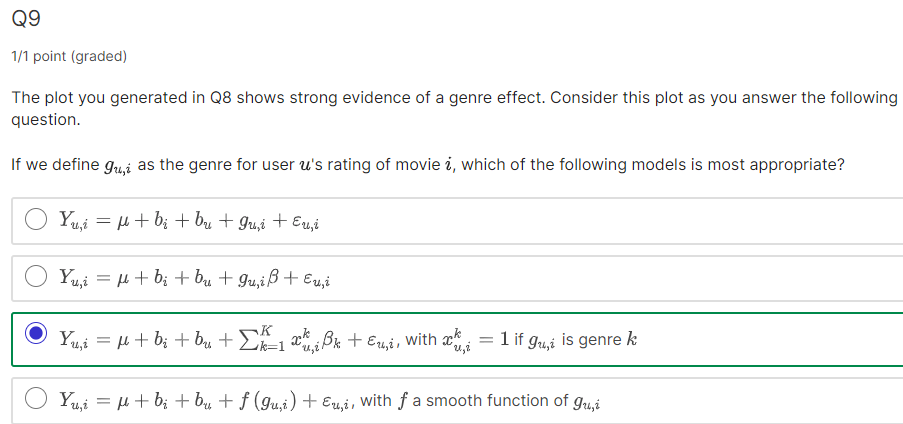

## **Regularization**

In [ ]:
# HarvardX: PH125.8x
# Data Science: Machine Learning
# R code from course videos

# Model Fitting and Recommendation Systems

## Regularization

### Regularization

library(dslabs)
library(tidyverse)
library(caret)
data("movielens")
set.seed(755)
test_index <- createDataPartition(y = movielens$rating, times = 1,
                                  p = 0.2, list = FALSE)
train_set <- movielens[-test_index,]
test_set <- movielens[test_index,]
test_set <- test_set %>%
     semi_join(train_set, by = "movieId") %>%
     semi_join(train_set, by = "userId")
RMSE <- function(true_ratings, predicted_ratings){
     sqrt(mean((true_ratings - predicted_ratings)^2))
}
mu_hat <- mean(train_set$rating)
naive_rmse <- RMSE(test_set$rating, mu_hat)
rmse_results <- data_frame(method = "Just the average", RMSE = naive_rmse)
mu <- mean(train_set$rating)
movie_avgs <- train_set %>%
     group_by(movieId) %>%
     summarize(b_i = mean(rating - mu))
predicted_ratings <- mu + test_set %>%
     left_join(movie_avgs, by='movieId') %>%
     pull(b_i)
model_1_rmse <- RMSE(predicted_ratings, test_set$rating)
rmse_results <- bind_rows(rmse_results,
                          data_frame(method="Movie Effect Model",
                                     RMSE = model_1_rmse ))
user_avgs <- train_set %>%
     left_join(movie_avgs, by='movieId') %>%
     group_by(userId) %>%
     summarize(b_u = mean(rating - mu - b_i))
predicted_ratings <- test_set %>%
     left_join(movie_avgs, by='movieId') %>%
     left_join(user_avgs, by='userId') %>%
     mutate(pred = mu + b_i + b_u) %>%
     pull(pred)
model_2_rmse <- RMSE(predicted_ratings, test_set$rating)
rmse_results <- bind_rows(rmse_results,
                          data_frame(method="Movie + User Effects Model",
                                     RMSE = model_2_rmse ))

test_set %>%
     left_join(movie_avgs, by='movieId') %>%
     mutate(residual = rating - (mu + b_i)) %>%
     arrange(desc(abs(residual))) %>%
     dplyr::select(title,  residual) %>% slice(1:10) %>% pull(title)

movie_titles <- movielens %>%
     dplyr::select(movieId, title) %>%
     distinct()

# 10 best
movie_avgs %>% left_join(movie_titles, by="movieId") %>%
     arrange(desc(b_i)) %>%
     dplyr::select(title, b_i) %>%
     slice(1:10) %>%
     pull(title)

# 10 worst
movie_avgs %>% left_join(movie_titles, by="movieId") %>%
     arrange(b_i) %>%
     dplyr::select(title, b_i) %>%
     slice(1:10) %>%
     pull(title)

train_set %>% count(movieId) %>%
     left_join(movie_avgs) %>%
     left_join(movie_titles, by="movieId") %>%
     arrange(desc(b_i)) %>%
     slice(1:10) %>%
     pull(n)

train_set %>% dplyr::count(movieId) %>%
     left_join(movie_avgs) %>%
     left_join(movie_titles, by="movieId") %>%
     arrange(b_i) %>%
     slice(1:10) %>%
     pull(n)

lambda <- 3
mu <- mean(train_set$rating)
movie_reg_avgs <- train_set %>%
     group_by(movieId) %>%
     summarize(b_i = sum(rating - mu)/(n()+lambda), n_i = n())


tibble(original = movie_avgs$b_i,
           regularlized = movie_reg_avgs$b_i,
           n = movie_reg_avgs$n_i) %>%
     ggplot(aes(original, regularlized, size=sqrt(n))) +
     geom_point(shape=1, alpha=0.5)

train_set %>%
     count(movieId) %>%
     left_join(movie_reg_avgs, by="movieId") %>%
     left_join(movie_titles, by="movieId") %>%
     arrange(desc(b_i)) %>%
     dplyr::select(title, b_i, n) %>%
     slice(1:10) %>%
     pull(title)

train_set %>%
     dplyr::count(movieId) %>%
     left_join(movie_reg_avgs, by="movieId") %>%
     left_join(movie_titles, by="movieId") %>%
     arrange(b_i) %>%
     dplyr::select(title, b_i, n) %>%
     slice(1:10) %>%
     pull(title)

predicted_ratings <- test_set %>%
     left_join(movie_reg_avgs, by='movieId') %>%
     mutate(pred = mu + b_i) %>%
     pull(pred)

model_3_rmse <- RMSE(predicted_ratings, test_set$rating)
rmse_results <- bind_rows(rmse_results,
                          data_frame(method="Regularized Movie Effect Model",
                                     RMSE = model_3_rmse ))
rmse_results %>% knitr::kable()

lambdas <- seq(0, 10, 0.25)
mu <- mean(train_set$rating)
just_the_sum <- train_set %>%
     group_by(movieId) %>%
     summarize(s = sum(rating - mu), n_i = n())
rmses <- sapply(lambdas, function(l){
     predicted_ratings <- test_set %>%
          left_join(just_the_sum, by='movieId') %>%
          mutate(b_i = s/(n_i+l)) %>%
          mutate(pred = mu + b_i) %>%
          pull(pred)
     return(RMSE(predicted_ratings, test_set$rating))
})
qplot(lambdas, rmses)
lambdas[which.min(rmses)]

lambdas <- seq(0, 10, 0.25)
rmses <- sapply(lambdas, function(l){
     mu <- mean(train_set$rating)
     b_i <- train_set %>%
          group_by(movieId) %>%
          summarize(b_i = sum(rating - mu)/(n()+l))
     b_u <- train_set %>%
          left_join(b_i, by="movieId") %>%
          group_by(userId) %>%
          summarize(b_u = sum(rating - b_i - mu)/(n()+l))
     predicted_ratings <-
          test_set %>%
          left_join(b_i, by = "movieId") %>%
          left_join(b_u, by = "userId") %>%
          mutate(pred = mu + b_i + b_u) %>%
          pull(pred)
     return(RMSE(predicted_ratings, test_set$rating))
})

qplot(lambdas, rmses)

lambda <- lambdas[which.min(rmses)]
lambda

rmse_results <- bind_rows(rmse_results,
                          data_frame(method="Regularized Movie + User Effect Model",
                                     RMSE = min(rmses)))
rmse_results %>% knitr::kable()

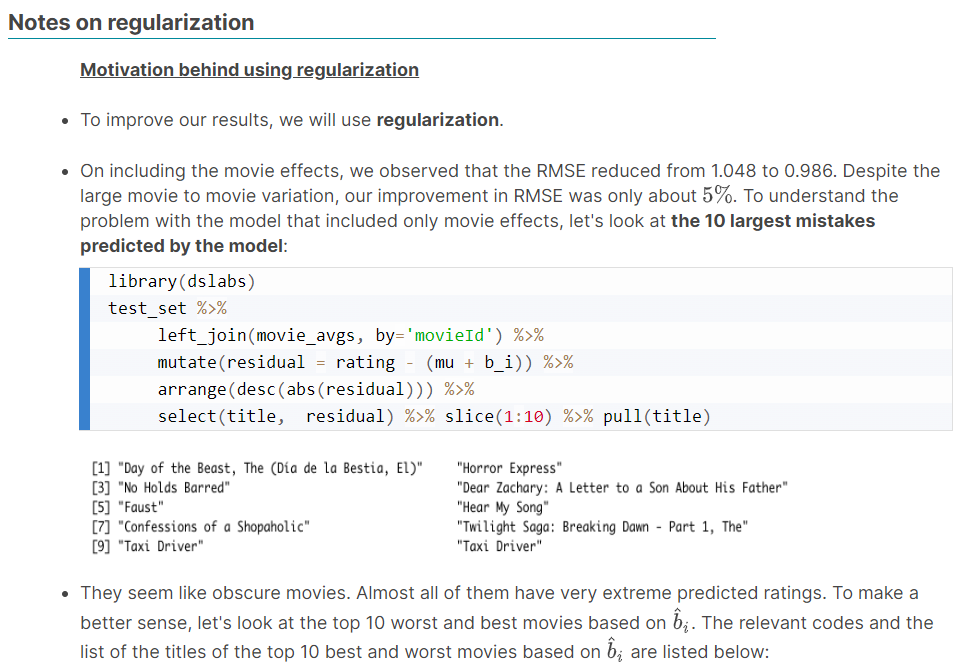

In [ ]:
movie_titles <- movielens %>%
     dplyr::select(movieId, title) %>%
     distinct()

movie_avgs %>% left_join(movie_titles, by="movieId") %>%
     arrange(desc(b_i)) %>%
     dplyr::select(title, b_i) %>%
     slice(1:10) %>%
     pull(title)

movie_avgs %>% left_join(movie_titles, by="movieId") %>%
     arrange(b_i) %>%
     dplyr::select(title, b_i) %>%
     slice(1:10) %>%
     pull(title)

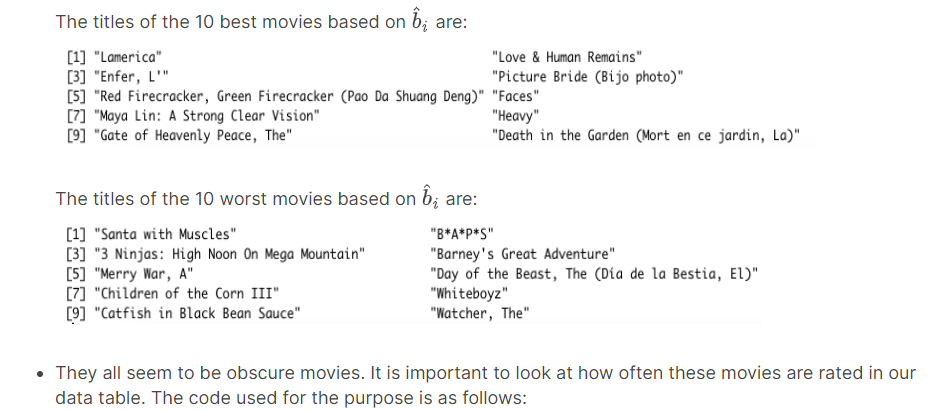

In [ ]:
train_set %>% count(movieId) %>%
     left_join(movie_avgs) %>%
     left_join(movie_titles, by="movieId") %>%
     arrange(desc(b_i)) %>%
     slice(1:10) %>%
     pull(n)

train_set %>% dplyr::count(movieId) %>%
     left_join(movie_avgs) %>%
     left_join(movie_titles, by="movieId") %>%
     arrange(b_i) %>%
     slice(1:10) %>%
     pull(n)

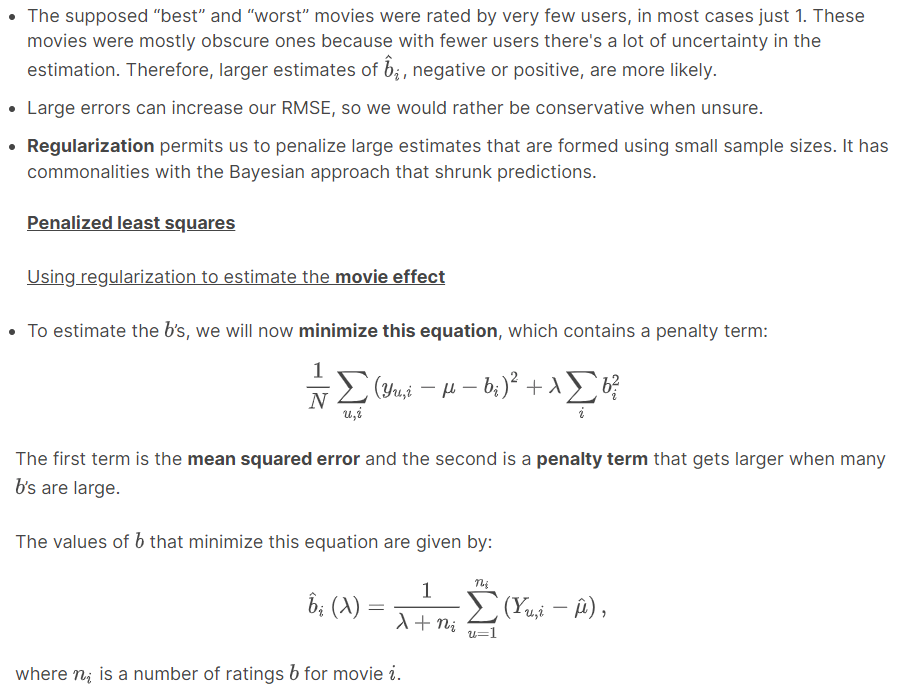

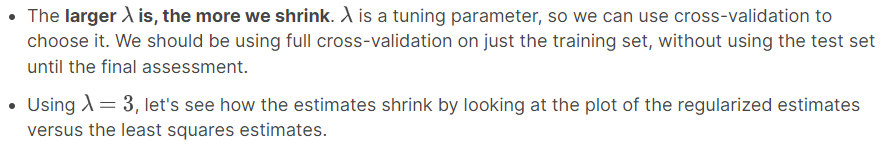

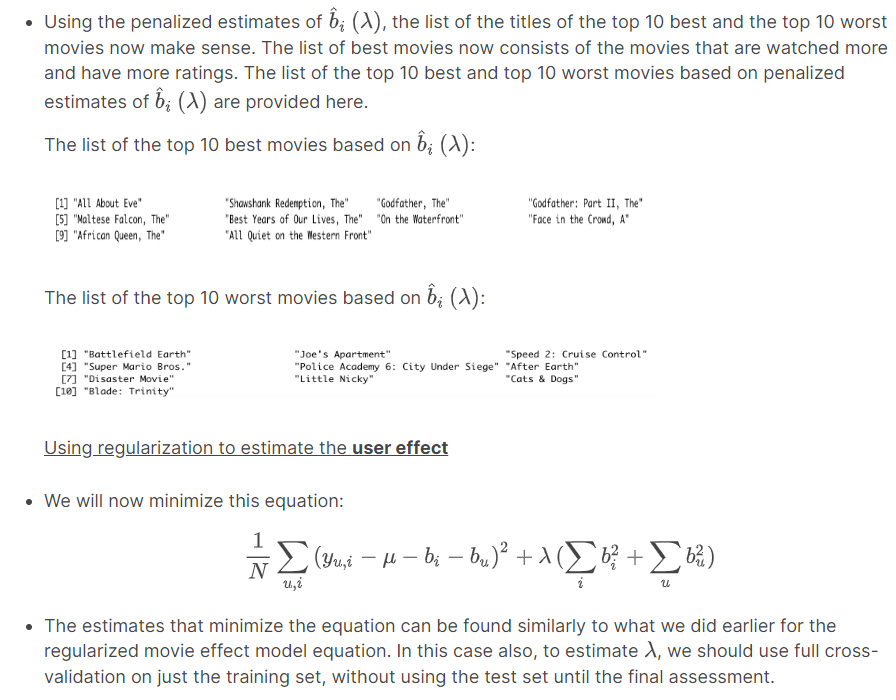

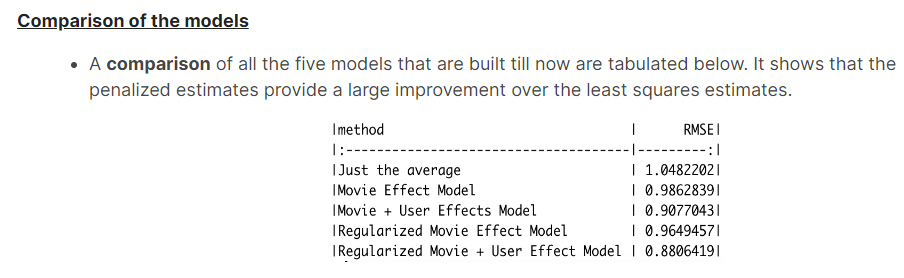

## **Comprehension Check: Regularization**

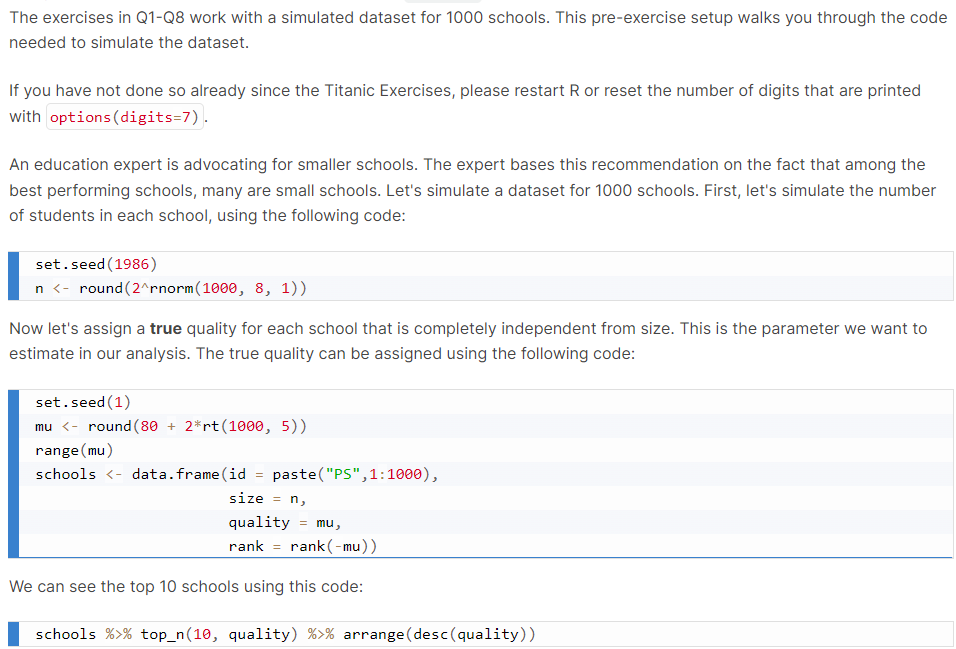

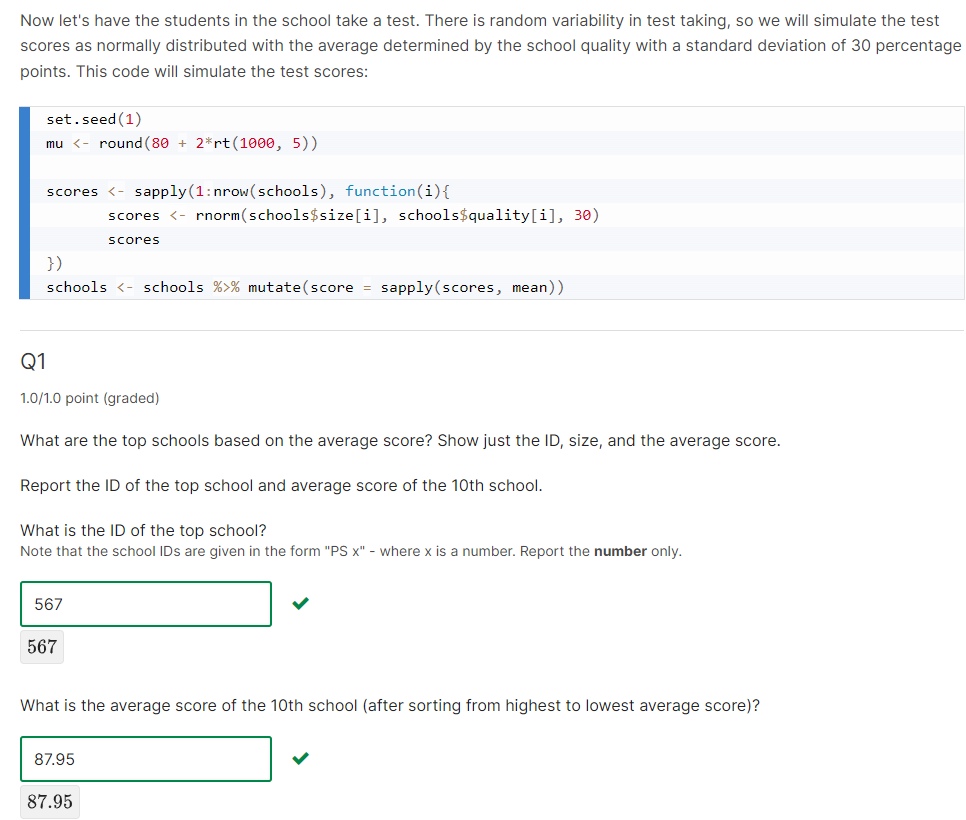

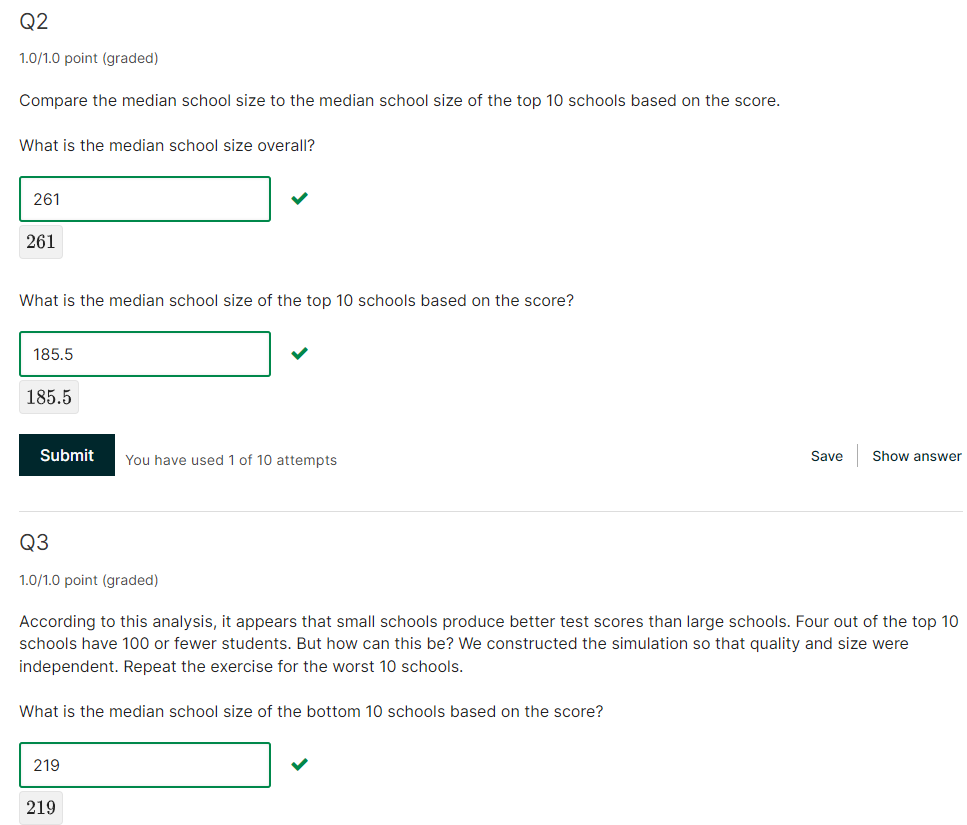

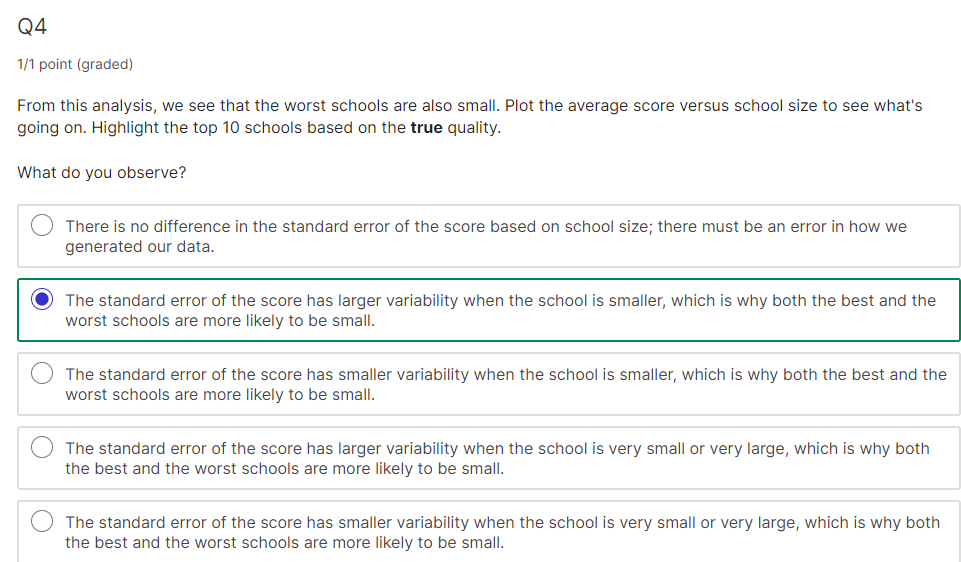

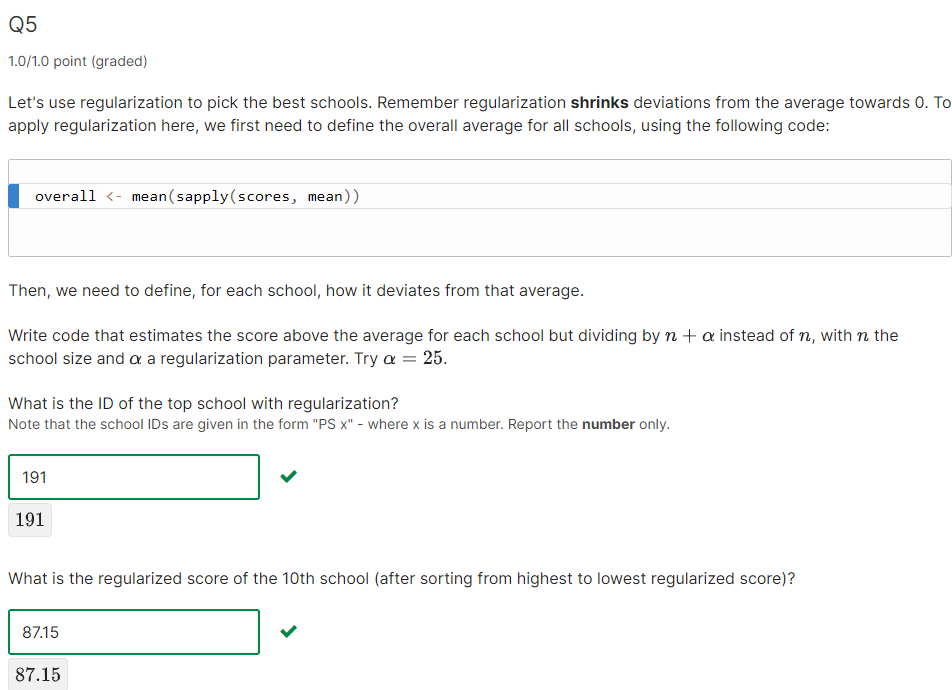

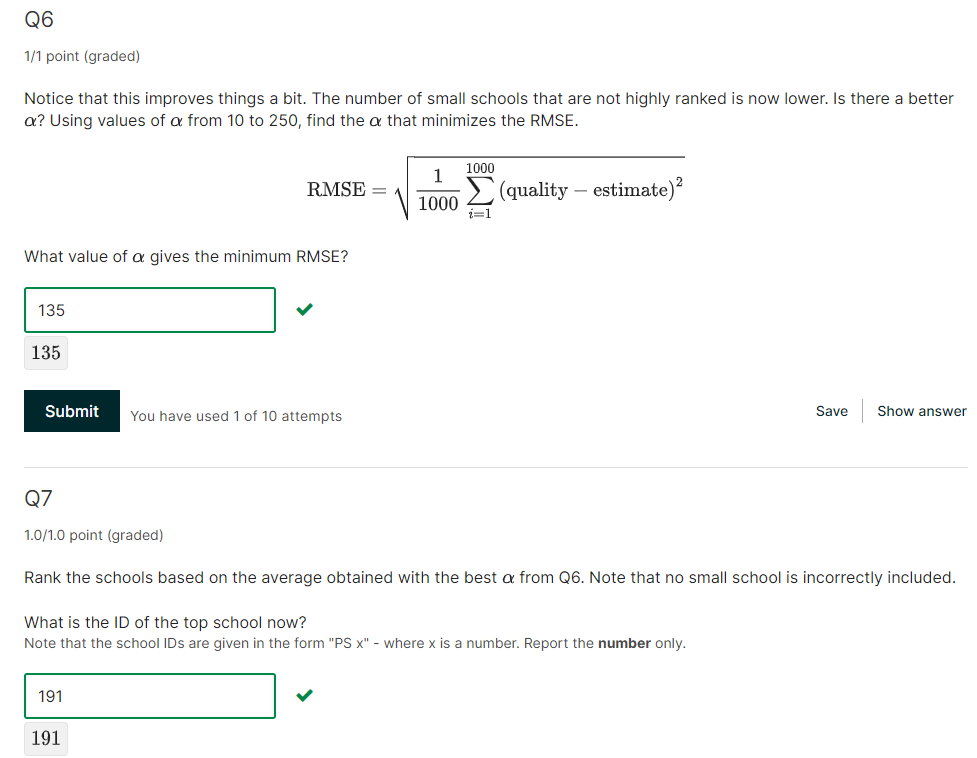

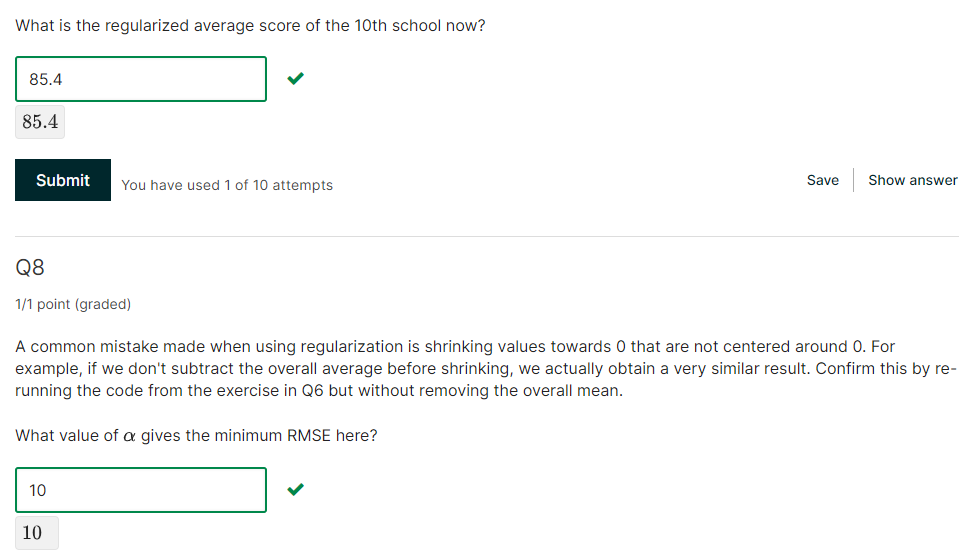

## **Matrix Factorization**

In [ ]:
# HarvardX: PH125.8x
# Data Science: Machine Learning
# R code from course videos

### Matrix Factorization
library(dslabs)
library(tidyverse)
library(caret)
data("movielens")

train_small <- movielens %>%
     group_by(movieId) %>%
     filter(n() >= 50 | movieId == 3252) %>% ungroup() %>%
     group_by(userId) %>%
     filter(n() >= 50) %>% ungroup()

y <- train_small %>%
     dplyr::select(userId, movieId, rating) %>%
     pivot_wider(names_from = "movieId", values_from = "rating") %>%
     as.matrix()

rownames(y)<- y[,1]
y <- y[,-1]

movie_titles <- movielens %>%
  dplyr::select(movieId, title) %>%
  distinct()

colnames(y) <- with(movie_titles, title[match(colnames(y), movieId)])

y <- sweep(y, 1, rowMeans(y, na.rm=TRUE)) #summary stats which needs to swept away, rowMeans removed
y <- sweep(y, 2, colMeans(y, na.rm=TRUE)) #summary stats which needs to swept away, colMeans removed

#Now y is a matrix of residuals
library(gridExtra)

m_1 <- "Godfather, The"
m_2 <- "Godfather: Part II, The"
p1 <- qplot(y[ ,m_1], y[,m_2], xlab = m_1, ylab = m_2)

m_1 <- "Godfather, The"
m_3 <- "Goodfellas"
p2 <- qplot(y[ ,m_1], y[,m_3], xlab = m_1, ylab = m_3)

m_4 <- "You've Got Mail"
m_5 <- "Sleepless in Seattle"
p3 <- qplot(y[ ,m_4], y[,m_5], xlab = m_4, ylab = m_5)

grid.arrange(p1, p2 ,p3, ncol = 3)

cor(y[, c(m_1, m_2, m_3, m_4, m_5)], use="pairwise.complete") %>%
     knitr::kable()

#factor analysis

set.seed(1988)
options(digits = 2)
Q <- matrix(c(1 , 1, 1, -1, -1), ncol=1)
rownames(Q) <- c(m_1, m_2, m_3, m_4, m_5)
P <- matrix(rep(c(2,0,-2), c(3,5,4)), ncol=1)
rownames(P) <- 1:nrow(P)

X <- jitter(P%*%t(Q))
X <- round(X, 1)
X %>% knitr::kable(align = "c")

cor(X)

t(Q) %>% knitr::kable(aling="c")

P

set.seed(1988)
m_6 <- "Scent of a Woman"
Q <- cbind(c(1 , 1, 1, -1, -1, -1),
           c(1 , 1, -1, -1, -1, 1))
rownames(Q) <- c(m_1, m_2, m_3, m_4, m_5, m_6)
P <- cbind(rep(c(2,0,-2), c(3,5,4)),
           c(-1,1,1,0,0,1,1,1,0,-1,-1,-1))/2
rownames(P) <- 1:nrow(X)

X <- jitter(P%*%t(Q), factor=1)
X %>% knitr::kable(align = "c")

cor(X)

t(Q) %>% knitr::kable(aling="c")

P

six_movies <- c(m_1, m_2, m_3, m_4, m_5, m_6)
tmp <- y[,six_movies]
cor(tmp, use="pairwise.complete")

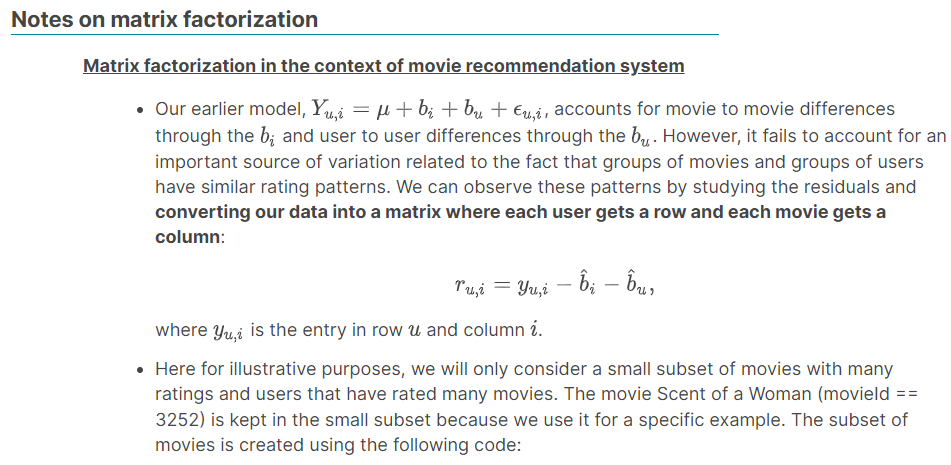

In [ ]:
train_small <- movielens %>%
     group_by(movieId) %>%
     filter(n() >= 50 | movieId == 3252) %>% ungroup() %>%
     group_by(userId) %>%
     filter(n() >= 50) %>% ungroup()

y <- train_small %>%
     dplyr::select(userId, movieId, rating) %>%
     pivot_wider(names_from = "movieId", values_from = "rating") %>%
     as.matrix()

rownames(y)<- y[,1]
y <- y[,-1]

movie_titles <- movielens %>%
  dplyr::select(movieId, title) %>%
  distinct()

colnames(y) <- with(movie_titles, title[match(colnames(y), movieId)])

Our data subset can be converted to residuals by removing the column and row effects:

In [ ]:
y <- sweep(y, 1, rowMeans(y, na.rm=TRUE))
y <- sweep(y, 2, colMeans(y, na.rm=TRUE))

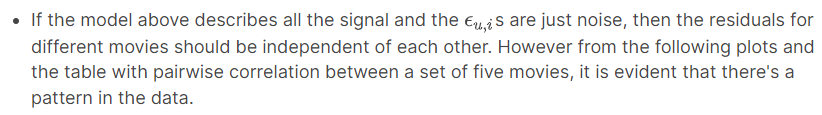

The first plot indicates that the users that liked The Godfather more than what the model expects them to, based on the movie and user effects, also liked The Godfather II more than expected. The next two plots say that the same is true between The Godfather and Goodfellas and between You’ve Got Mail and Sleepless in Seattle.
The pairwise correlation table:

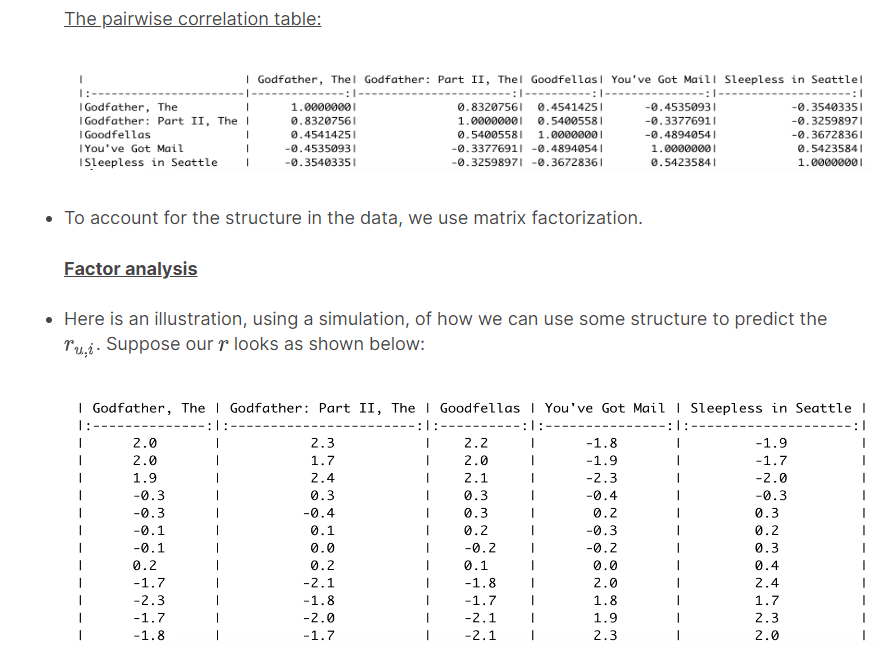

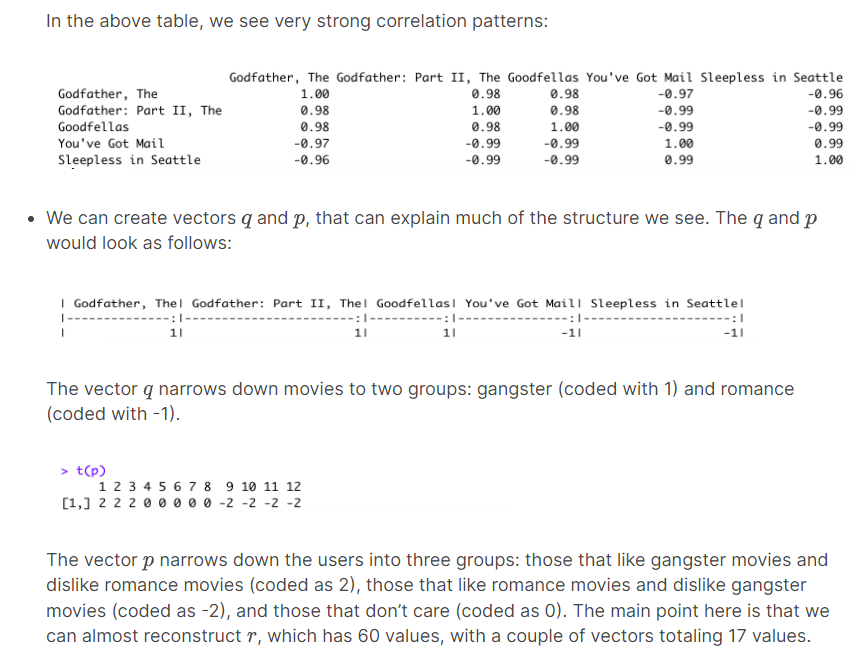

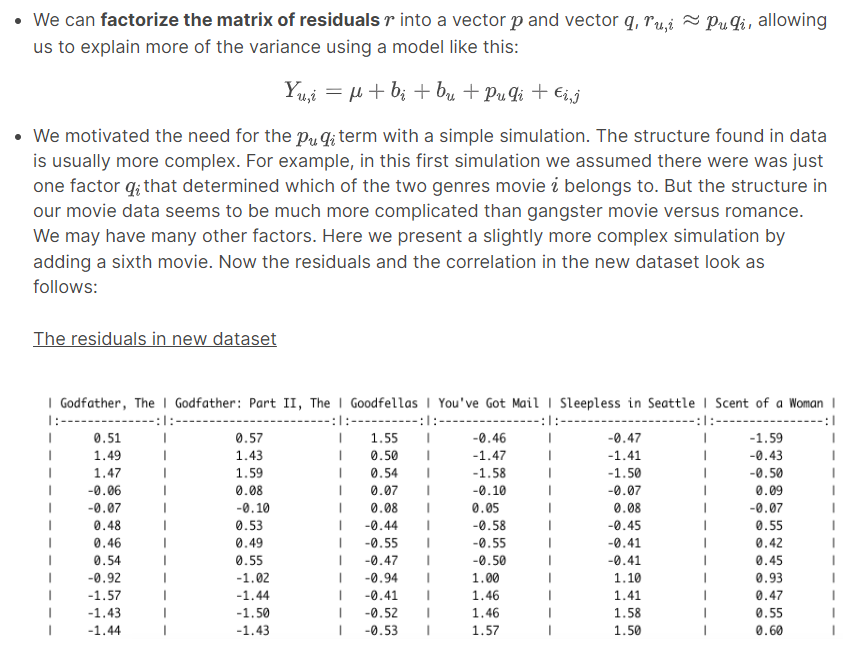

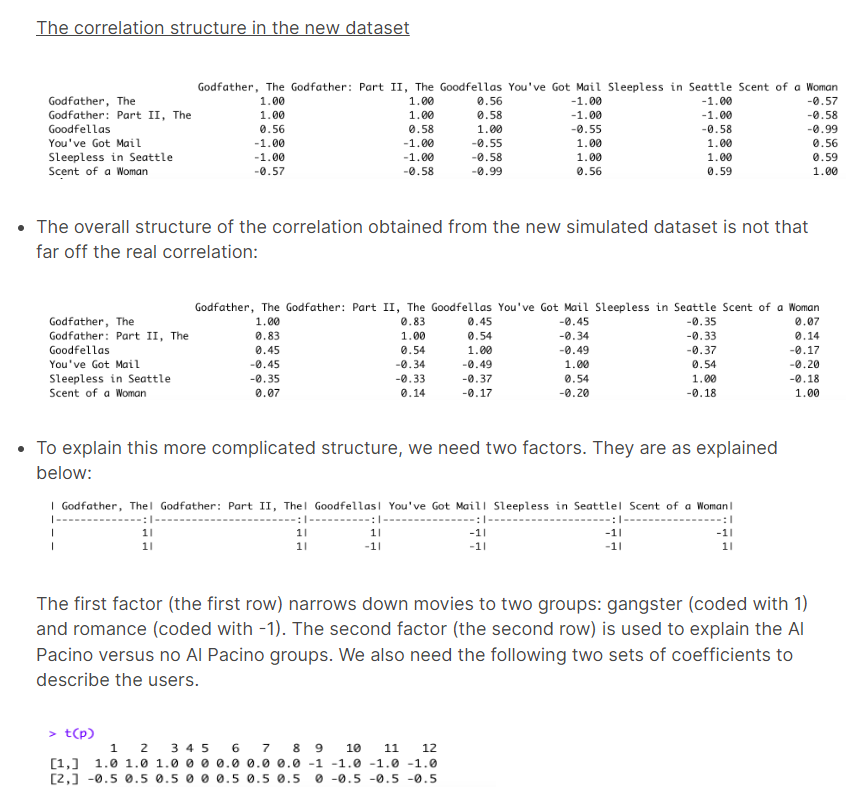

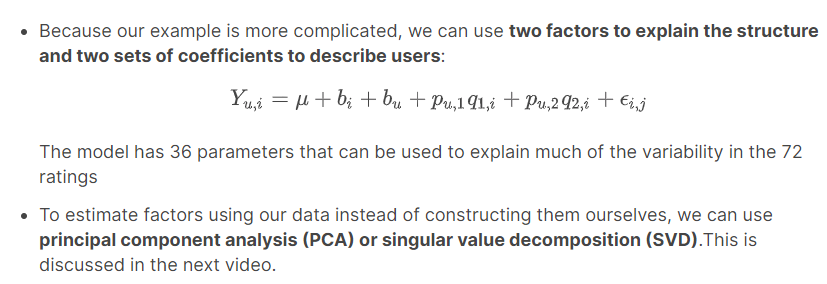

## **Singular Value Decomposition (SVD) and Principal Component Analysis (PCA)**

The matrix factorization decomposition that we showed in the previous video that looks something like this is very much related to SVD and PCA.

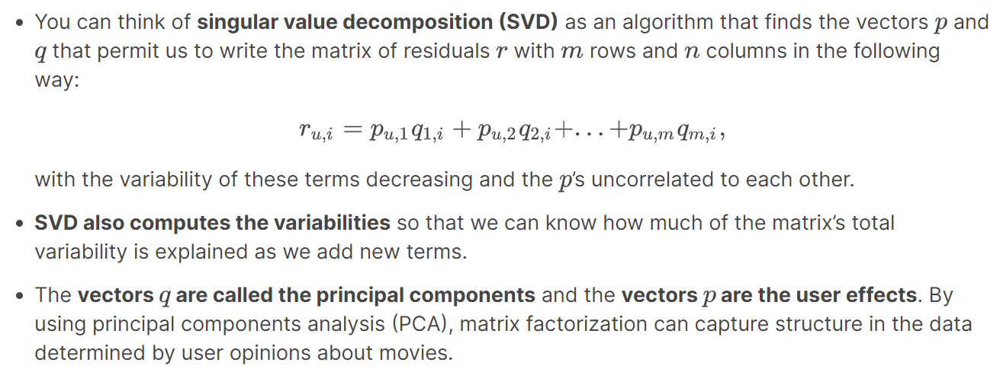

In [ ]:
# To make all the NAs zero

y[is.na(y)] <- 0
y <- sweep(y, 1, rowMeans(y))
pca <- prcomp(y)

# vector q = principal components stored in this matrix
dim(pca$rotation)
# output: 454   292

# p vectors = user effects stored in this matrix
dim(pca$x)
# output: 292   292

plot(pca$sdev)

var_explained <- cumsum(pca$sdev^2/sum(pca$sdev^2))
plot(var_explained)

library(ggrepel)
pcs <- data.frame(pca$rotation, name = colnames(y))
pcs %>%  ggplot(aes(PC1, PC2)) + geom_point() +
     geom_text_repel(aes(PC1, PC2, label=name),
                     data = filter(pcs,
                                   PC1 < -0.1 | PC1 > 0.1 | PC2 < -0.075 | PC2 > 0.1))

pcs %>% select(name, PC1) %>% arrange(PC1) %>% slice(1:10)

pcs %>% select(name, PC1) %>% arrange(desc(PC1)) %>% slice(1:10)

pcs %>% select(name, PC2) %>% arrange(PC2) %>% slice(1:10)

pcs %>% select(name, PC2) %>% arrange(desc(PC2)) %>% slice(1:10)

plot(pca$sdev)

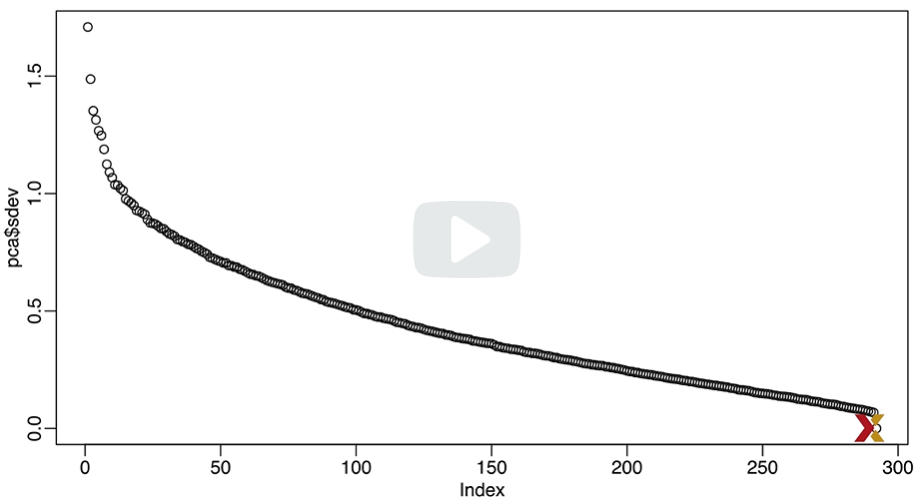

var_explained <- cumsum(pca$sdev^2/sum(pca$sdev^2))
plot(var_explained)

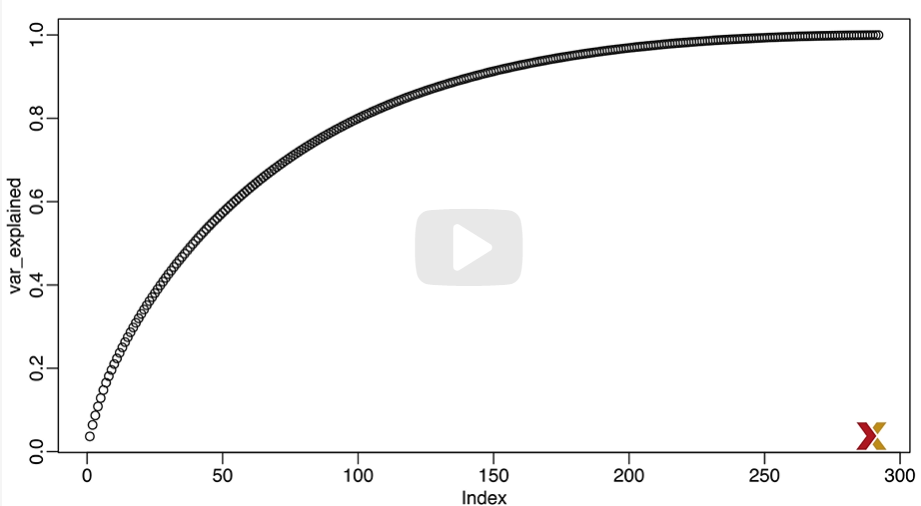

library(ggrepel)
pcs <- data.frame(pca$rotation, name = colnames(y))
pcs %>%  ggplot(aes(PC1, PC2)) + geom_point() +
     geom_text_repel(aes(PC1, PC2, label=name),
                     data = filter(pcs,
                                   PC1 < -0.1 | PC1 > 0.1 | PC2 < -0.075 | PC2 > 0.1))

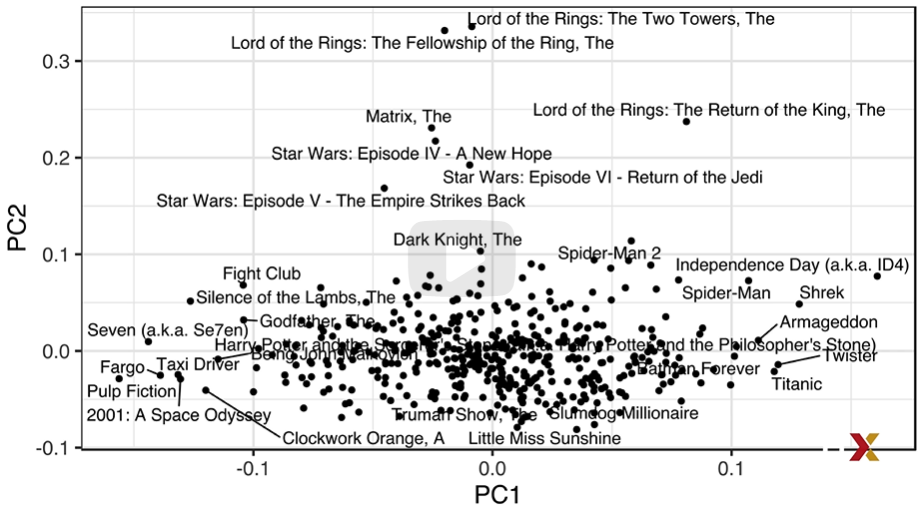

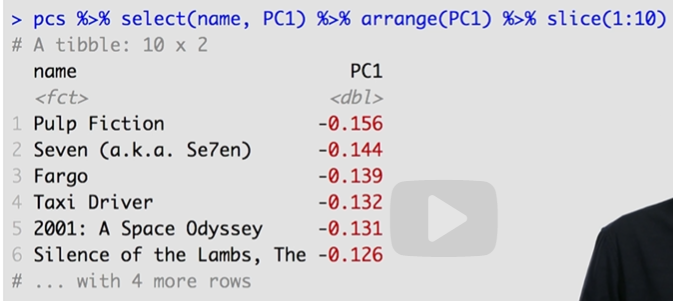

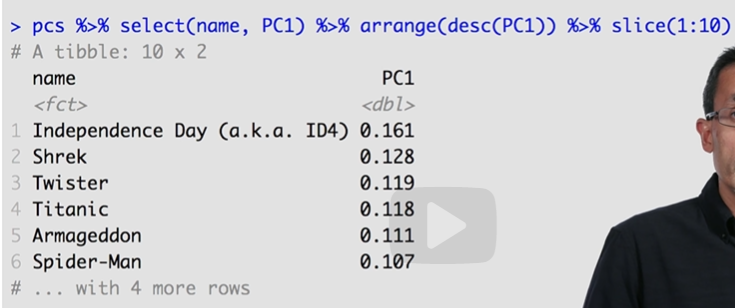

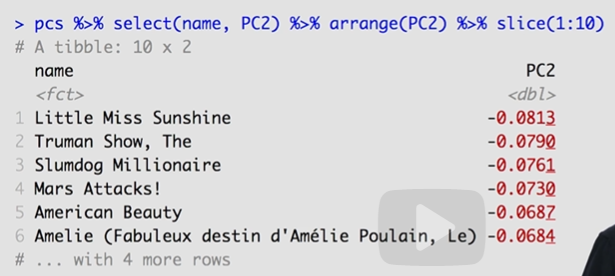


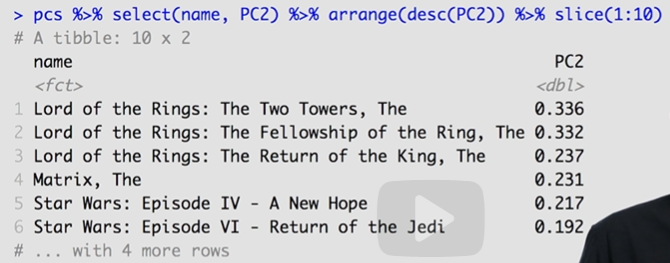

## **Comprehension Check: Matrix Factorization**

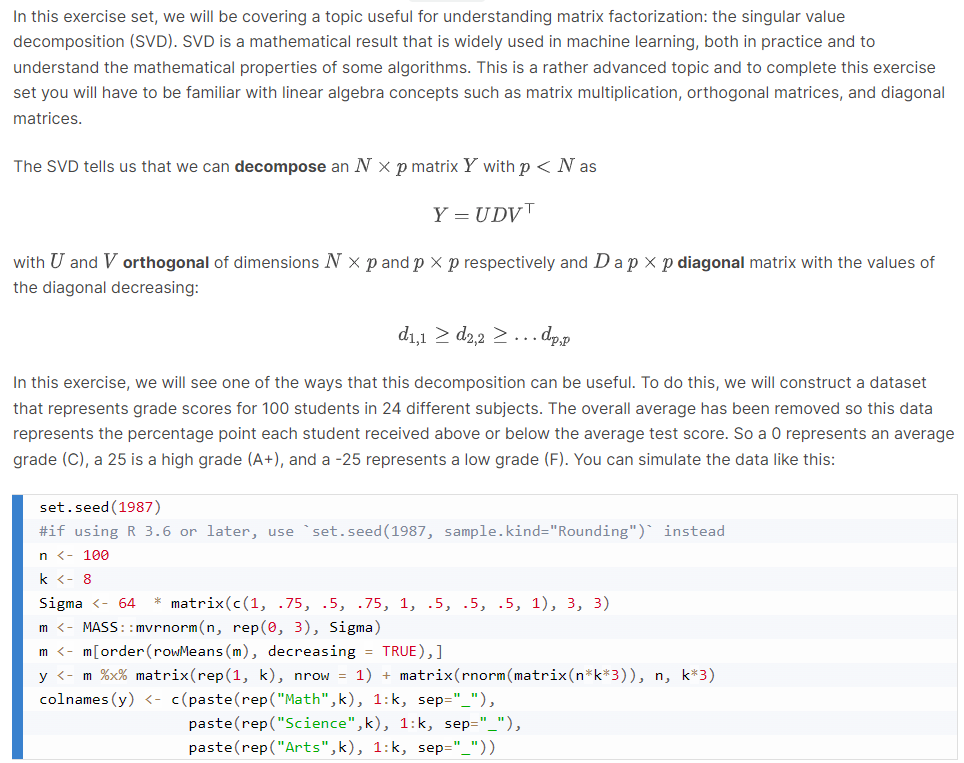

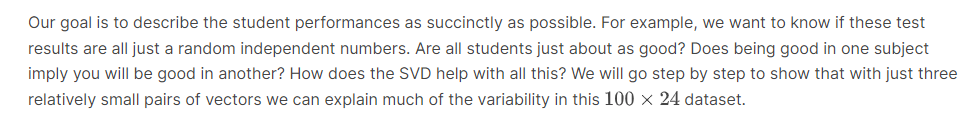

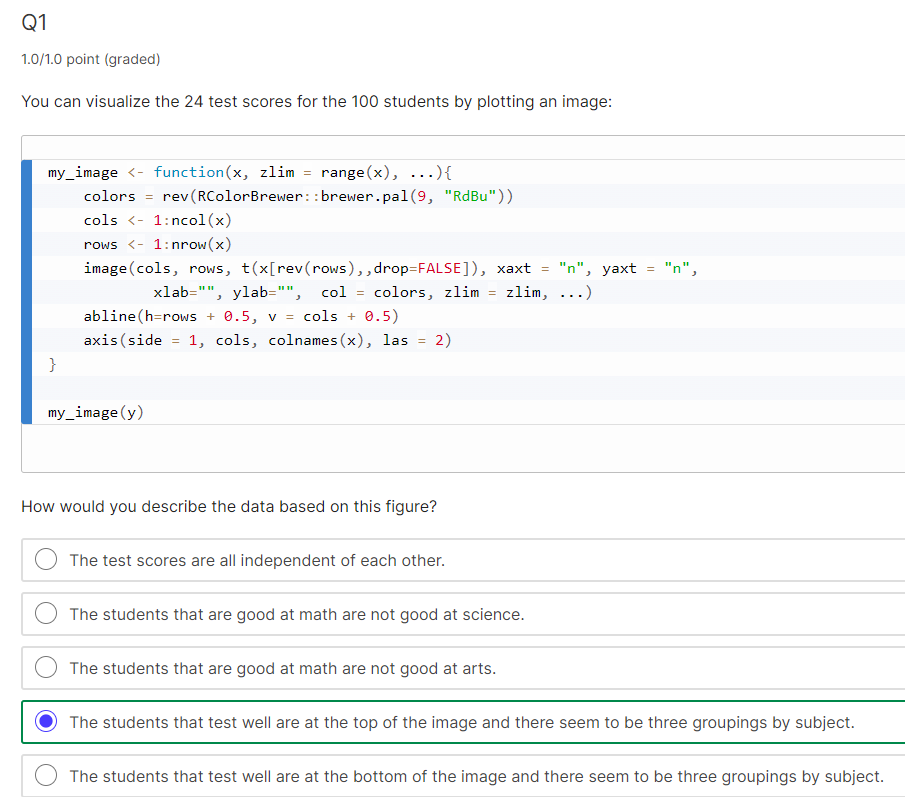

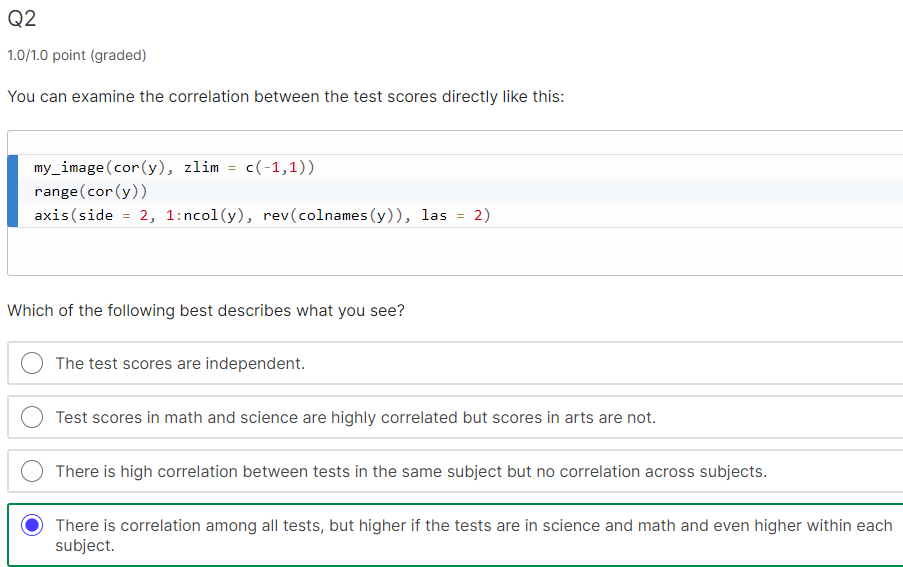

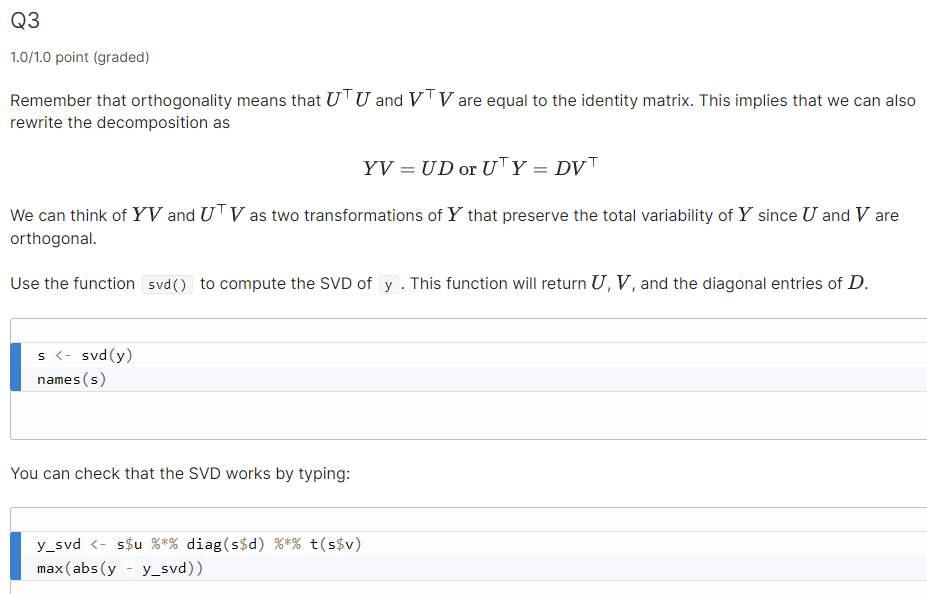

...

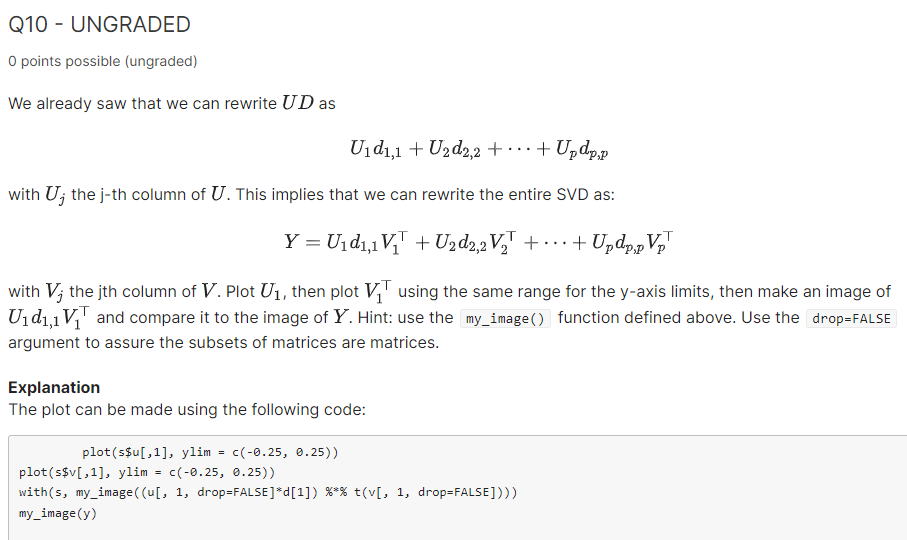

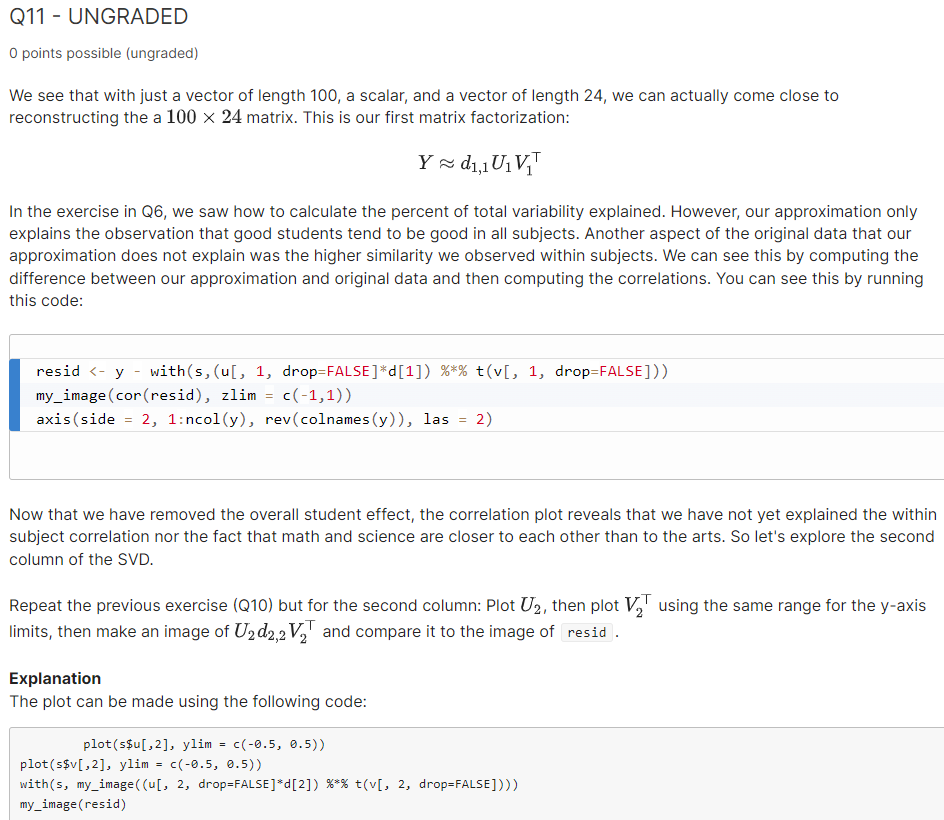

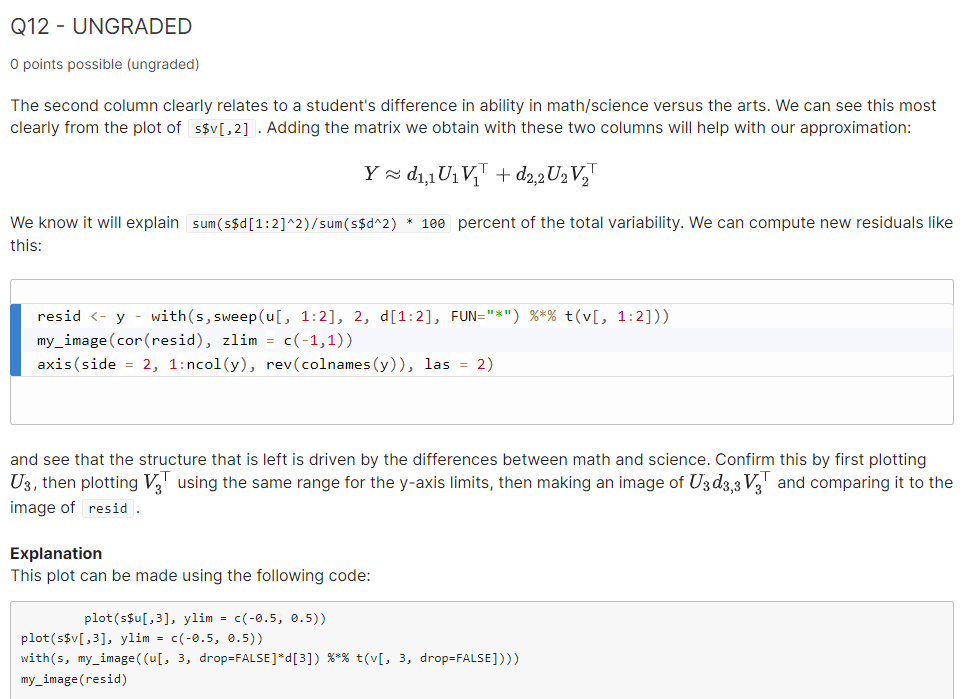

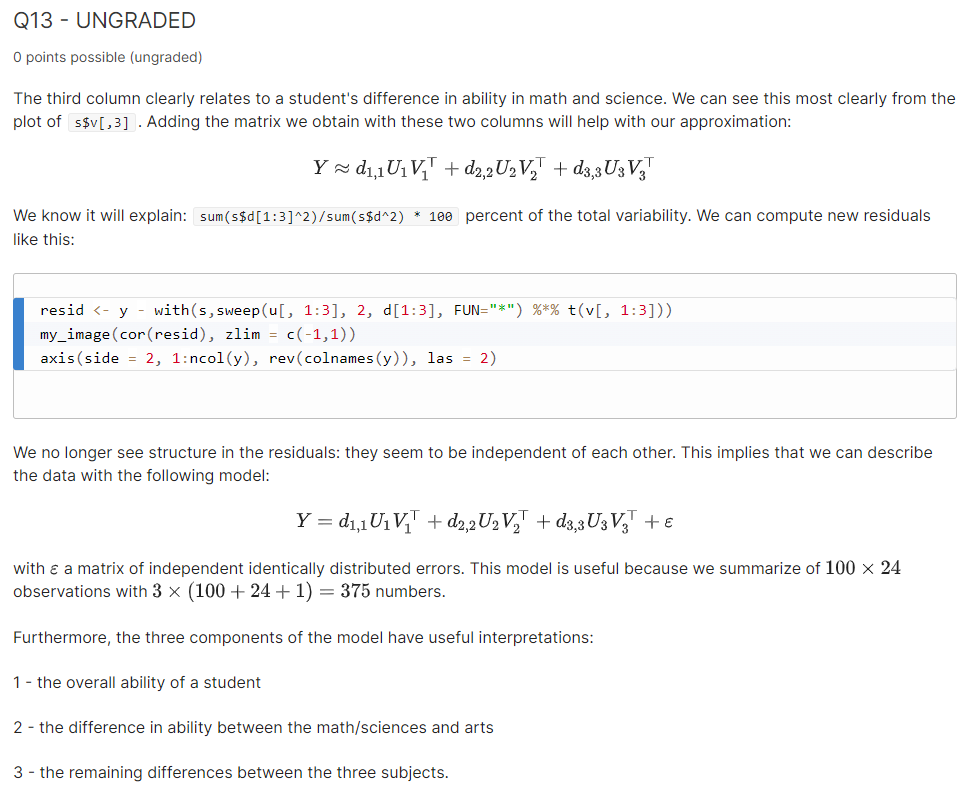


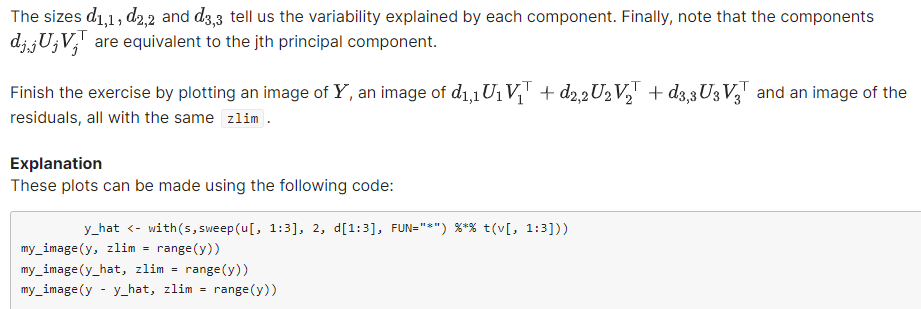